In [ ]:
# IMPORTANT: SOME KAGGLE DATA SOURCES ARE PRIVATE
# RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES.
import kagglehub
kagglehub.login()


In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

mariaherrerot_ddrdataset_path = kagglehub.dataset_download('mariaherrerot/ddrdataset')
mariaherrerot_aptos2019_path = kagglehub.dataset_download('mariaherrerot/aptos2019')
shazaosama_latestmodel_pytorch_default_1_path = kagglehub.model_download('shazaosama/latestmodel/PyTorch/default/1')

print('Data source import complete.')


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import shutil
from sklearn.model_selection import train_test_split
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms,utils
import cv2
from PIL import Image

In [ ]:
import kagglehub

path = kagglehub.dataset_download("mariaherrerot/aptos2019")
print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/aptos2019


In [ ]:
list_dir = os.listdir(path)
print(list_dir)

['val_images', 'train_images', 'valid.csv', 'test.csv', 'train_1.csv', 'test_images']


In [ ]:
train_images=path+'/train_images'*2
train_labels=pd.read_csv(path+'/train_1.csv')
valid_images=path+'/val_images'*2
valid_labels=pd.read_csv(path+'/valid.csv')
test_images=path+'/test_images'*2
test_labels=pd.read_csv(path+'/test.csv')

In [ ]:
combined_data=pd.concat([train_labels,valid_labels,test_labels]).reset_index(drop=True)

In [ ]:
combined_data.head()

,id_code,diagnosis
0,1ae8c165fd53,2
1,1b329a127307,1
2,1b32e1d775ea,4
3,1b3647865779,0
4,1b398c0494d1,0


In [ ]:
combined_data['diagnosis'].value_counts()

,count
diagnosis,
0,1805
2,999
1,370
4,295
3,193


In [ ]:
combined_data.shape

(3662, 2)

<Axes: xlabel='diagnosis', ylabel='count'>

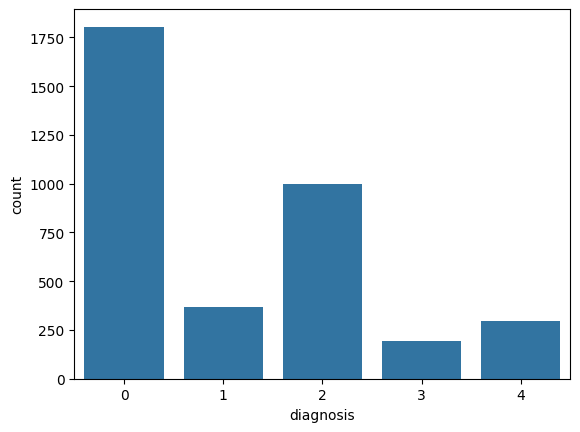

In [ ]:
sns.countplot(combined_data,x='diagnosis')

In [ ]:
image_dirs = [train_images,test_images,valid_images]
target_dir = "combined_images"
os.makedirs(target_dir, exist_ok=True)

for folder in image_dirs:
    for fname in os.listdir(folder):
        src = os.path.join(folder, fname)
        dst = os.path.join(target_dir, fname)
        if not os.path.exists(dst):
            shutil.copy2(src, dst)

In [ ]:
target_size=500

In [ ]:
data_downsampled=[]
for name,group in combined_data.groupby('diagnosis'):
  current_size=len(group)
  if current_size>target_size:
    data_downsampled.append(group.sample(target_size,random_state=42))
  else:
    data_downsampled.append(group)

downsampled_df=pd.concat(data_downsampled).reset_index(drop=True)
downsampled_df.head()

,id_code,diagnosis
0,ef5155990874,0
1,24de56d433cd,0
2,81914ceb4e74,0
3,a1b28bcbce00,0
4,c365c598ad4e,0


In [ ]:
downsampled_df['diagnosis'].value_counts()

,count
diagnosis,
0,500
2,500
1,370
4,295
3,193


In [ ]:
train_APTOS_df,val_test_APTOS_df=train_test_split(downsampled_df,test_size=0.2,random_state=42,stratify=downsampled_df['diagnosis'])
val_APTOS_df,test_APTOS_df=train_test_split(val_test_APTOS_df,test_size=0.5,random_state=42,stratify=val_test_APTOS_df['diagnosis'])

In [ ]:

path = kagglehub.dataset_download("mariaherrerot/ddrdataset")
print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/ddrdataset


In [ ]:
list_dir = os.listdir(path)
images_path=os.path.join(path,list_dir[1],list_dir[1])
labels_path=os.path.join(path,list_dir[0])
print(images_path)
print(labels_path)

/kaggle/input/ddrdataset/DR_grading/DR_grading
/kaggle/input/ddrdataset/DR_grading.csv


In [ ]:
labels_df=pd.read_csv(labels_path)
labels_df.head()

,id_code,diagnosis
0,20170413102628830.jpg,0
1,20170413111955404.jpg,0
2,20170413112015395.jpg,0
3,20170413112017305.jpg,0
4,20170413112528859.jpg,0


<Axes: xlabel='diagnosis', ylabel='count'>

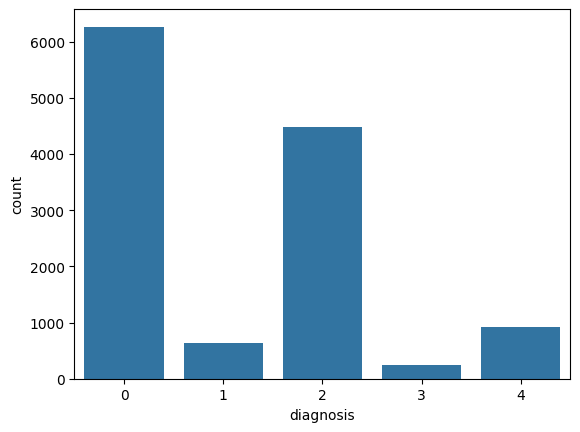

In [ ]:
sns.countplot(x='diagnosis',data=labels_df)

In [ ]:
labels_df['diagnosis'].value_counts()

,count
diagnosis,
0,6266
2,4477
4,913
1,630
3,236


In [ ]:
size=800

In [ ]:
new_data=[]
for name,group in labels_df.groupby('diagnosis'):
  targ_size=size-downsampled_df[downsampled_df['diagnosis']==name].shape[0]
  print(targ_size)
  if targ_size>0 :
    if targ_size>len(group):
      new_data.append(group)
    else:
      new_data.append(group.sample(targ_size,random_state=42))


300
430
300
607
505


In [ ]:
collect_data=pd.concat(new_data).reset_index(drop=True)
collect_data.head()

,id_code,diagnosis
0,20170220085833145.jpg,0
1,20170329074906288.jpg,0
2,007-1981-100.jpg,0
3,007-0795-000.jpg,0
4,20170226223624346.jpg,0


In [ ]:
for image in os.listdir(images_path):
  if image in collect_data['id_code'].values:
    src=os.path.join(images_path,image)
    dst=os.path.join(target_dir,image)
    if not os.path.exists(dst):
      shutil.copy2(src,dst)

<Axes: xlabel='diagnosis', ylabel='count'>

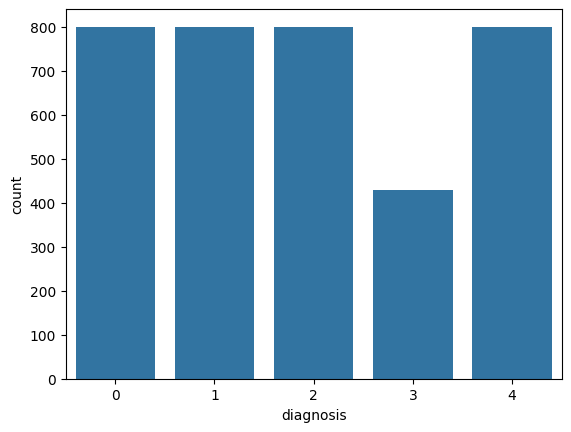

In [ ]:
# prompt: histogram if the classes from the combined data

combined_full_data=pd.concat([downsampled_df,collect_data]).reset_index(drop=True)
combined_full_data['diagnosis'].value_counts()
sns.countplot(combined_full_data,x='diagnosis')

In [ ]:
train_DDR_df,val_test_DDR_df=train_test_split(collect_data,test_size=0.2,random_state=42,stratify=collect_data['diagnosis'])
val_DDR_df,test_DDR_df=train_test_split(val_test_DDR_df,test_size=0.5,random_state=42,stratify=val_test_DDR_df['diagnosis'])

In [ ]:
train_df=pd.concat([train_APTOS_df,train_DDR_df]).reset_index(drop=True)
val_df=pd.concat([val_APTOS_df,val_DDR_df]).reset_index(drop=True)
test_df=pd.concat([test_APTOS_df,test_DDR_df]).reset_index(drop=True)

In [ ]:
train_df['diagnosis'].value_counts()

,count
diagnosis,
1,640
0,640
2,640
4,640
3,342


<Axes: xlabel='diagnosis', ylabel='count'>

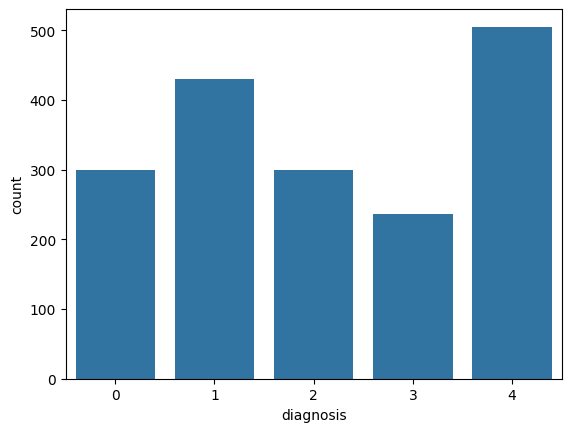

In [ ]:
sns.countplot(x='diagnosis',data=collect_data)

<Axes: xlabel='diagnosis', ylabel='count'>

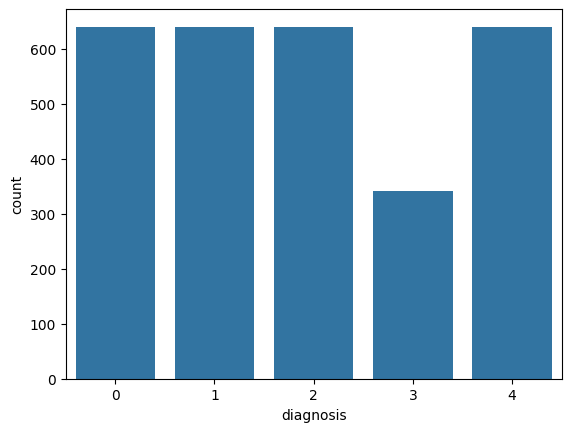

In [ ]:
sns.countplot(x='diagnosis',data=train_df)

In [ ]:
test_df['diagnosis'].value_counts()

,count
diagnosis,
0,80
1,80
2,80
4,80
3,44


In [ ]:
val_df['diagnosis'].value_counts()

,count
diagnosis,
0,80
1,80
2,80
4,80
3,43


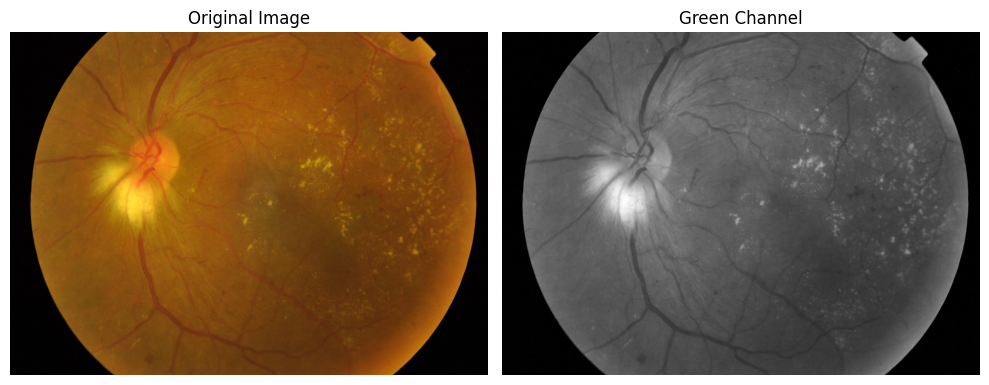

In [ ]:
# prompt: visualize original images before and after extracting
# green channel

# Load an example image
example_image_path = os.path.join(target_dir, train_df.iloc[15]['id_code'] + '.png') # Assuming images are in PNG format
original_image = cv2.imread(example_image_path)
original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB) # Convert BGR to RGB

# Extract the green channel
green_channel = original_image[:,:,1]

# Visualize original and green channel images
fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# Plot the original image
axes[0].imshow(original_image)
axes[0].set_title('Original Image')
axes[0].axis('off')

# Plot the green channel image
axes[1].imshow(green_channel, cmap='gray') # Use grayscale colormap for single channel
axes[1].set_title('Green Channel')
axes[1].axis('off')

plt.tight_layout()
plt.show()

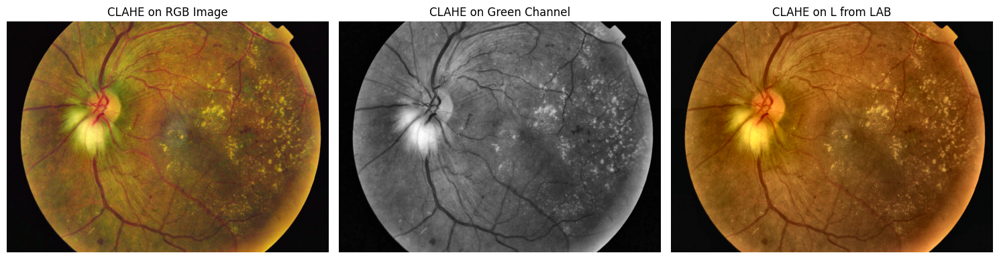

In [ ]:
# prompt: visualize original images and apply CLAHE on RGB and ON green channel and on L from LAB

# Apply CLAHE on the original RGB image
clahe_rgb = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
clahe_applied_rgb = np.zeros_like(original_image)
for i in range(3): # Apply CLAHE to each channel
    clahe_applied_rgb[:,:,i] = clahe_rgb.apply(original_image[:,:,i])


# Apply CLAHE on the green channel
clahe_green = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
clahe_applied_green = clahe_green.apply(green_channel)

# Convert the original image to LAB color space
lab_image = cv2.cvtColor(original_image, cv2.COLOR_RGB2LAB)

# Split the LAB image into L, A, and B channels
l_channel, a_channel, b_channel = cv2.split(lab_image)

# Apply CLAHE on the L channel
clahe_l = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
clahe_applied_l = clahe_l.apply(l_channel)

# Merge the CLAHE-applied L channel with the original A and B channels
clahe_applied_lab = cv2.merge((clahe_applied_l, a_channel, b_channel))

# Convert the CLAHE-applied LAB image back to RGB
clahe_applied_lab_rgb = cv2.cvtColor(clahe_applied_lab, cv2.COLOR_LAB2RGB)


# Visualize the results
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot CLAHE applied on RGB
axes[0].imshow(clahe_applied_rgb)
axes[0].set_title('CLAHE on RGB Image')
axes[0].axis('off')

# Plot CLAHE applied on Green Channel
axes[1].imshow(clahe_applied_green, cmap='gray')
axes[1].set_title('CLAHE on Green Channel')
axes[1].axis('off')

# Plot CLAHE applied on L from LAB
axes[2].imshow(clahe_applied_lab_rgb)
axes[2].set_title('CLAHE on L from LAB')
axes[2].axis('off')


plt.tight_layout()
plt.show()


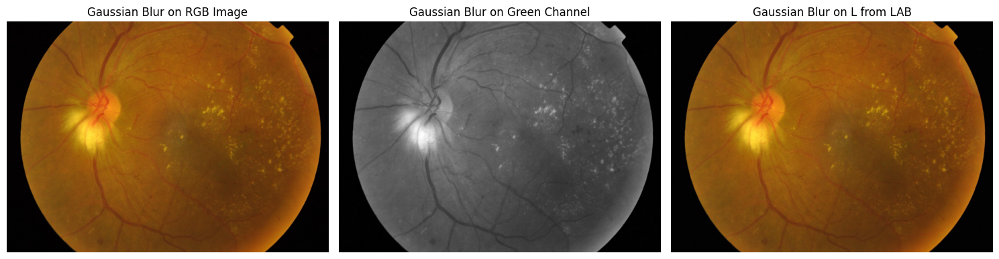

In [ ]:
# prompt: prompt: visualize original images and apply CLAHE + gaussian blur
#  on RGB and ON green channel and on L from LAB

# Apply Gaussian Blur on the original RGB image
gaussian_blurred_rgb = cv2.GaussianBlur(original_image, (5, 5), 0) # Kernel size (5,5), sigmaX=0

# Apply Gaussian Blur on the green channel
gaussian_blurred_green = cv2.GaussianBlur(green_channel, (5, 5), 0)

# Apply Gaussian Blur on the L channel from LAB (need to convert back to uint8 if needed, though GaussianBlur handles different types)
# Since l_channel is from a cv2.split, it should be of the correct type.
gaussian_blurred_l = cv2.GaussianBlur(l_channel, (5, 5), 0)

# Merge the Gaussian Blurred L channel with the original A and B channels to visualize in color
gaussian_blurred_lab = cv2.merge((gaussian_blurred_l, a_channel, b_channel))
gaussian_blurred_lab_rgb = cv2.cvtColor(gaussian_blurred_lab, cv2.COLOR_LAB2RGB)


# Visualize the results of Gaussian Blur
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot Gaussian Blur applied on RGB
axes[0].imshow(gaussian_blurred_rgb)
axes[0].set_title('Gaussian Blur on RGB Image')
axes[0].axis('off')

# Plot Gaussian Blur applied on Green Channel
axes[1].imshow(gaussian_blurred_green, cmap='gray')
axes[1].set_title('Gaussian Blur on Green Channel')
axes[1].axis('off')

# Plot Gaussian Blur applied on L from LAB
axes[2].imshow(gaussian_blurred_lab_rgb)
axes[2].set_title('Gaussian Blur on L from LAB')
axes[2].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
class DRDatasetFromDF(Dataset):
    def __init__(self, dataframe, images_dir, transform=None):
        self.data = dataframe.reset_index(drop=True)
        self.images_dir = images_dir
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        row = self.data.iloc[idx]
        image_id = row['id_code']
        label = row['diagnosis']

        #  First, try the image_id as is (in case it already has extension)
        image_path = os.path.join(self.images_dir, image_id)
        found = os.path.exists(image_path)

        # If not found, try adding extensions
        if not found:
            for ext in ['.png', '.jpg', '.jpeg']:
                image_path = os.path.join(self.images_dir, f"{image_id}{ext}")
                if os.path.exists(image_path):
                    found = True
                    break

        if not found:
            # List available files for debugging
            available_files = os.listdir(self.images_dir)[:10]  # Show first 10 files
            raise FileNotFoundError(f"Image not found: {image_id}\nChecked path: {self.images_dir}\nFirst 10 files in directory: {available_files}")

        # Load image
        img = cv2.imread(image_path)
        if img is None:
            raise ValueError(f"Could not read image: {image_path}")

        # Green channel
        green = img[:, :, 1]

        # CLAHE
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        green_clahe = clahe.apply(green)

        # Gaussian Blur
       # blurred = cv2.GaussianBlur(green_clahe, (5, 5), 0)

        # Convert to PIL
        img_pil = Image.fromarray(green_clahe)

        # Apply transform
        if self.transform:
            img_tensor = self.transform(img_pil)
        else:
            img_tensor = transforms.ToTensor()(img_pil)

        return img_tensor, label


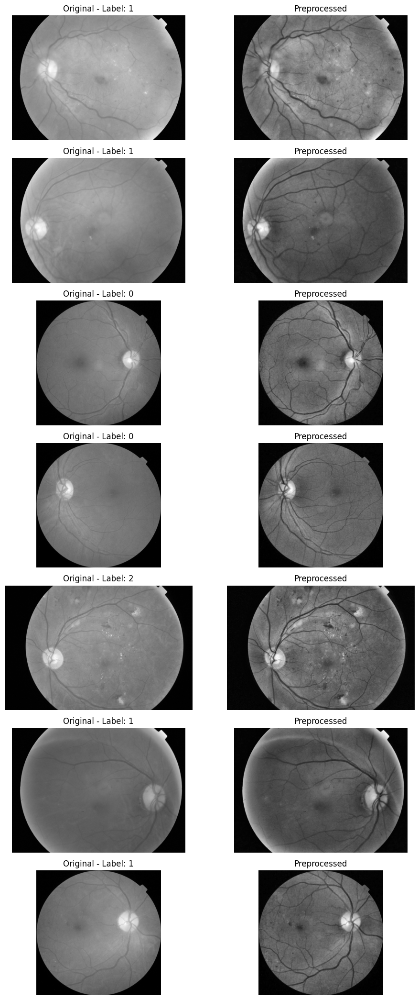

In [ ]:
import matplotlib.pyplot as plt
import os
import cv2
from PIL import Image
import torch
from torchvision import transforms


num_samples = 20


train_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5])
])

def preprocess_image(image_path):
    img = cv2.imread(image_path)
    green = img[:, :, 1]
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    green_clahe = clahe.apply(green)
    blurred = cv2.GaussianBlur(green_clahe, (5, 5), 0)
    return Image.fromarray(blurred)


plt.figure(figsize=(10, num_samples * 3))

for i in range(num_samples):
    row = train_df.iloc[i]
    image_id = row['id_code']


    for ext in ['.png', '.jpg', '.jpeg']:
        image_path = os.path.join("combined_images", image_id + ext)
        if os.path.exists(image_path):
            break


    original_img = Image.open(image_path).convert("L")  # to grayscale


    processed_img = preprocess_image(image_path)


    plt.subplot(num_samples, 2, i*2 + 1)
    plt.imshow(original_img, cmap='gray')
    plt.title(f"Original - Label: {row['diagnosis']}")
    plt.axis('off')


    plt.subplot(num_samples, 2, i*2 + 2)
    plt.imshow(processed_img, cmap='gray')
    plt.title("Preprocessed")
    plt.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
train_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.RandomResizedCrop(224, scale=(0.8, 1.0)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomRotation(degrees=10),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.1),
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5]),
    #transforms.RandomErasing(p=0.3)
])

In [ ]:
train_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.RandomResizedCrop(224, scale=(0.85, 1.0)),  # Less aggressive cropping
    # Remove RandomHorizontalFlip for medical images
    transforms.RandomRotation(degrees=15),  # Increase rotation range
    transforms.ColorJitter(brightness=0.15, contrast=0.15, saturation=0.05),  # Reduce color changes
    transforms.RandomAffine(degrees=0, translate=(0.05, 0.05)),  # Add slight translation
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5]),
    transforms.RandomErasing(p=0.2, scale=(0.02, 0.1))  # Enable with conservative settings
])

In [ ]:
val_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5])
])

In [ ]:
import numpy as np

class_counts = train_df['diagnosis'].value_counts().sort_index().values
print("Class counts:", class_counts)

# total samples = len(train_df)
num_samples = len(train_df)

Class counts: [640 640 640 342 640]


In [ ]:
class_weights = 1. / class_counts
print("Class weights:", class_weights)

sample_weights = train_df['diagnosis'].apply(lambda x: class_weights[x]).values

Class weights: [0.0015625  0.0015625  0.0015625  0.00292398 0.0015625 ]


In [ ]:
from torch.utils.data import WeightedRandomSampler

sampler = WeightedRandomSampler(
    weights=sample_weights,
    num_samples=len(sample_weights),
    replacement=True
)

In [ ]:
train_dataset = DRDatasetFromDF(train_df, images_dir="combined_images", transform=train_transform)
val_dataset   = DRDatasetFromDF(val_df, images_dir="combined_images", transform=val_transform)
test_dataset  = DRDatasetFromDF(test_df, images_dir="combined_images", transform=val_transform)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader   = DataLoader(val_dataset, batch_size=32, shuffle=False)
test_loader  = DataLoader(test_dataset, batch_size=32, shuffle=False)

In [ ]:
train_dataset = DRDatasetFromDF(train_df, images_dir="combined_images", transform=train_transform)
val_dataset   = DRDatasetFromDF(val_df, images_dir="combined_images", transform=val_transform)
test_dataset  = DRDatasetFromDF(test_df, images_dir="combined_images", transform=val_transform)
train_loader = DataLoader(train_dataset, batch_size=32, sampler=sampler)
val_loader   = DataLoader(val_dataset, batch_size=32, shuffle=False)
test_loader  = DataLoader(test_dataset, batch_size=32, shuffle=False)

In [ ]:
!pip install efficientnet_pytorch


In [ ]:
import torch
import torch.nn as nn
from efficientnet_pytorch import EfficientNet
from torch.optim import Adam
from tqdm import tqdm
import copy

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load EfficientNet
model = EfficientNet.from_pretrained('efficientnet-b0', in_channels=1, num_classes=5)
model._dropout = nn.Dropout(0.5)
original_fc = model._fc
model._fc = nn.Sequential(
    nn.Dropout(0.5),
    original_fc,
    nn.Dropout(0.3)
)
model.to(device)


Loaded pretrained weights for efficientnet-b0


EfficientNet(
  (_conv_stem): Conv2dStaticSamePadding(
    1, 32, kernel_size=(3, 3), stride=(2, 2), bias=False
    (static_padding): ZeroPad2d((0, 1, 0, 1))
  )
  (_bn0): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
  (_blocks): ModuleList(
    (0): MBConvBlock(
      (_depthwise_conv): Conv2dStaticSamePadding(
        32, 32, kernel_size=(3, 3), stride=[1, 1], groups=32, bias=False
        (static_padding): ZeroPad2d((1, 1, 1, 1))
      )
      (_bn1): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_se_reduce): Conv2dStaticSamePadding(
        32, 8, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_se_expand): Conv2dStaticSamePadding(
        8, 32, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_project_conv): Conv2dStaticSamePadding(
        32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False
    

In [ ]:
import torch
import torch.nn as nn
from torchvision import models

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


resnet = models.resnet50(pretrained=True)

resnet.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)


num_classes = 5


resnet.fc = nn.Sequential(
    nn.Dropout(0.5),
    nn.Linear(resnet.fc.in_features, num_classes)
)

resnet = resnet.to(device)


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 143MB/s]


In [ ]:
from torch.optim import Adam
class_weights = torch.tensor([0.7, 1.0, 1.0, 1.8, 1.0], dtype=torch.float).to(device)
criterion = nn.CrossEntropyLoss(weight=class_weights)

optimizer = Adam(resnet.parameters(), lr=1e-3, weight_decay=1e-4)
from torch.optim.lr_scheduler import ReduceLROnPlateau

scheduler = ReduceLROnPlateau(optimizer, mode='max', factor=0.1, patience=3, verbose=True)

/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


In [ ]:
import copy
import torch.nn.functional as F

# تحضير Early Stopping
best_val_loss = float('inf')  # أو best_val_acc = 0.0
best_model_wts = copy.deepcopy(resnet.state_dict())
patience = 5
patience_counter = 0
num_epochs = 25

for epoch in range(num_epochs):
    print(f"\n📘 Epoch {epoch+1}/{num_epochs}")

    # === Training ===
    resnet.train()
    train_loss = 0.0
    correct = 0
    total = 0

    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = resnet(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        train_loss += loss.item() * inputs.size(0)
        _, preds = outputs.max(1)
        correct += (preds == labels).sum().item()
        total += labels.size(0)

    train_acc = correct / total
    avg_train_loss = train_loss / total

    # === Validation ===
    resnet.eval()
    val_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = resnet(inputs)
            loss = criterion(outputs, labels)
            val_loss += loss.item() * inputs.size(0)
            _, preds = outputs.max(1)
            correct += (preds == labels).sum().item()
            total += labels.size(0)

    avg_val_loss = val_loss / total
    val_acc = correct / total
    scheduler.step(val_acc)


    print(f"Train Loss: {avg_train_loss:.4f} | Train Acc: {train_acc:.4f}")
    print(f"Val   Loss: {avg_val_loss:.4f} | Val   Acc: {val_acc:.4f}")

    # === Early Stopping ===
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        best_model_wts = copy.deepcopy(resnet.state_dict())
        patience_counter = 0
        torch.save(resnet.state_dict(), "best_resnet_model.pth")
        print("✅ Saved best model.")
    else:
        patience_counter += 1
        print(f"⏳ Patience counter: {patience_counter}/{patience}")
        if patience_counter >= patience:
            print("⛔ Early stopping triggered!")
            break

resnet.load_state_dict(best_model_wts)



📘 Epoch 1/25
Train Loss: 1.5506 | Train Acc: 0.3105
Val   Loss: 1.6000 | Val   Acc: 0.3140
✅ Saved best model.

📘 Epoch 2/25
Train Loss: 1.3343 | Train Acc: 0.4070
Val   Loss: 1.5237 | Val   Acc: 0.3471
✅ Saved best model.

📘 Epoch 3/25
Train Loss: 1.2206 | Train Acc: 0.4673
Val   Loss: 1.3974 | Val   Acc: 0.4408
✅ Saved best model.

📘 Epoch 4/25
Train Loss: 1.2149 | Train Acc: 0.4804
Val   Loss: 1.2311 | Val   Acc: 0.4353
✅ Saved best model.

📘 Epoch 5/25
Train Loss: 1.1481 | Train Acc: 0.5117
Val   Loss: 1.1898 | Val   Acc: 0.5317
✅ Saved best model.

📘 Epoch 6/25
Train Loss: 1.1302 | Train Acc: 0.5134
Val   Loss: 1.3070 | Val   Acc: 0.4573
⏳ Patience counter: 1/5

📘 Epoch 7/25
Train Loss: 1.1114 | Train Acc: 0.5238
Val   Loss: 1.0508 | Val   Acc: 0.5565
✅ Saved best model.

📘 Epoch 8/25
Train Loss: 1.0783 | Train Acc: 0.5438
Val   Loss: 1.1597 | Val   Acc: 0.5041
⏳ Patience counter: 1/5

📘 Epoch 9/25
Train Loss: 1.0741 | Train Acc: 0.5503
Val   Loss: 1.1642 | Val   Acc: 0.5537
⏳ Pa

<All keys matched successfully>

In [ ]:
import torch.nn as nn
import torch

# Define class weights (ordered by class index 0 → 4)
class_weights = torch.tensor([0.5, 1.3, 1.8, 2.0, 1.2], dtype=torch.float).to(device)

# Pass weights to CrossEntropyLoss
criterion = nn.CrossEntropyLoss(weight=class_weights)
#criterion = nn.CrossEntropyLoss()
# Optimizer with scheduler
#optimizer = Adam(model.parameters(), lr=5e-5, weight_decay=1e-4)
optimizer = Adam(model.parameters(), lr=1e-4, weight_decay=1e-4)

# Learning rate scheduler - reduces LR by factor of 0.1 when validation loss plateaus
from torch.optim.lr_scheduler import ReduceLROnPlateau
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5, min_lr=1e-6)


In [ ]:
for param in model.parameters():
    param.requires_grad = True

In [ ]:
for param_group in optimizer.param_groups:
    param_group['lr'] = 1e-4


In [ ]:
import os
import torch
import torch.nn as nn
from torch.optim import Adam
import copy
from tqdm import tqdm


# Checkpoint settings
checkpoint_path = 'checkpoint.pth'
best_model_path = 'best_model.pth'
start_epoch = 0
best_val_acc = 0.0
best_val_loss = float('inf')

# Load checkpoint if exists
if os.path.exists(checkpoint_path):
    checkpoint = torch.load(checkpoint_path)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    scheduler.load_state_dict(checkpoint['scheduler_state_dict'])
    start_epoch = checkpoint['epoch'] + 1
    best_val_acc = checkpoint['best_val_acc']
    print(f"✅ Loaded checkpoint from epoch {start_epoch}")

    for param_group in optimizer.param_groups:
        param_group['lr'] = 1e-4

# Training loop
num_epochs = 120
patience = 7
patience_counter = 0

for epoch in range(start_epoch, num_epochs):
    print(f"\n📘 Epoch {epoch+1}/{num_epochs}")

    # === Training ===
    model.train()
    train_loss, train_correct = 0.0, 0

    for images, labels in tqdm(train_loader):
        images, labels = images.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        train_loss += loss.item() * images.size(0)
        train_correct += (outputs.argmax(1) == labels).sum().item()

    train_acc = train_correct / len(train_loader.dataset)
    avg_train_loss = train_loss / len(train_loader.dataset)

    # === Validation ===
    model.eval()
    val_loss, val_correct = 0.0, 0
    with torch.no_grad():
        for images, labels in val_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item() * images.size(0)
            val_correct += (outputs.argmax(1) == labels).sum().item()

    val_acc = val_correct / len(val_loader.dataset)
    avg_val_loss = val_loss / len(val_loader.dataset)

    scheduler.step(avg_val_loss)

    print(f"Train Loss: {avg_train_loss:.4f} | Train Acc: {train_acc:.4f}")
    print(f"Val   Loss: {avg_val_loss:.4f} | Val   Acc: {val_acc:.4f}")
    print(f"Current LR: {optimizer.param_groups[0]['lr']:.2e}")

    # === Early stopping ===
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        patience_counter = 0
    else:
        patience_counter += 1
        if patience_counter >= patience:
            print("⏹️ Early stopping!")
            break

    # === Save best model ===
    if val_acc > best_val_acc:
        best_val_acc = val_acc
        best_model_wts = copy.deepcopy(model.state_dict())
        torch.save(best_model_wts, best_model_path)
        print("✅ Saved best model.")

    # === Save checkpoint ===
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'scheduler_state_dict': scheduler.state_dict(),
        'best_val_acc': best_val_acc
    }, checkpoint_path)
    print("💾 Checkpoint saved.")


In [ ]:
model.load_state_dict(torch.load('/content/drive/MyDrive/latest_model.pth'))

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
y_true = []
y_pred = []

model.eval()
with torch.no_grad():
    for images, labels in test_loader:  # أو test_loader
        images = images.to(device)
        labels = labels.to(device)

        outputs = model(images)
        preds = outputs.argmax(dim=1)

        y_true.extend(labels.cpu().numpy())
        y_pred.extend(preds.cpu().numpy())


🔍 Classification Report:
              precision    recall  f1-score   support

           0     0.7949    0.7750    0.7848        80
           1     0.6486    0.6000    0.6234        80
           2     0.4348    0.5000    0.4651        80
           3     0.4750    0.4318    0.4524        44
           4     0.6875    0.6875    0.6875        80

    accuracy                         0.6154       364
   macro avg     0.6082    0.5989    0.6026       364
weighted avg     0.6213    0.6154    0.6175       364



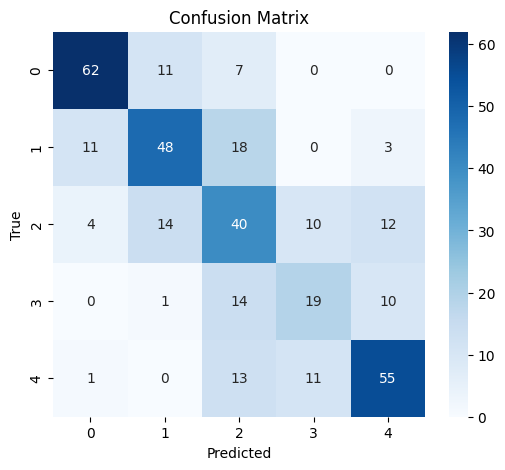

In [ ]:
# Classification Report
print("🔍 Classification Report:")
print(classification_report(y_true, y_pred, digits=4))

# Confusion Matrix
cm = confusion_matrix(y_true, y_pred)
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=range(5), yticklabels=range(5))
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()


# Grad Cam

In [ ]:
import torch
import torch.nn.functional as F
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np
import cv2
from efficientnet_pytorch import EfficientNet
from PIL import Image
import os

🔎 Image 0 - Predicted class: 1


/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1830: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


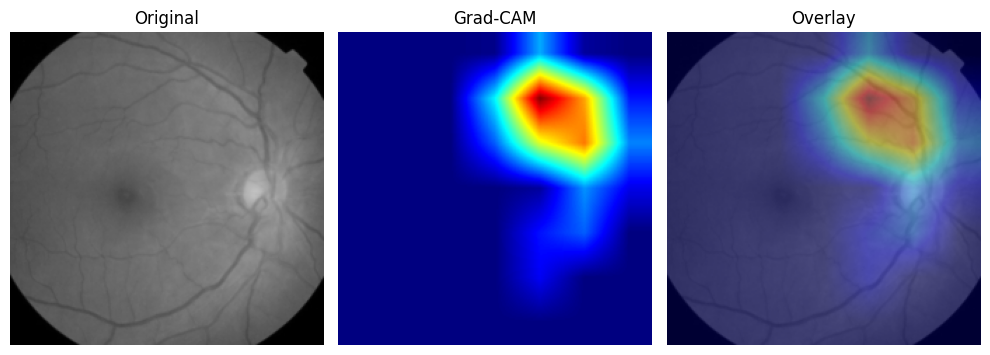

🔎 Image 1 - Predicted class: 2


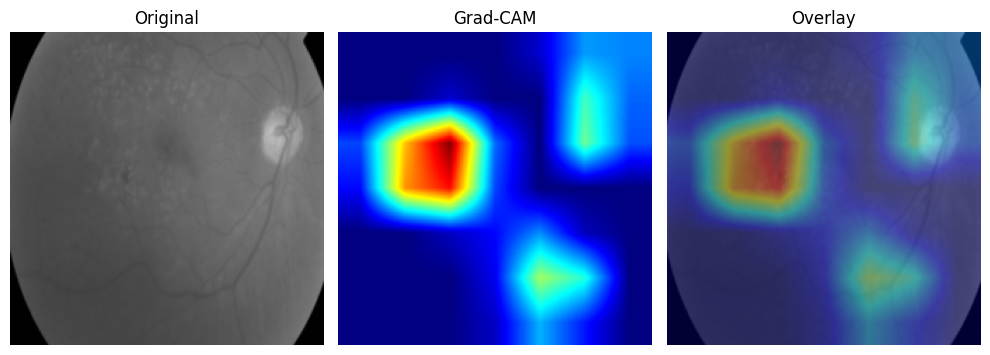

🔎 Image 2 - Predicted class: 2


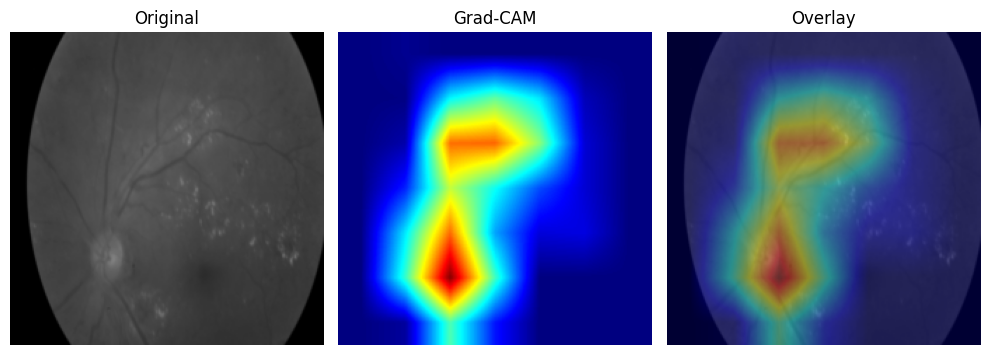

🔎 Image 3 - Predicted class: 1


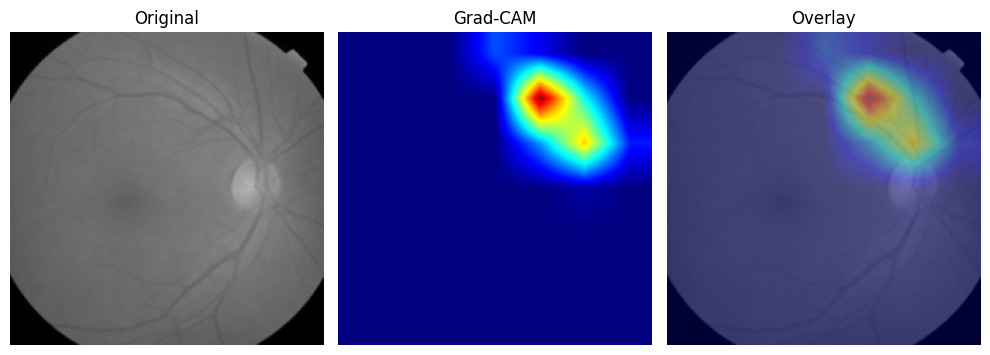

🔎 Image 4 - Predicted class: 2


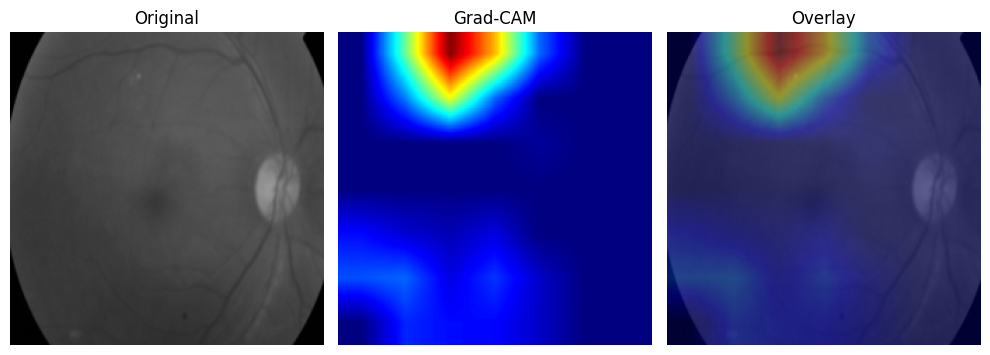

🔎 Image 5 - Predicted class: 4


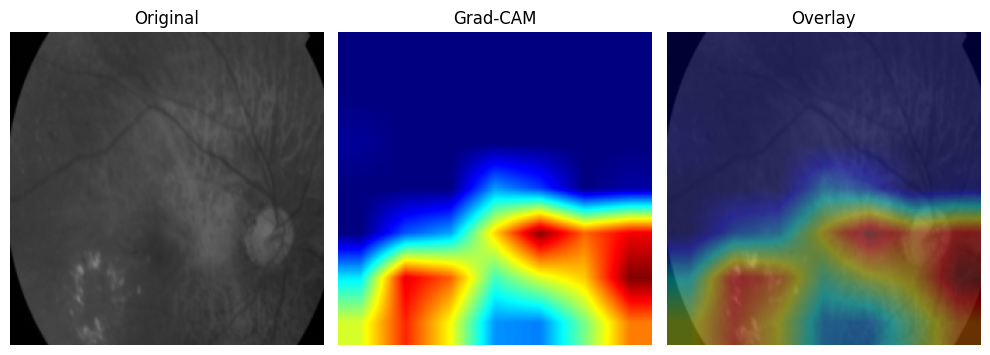

🔎 Image 6 - Predicted class: 2


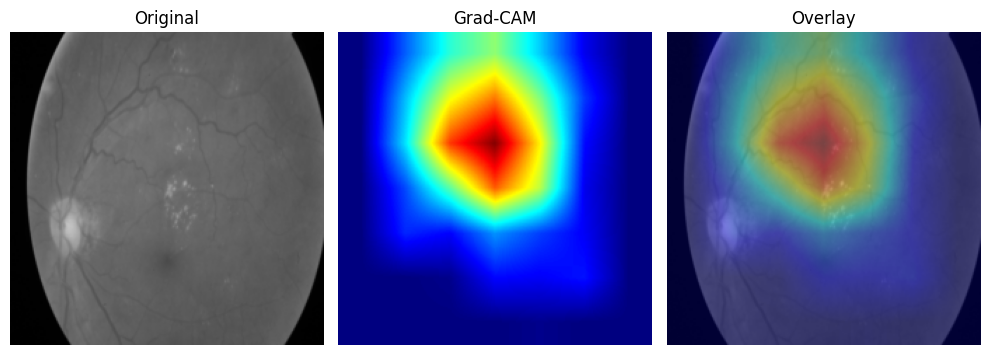

🔎 Image 7 - Predicted class: 2


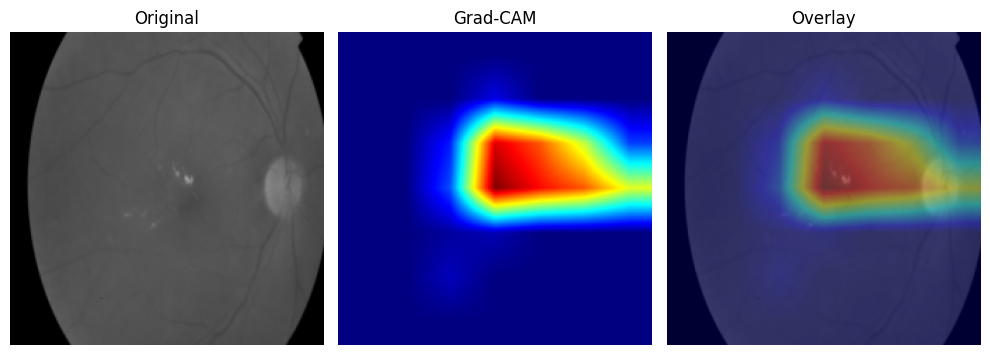

🔎 Image 8 - Predicted class: 1


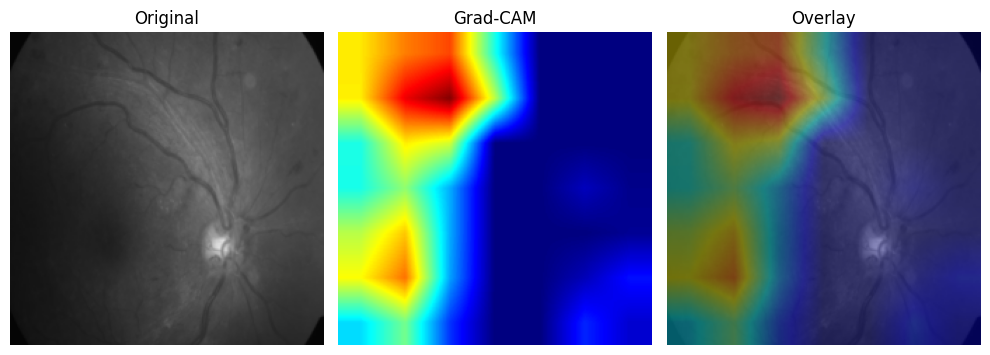

🔎 Image 9 - Predicted class: 2


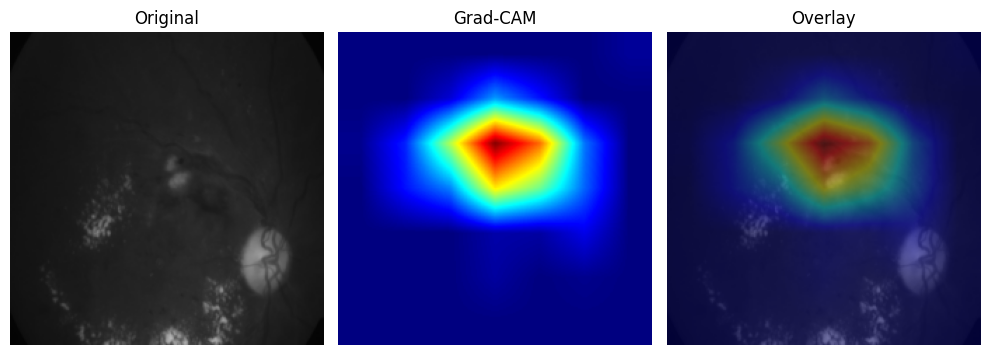

🔎 Image 10 - Predicted class: 2


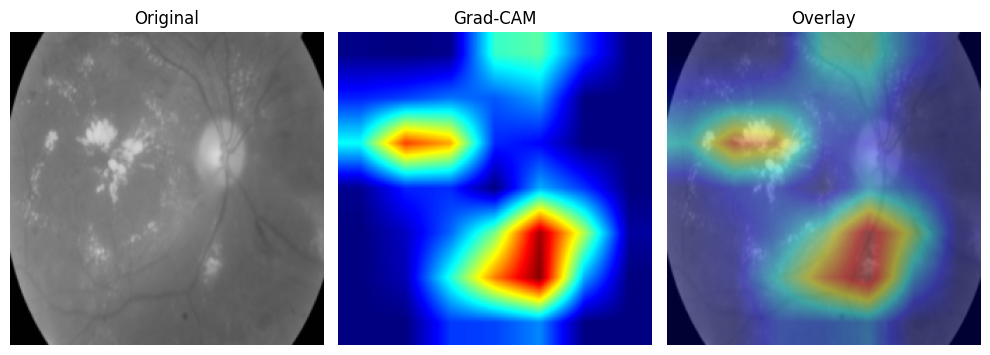

🔎 Image 11 - Predicted class: 4


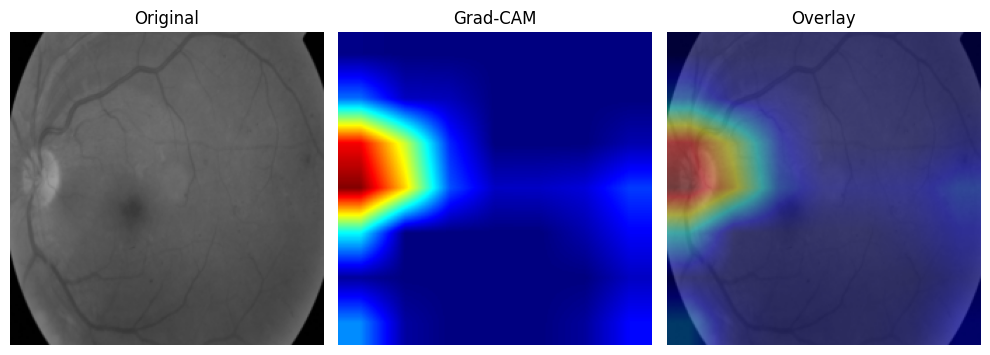

🔎 Image 12 - Predicted class: 4


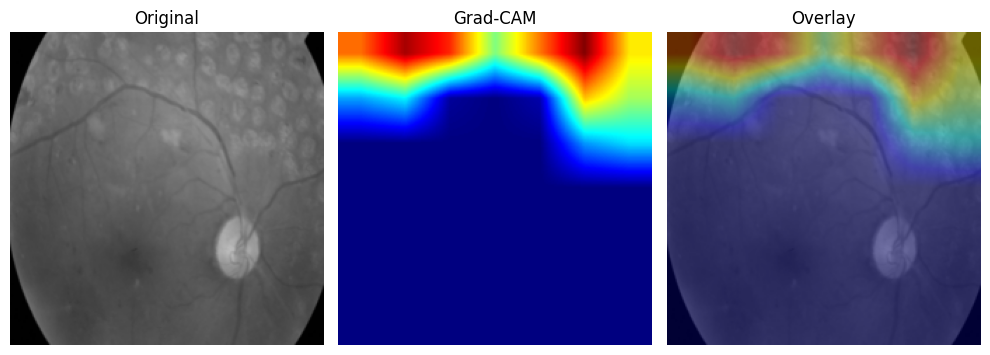

🔎 Image 13 - Predicted class: 4


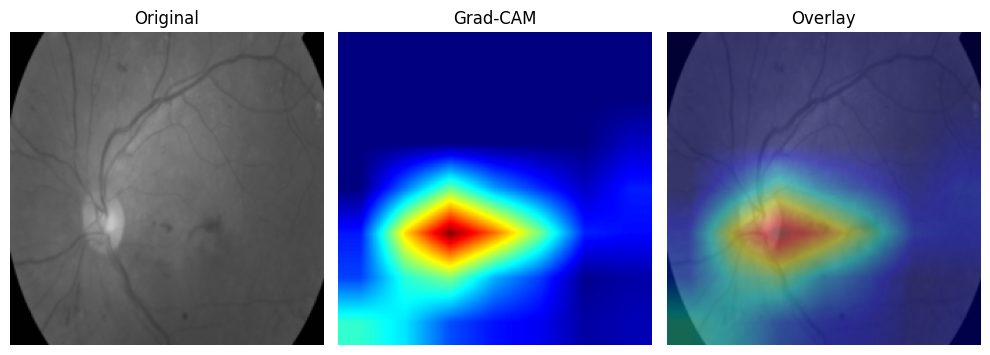

🔎 Image 14 - Predicted class: 2


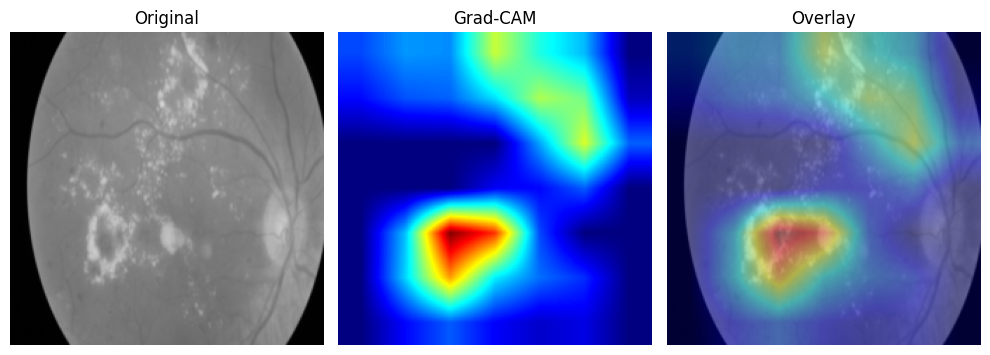

🔎 Image 15 - Predicted class: 2


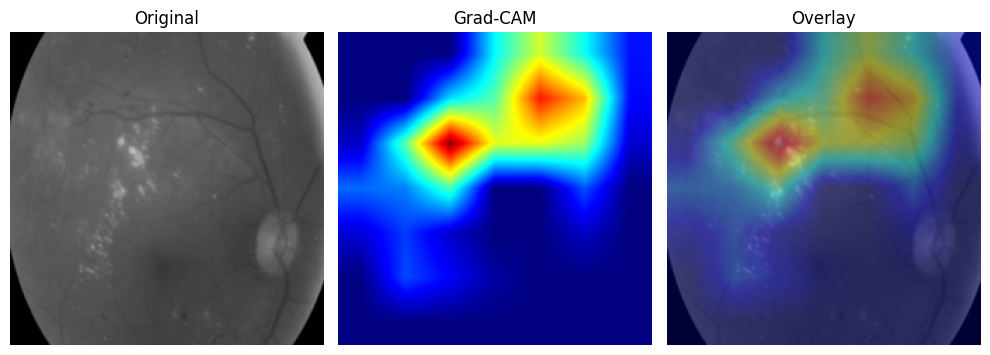

🔎 Image 16 - Predicted class: 2


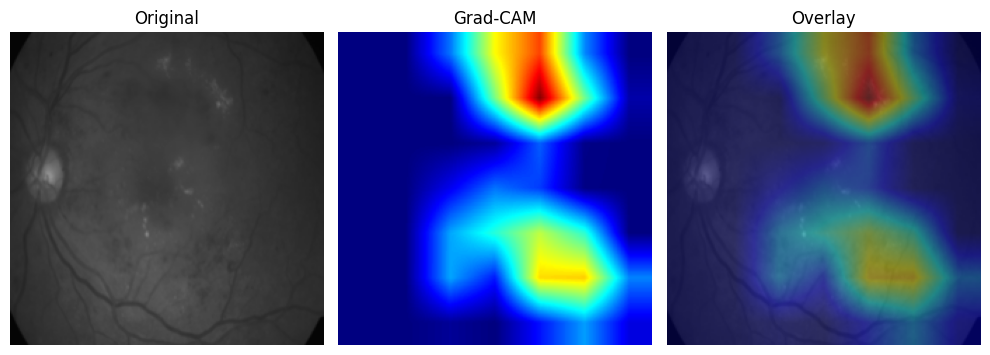

🔎 Image 17 - Predicted class: 1


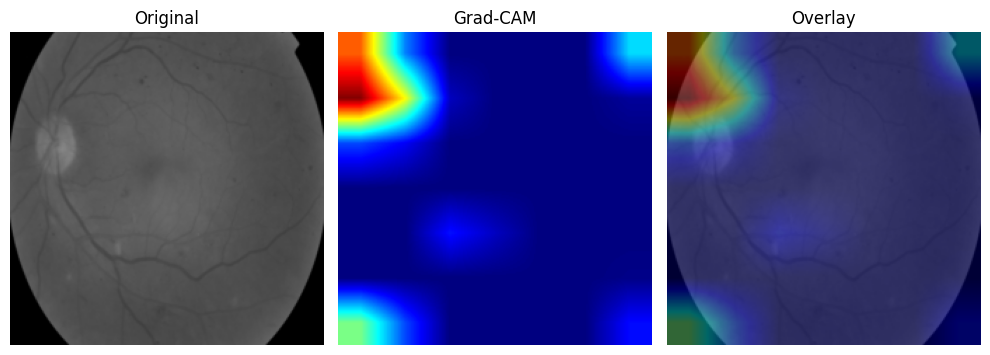

🔎 Image 18 - Predicted class: 2


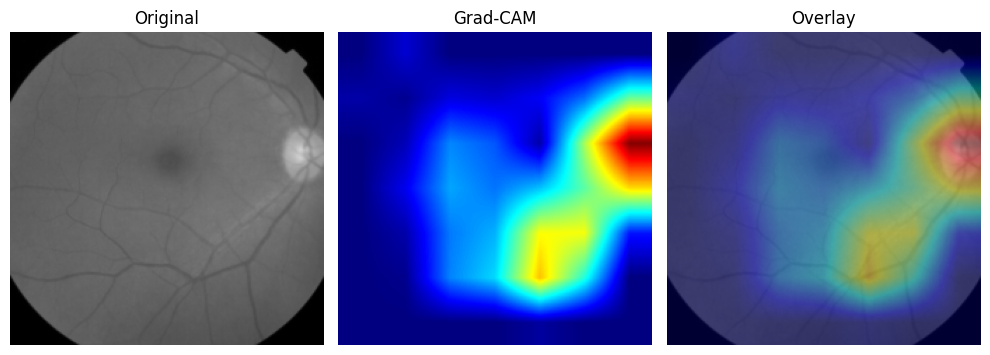

🔎 Image 19 - Predicted class: 0


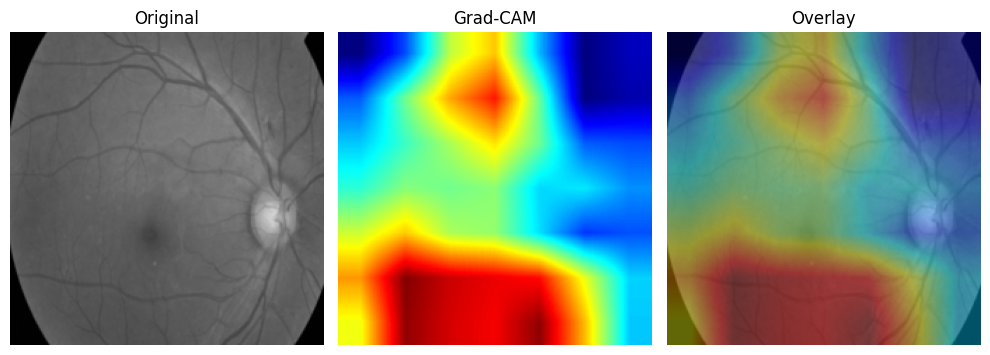

🔎 Image 20 - Predicted class: 1


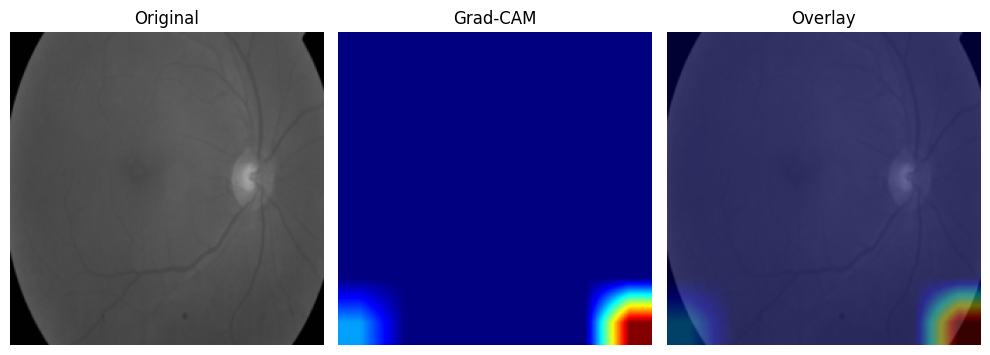

🔎 Image 21 - Predicted class: 0


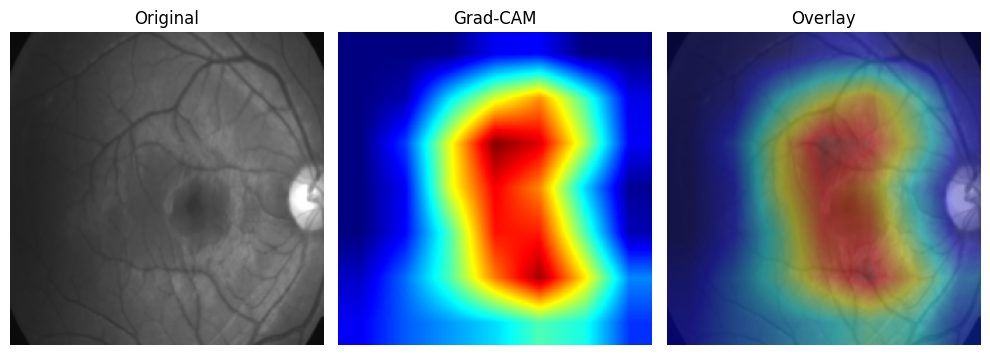

🔎 Image 22 - Predicted class: 1


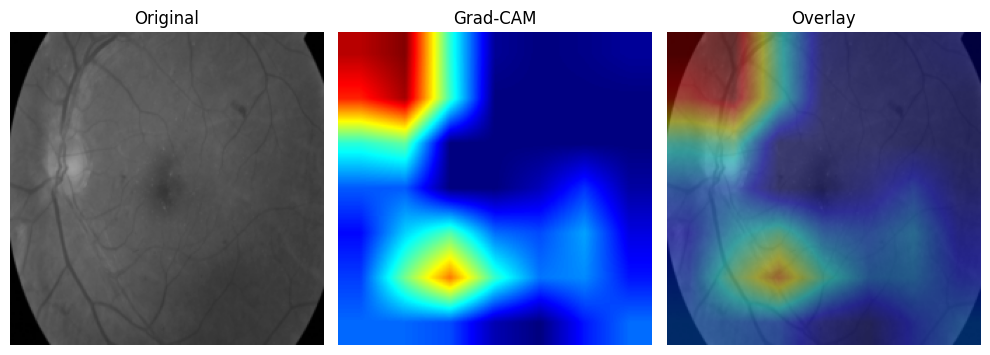

🔎 Image 23 - Predicted class: 1


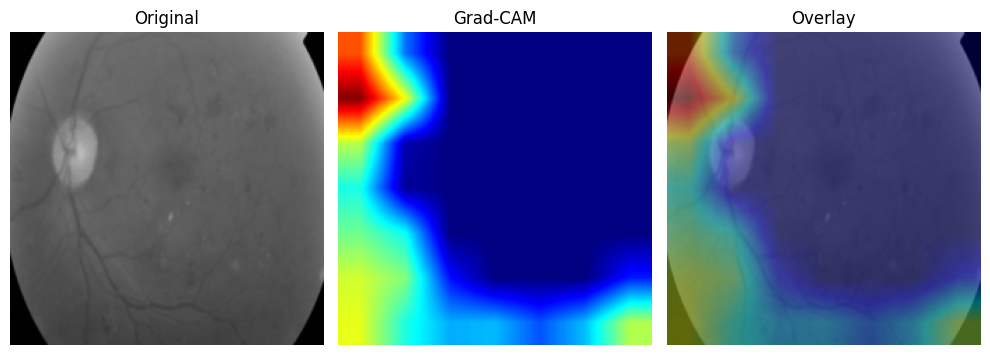

🔎 Image 24 - Predicted class: 2


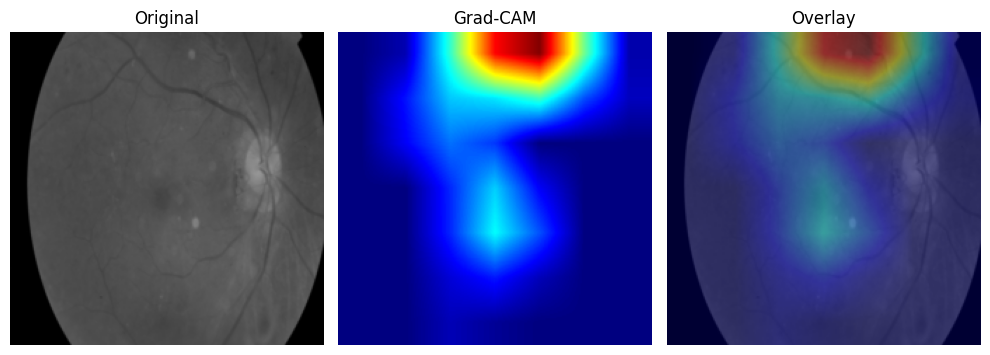

🔎 Image 25 - Predicted class: 0


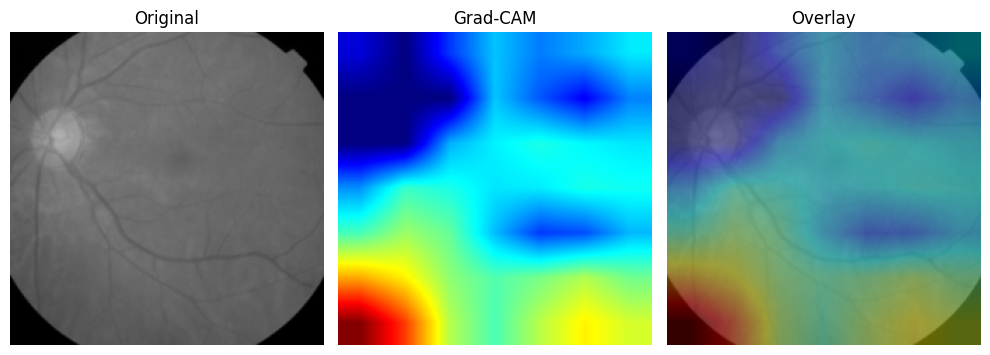

🔎 Image 26 - Predicted class: 2


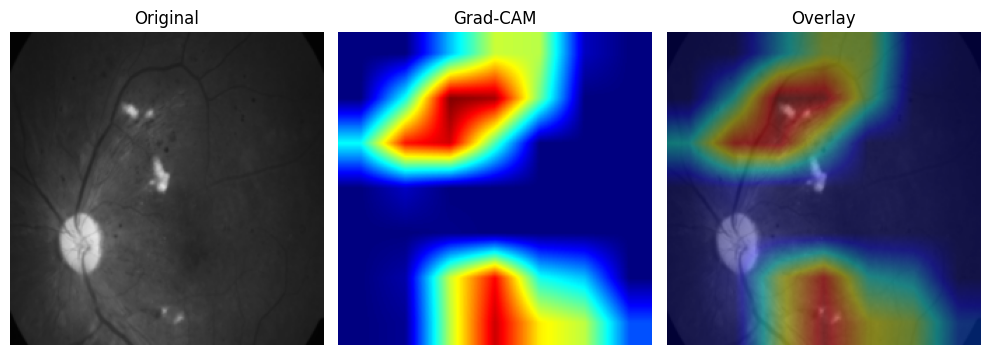

🔎 Image 27 - Predicted class: 2


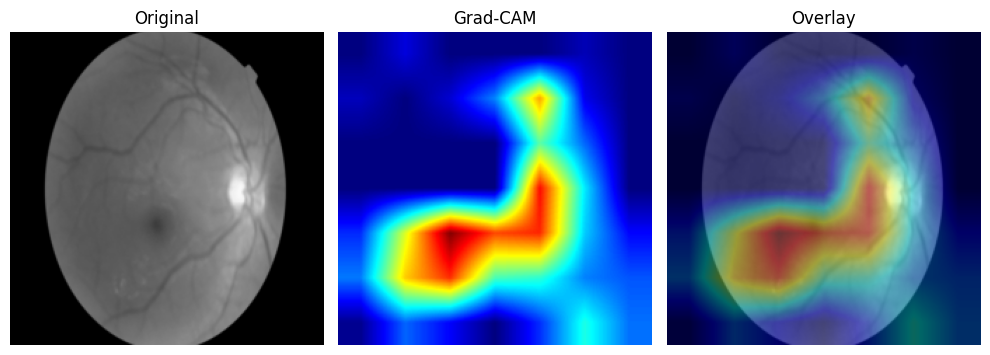

🔎 Image 28 - Predicted class: 2


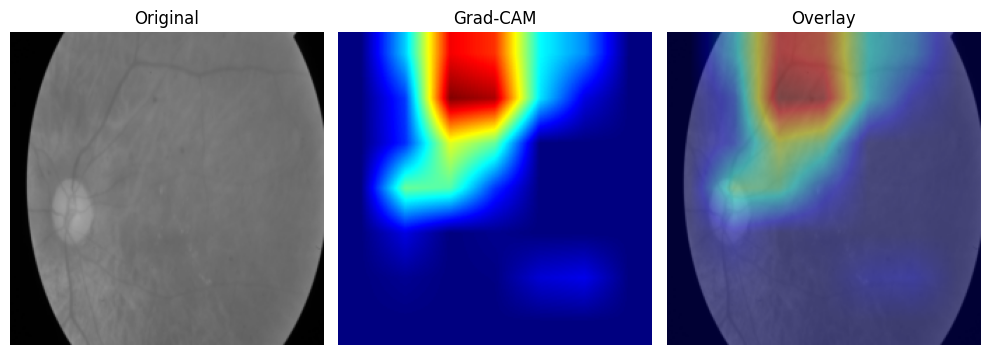

🔎 Image 29 - Predicted class: 0


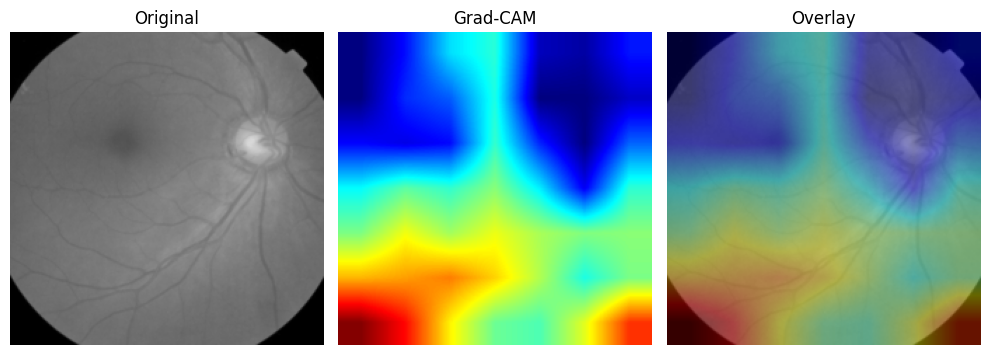

🔎 Image 30 - Predicted class: 2


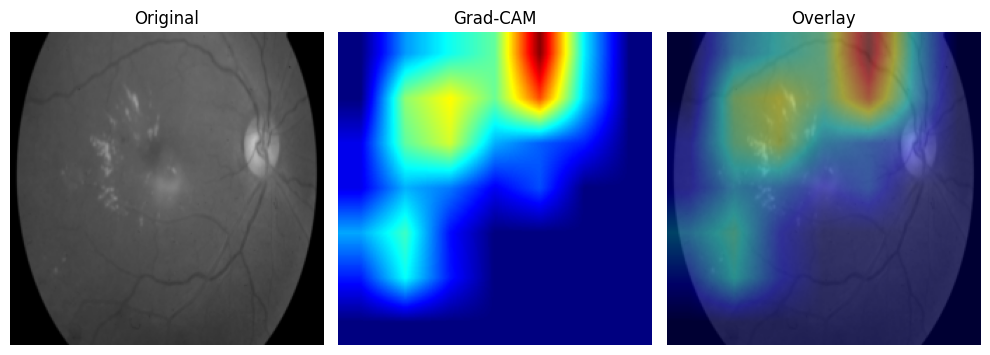

🔎 Image 31 - Predicted class: 1


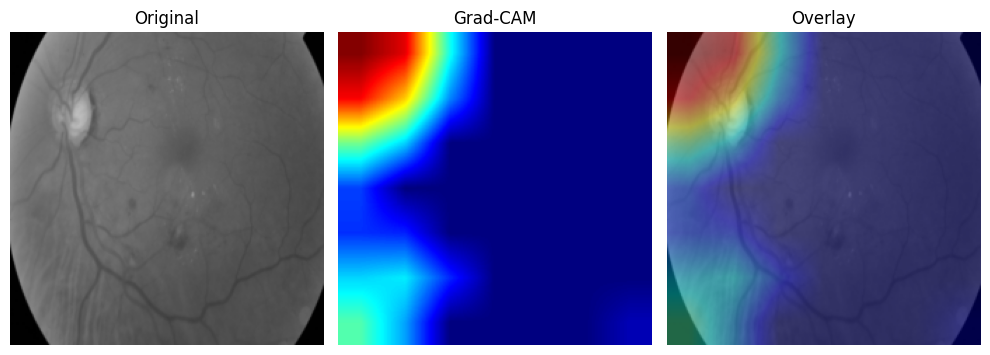

🔎 Image 32 - Predicted class: 2


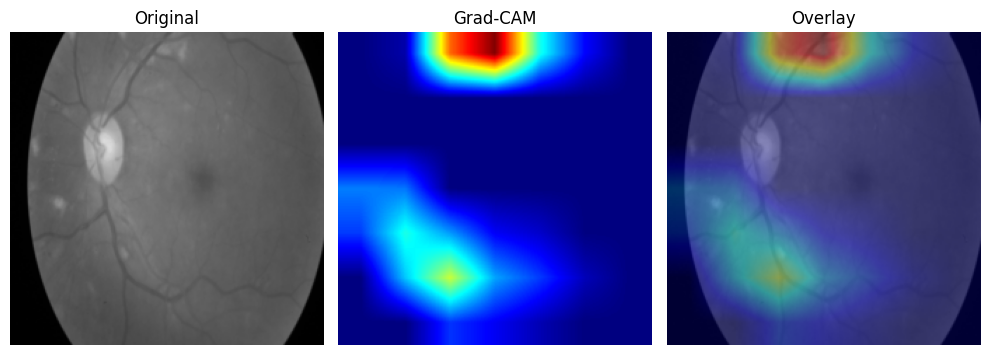

🔎 Image 33 - Predicted class: 0


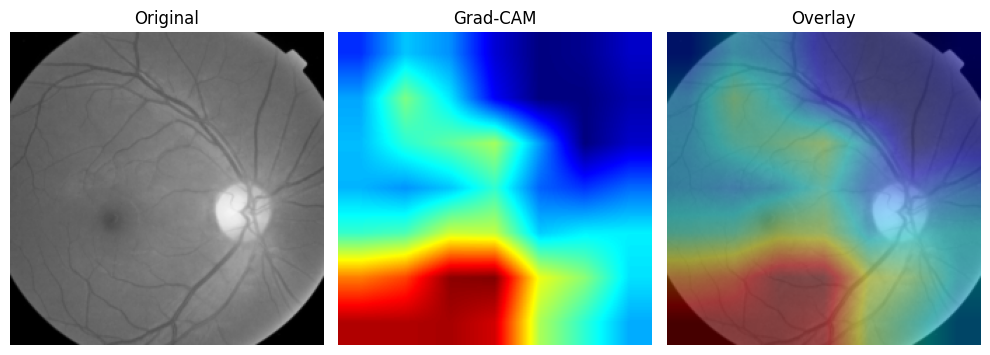

🔎 Image 34 - Predicted class: 2


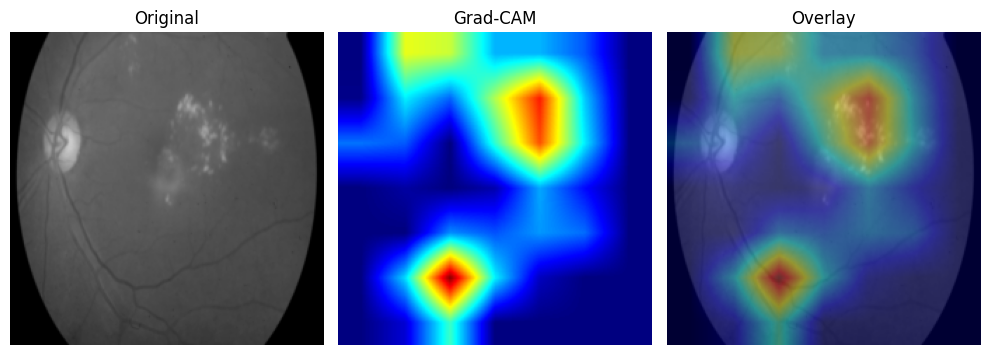

🔎 Image 35 - Predicted class: 4


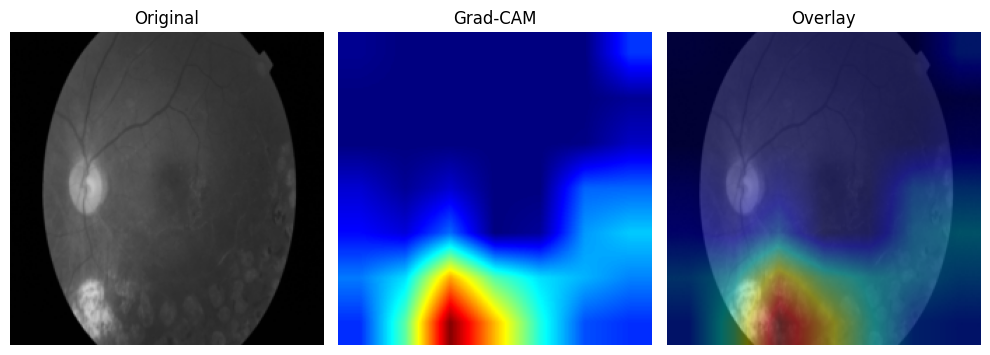

🔎 Image 36 - Predicted class: 3


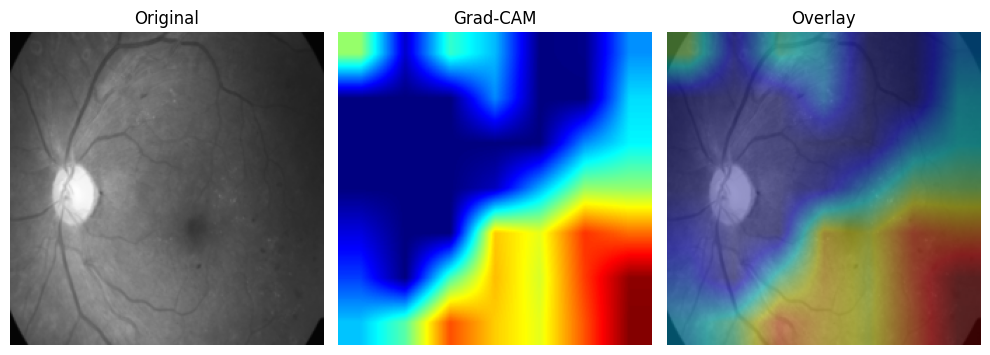

🔎 Image 37 - Predicted class: 0


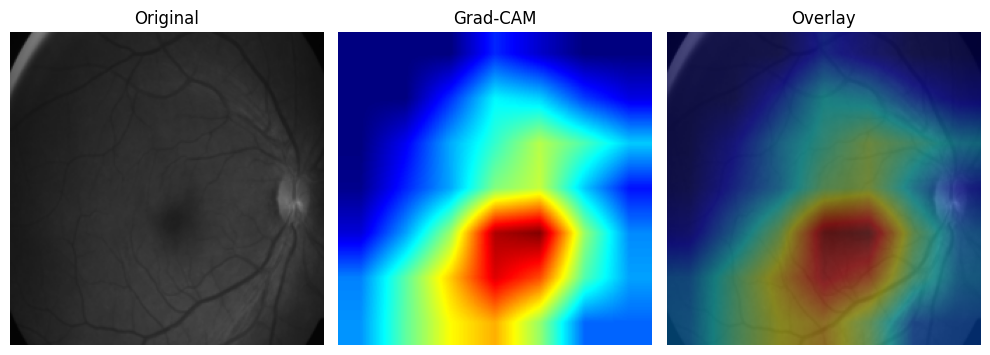

🔎 Image 38 - Predicted class: 2


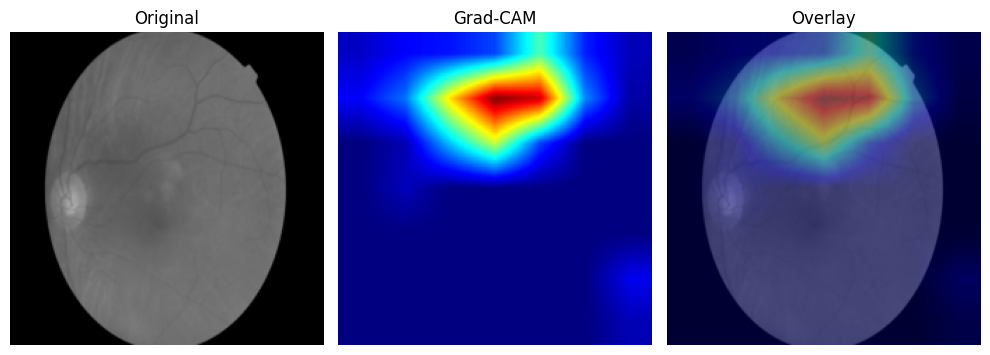

🔎 Image 39 - Predicted class: 0


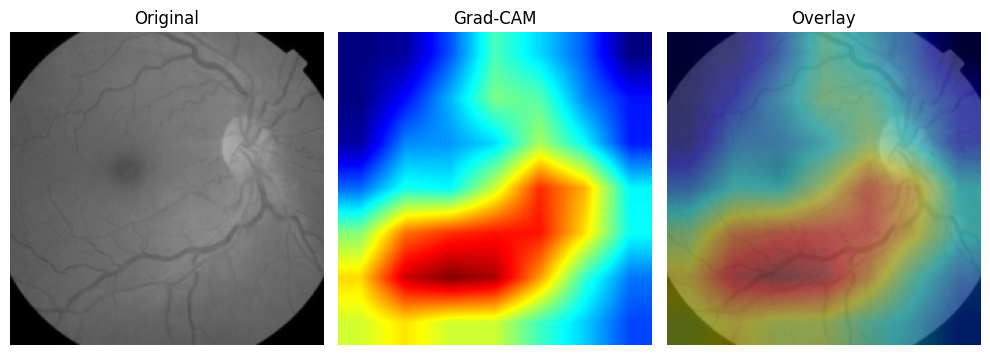

🔎 Image 40 - Predicted class: 2


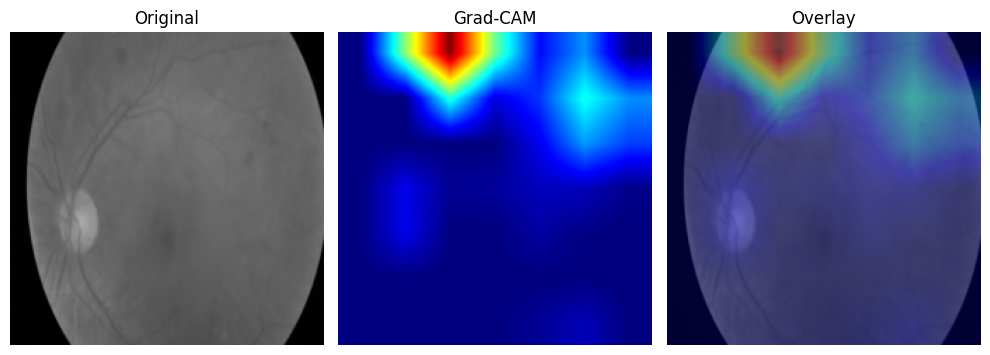

🔎 Image 41 - Predicted class: 4


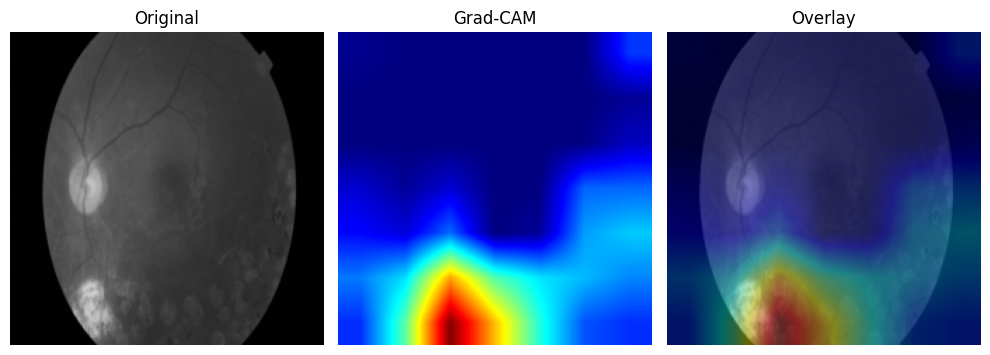

🔎 Image 42 - Predicted class: 2


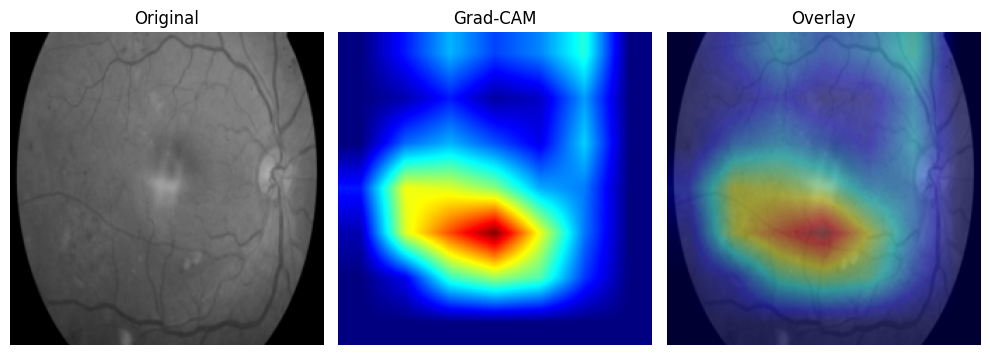

🔎 Image 43 - Predicted class: 2


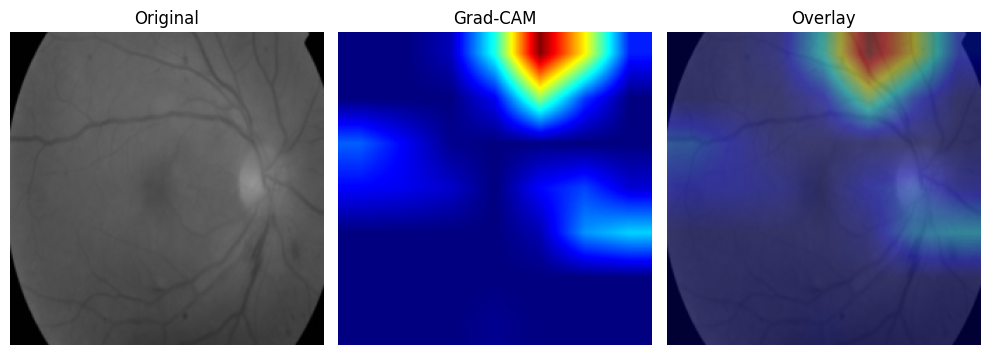

🔎 Image 44 - Predicted class: 0


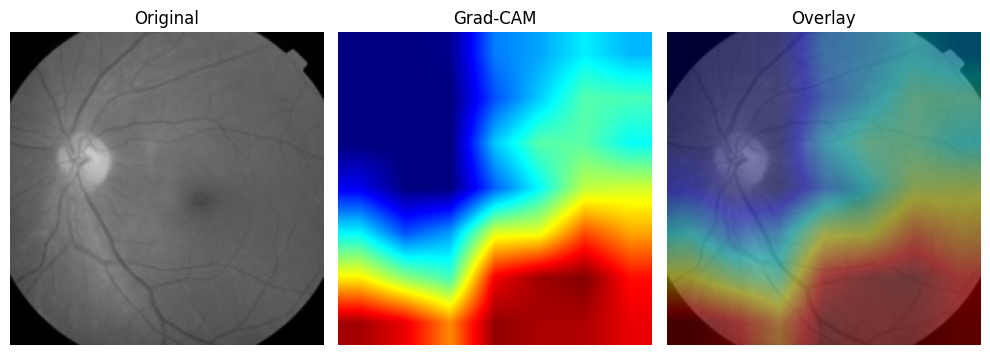

🔎 Image 45 - Predicted class: 0


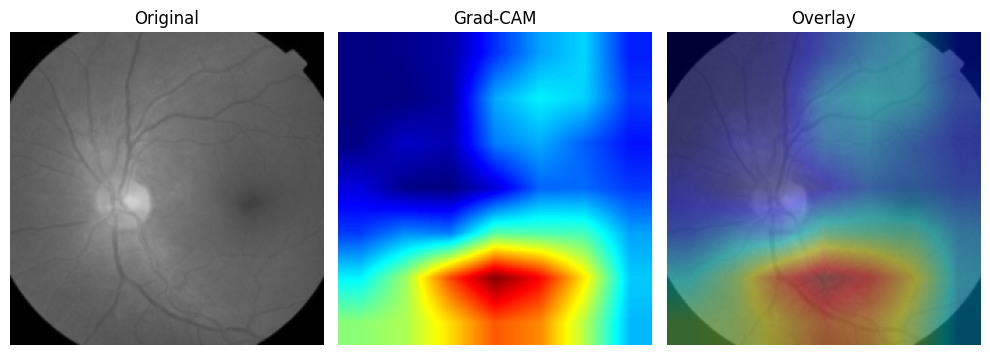

🔎 Image 46 - Predicted class: 1


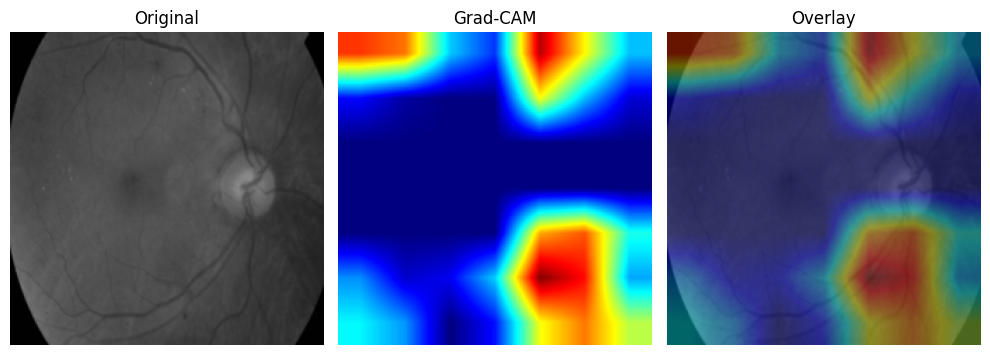

🔎 Image 47 - Predicted class: 1


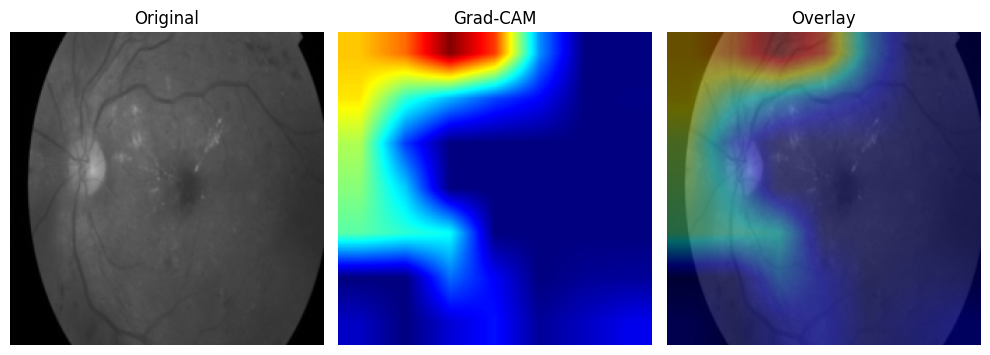

🔎 Image 48 - Predicted class: 1


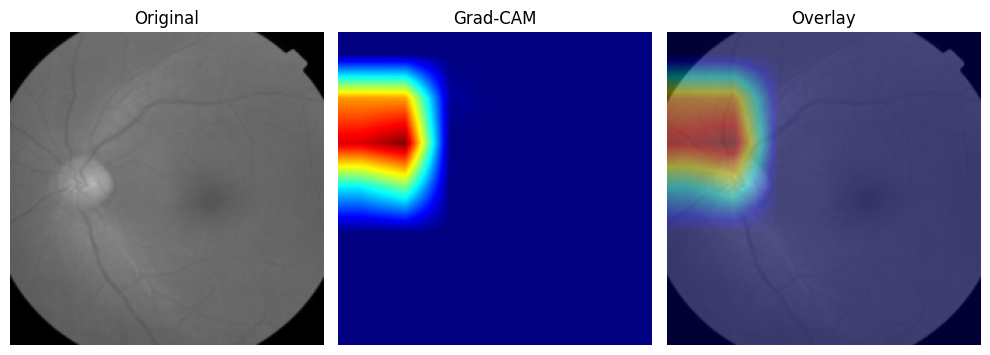

🔎 Image 49 - Predicted class: 2


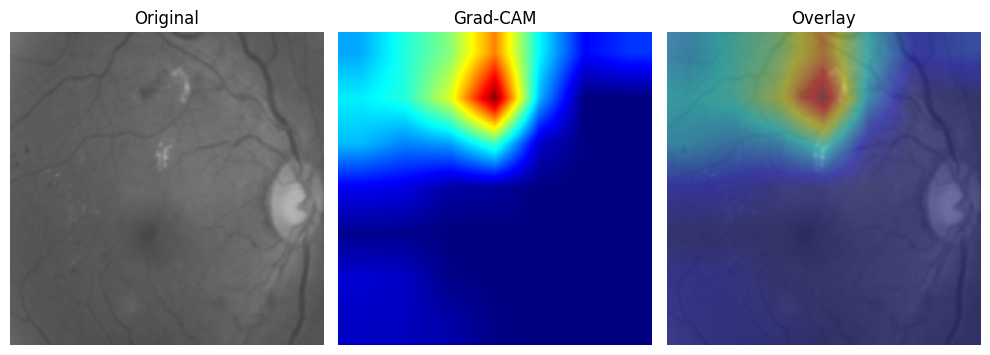

🔎 Image 50 - Predicted class: 4


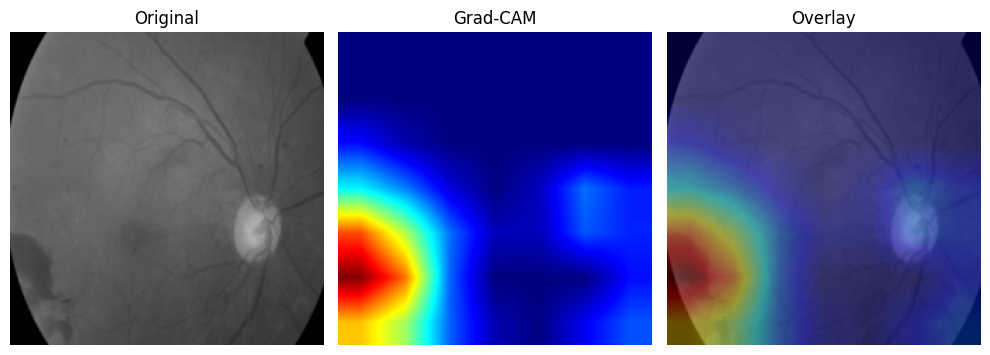

🔎 Image 51 - Predicted class: 2


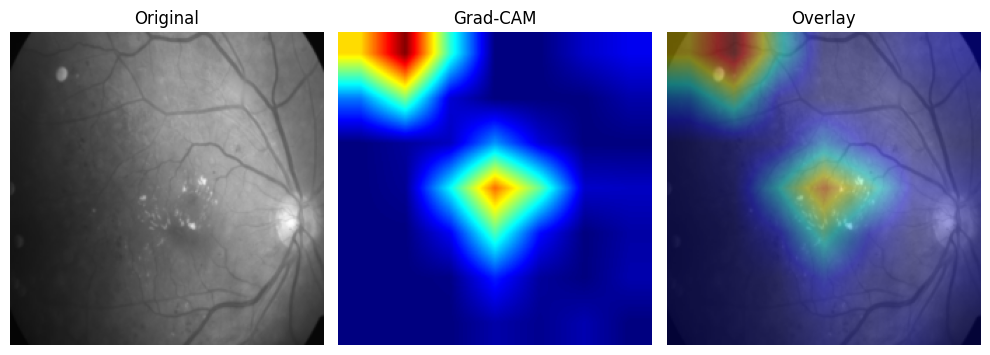

🔎 Image 52 - Predicted class: 2


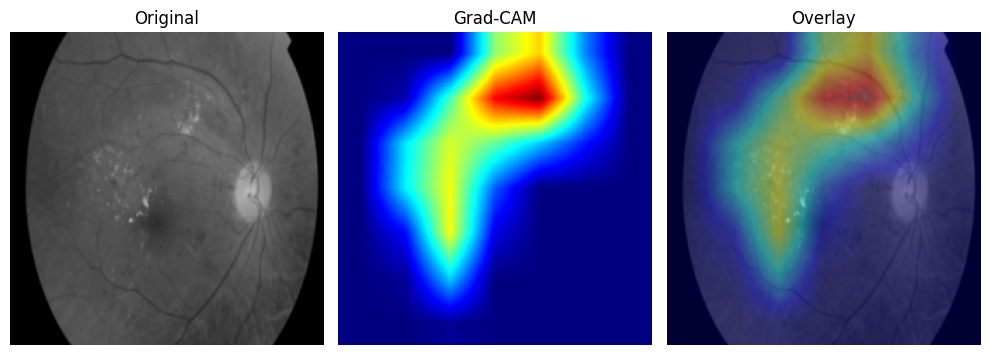

🔎 Image 53 - Predicted class: 1


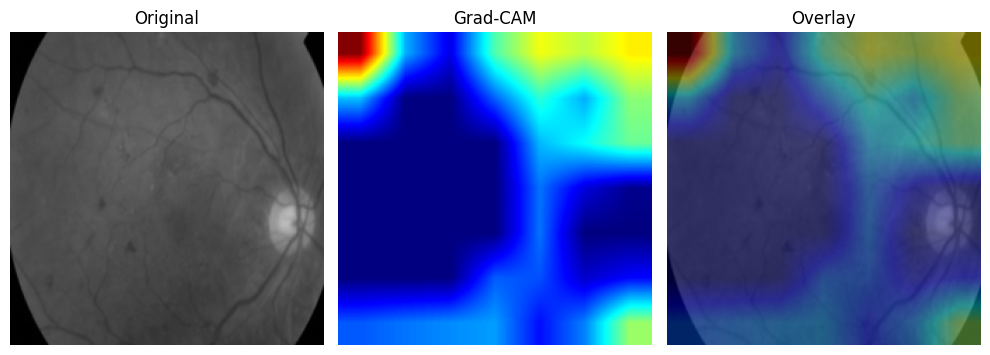

🔎 Image 54 - Predicted class: 2


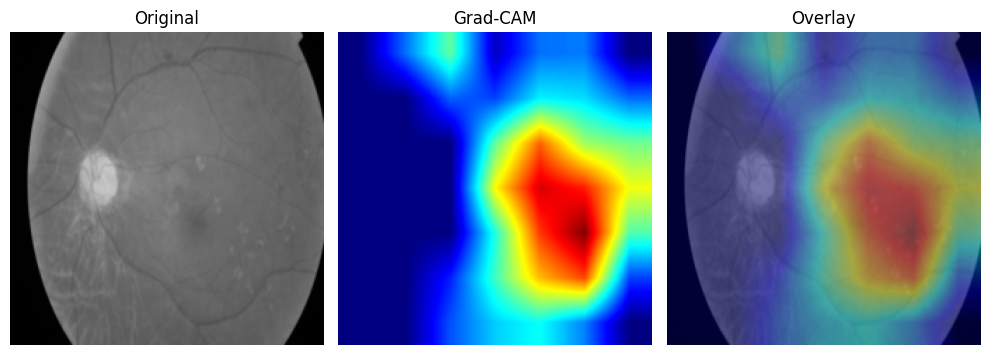

🔎 Image 55 - Predicted class: 0


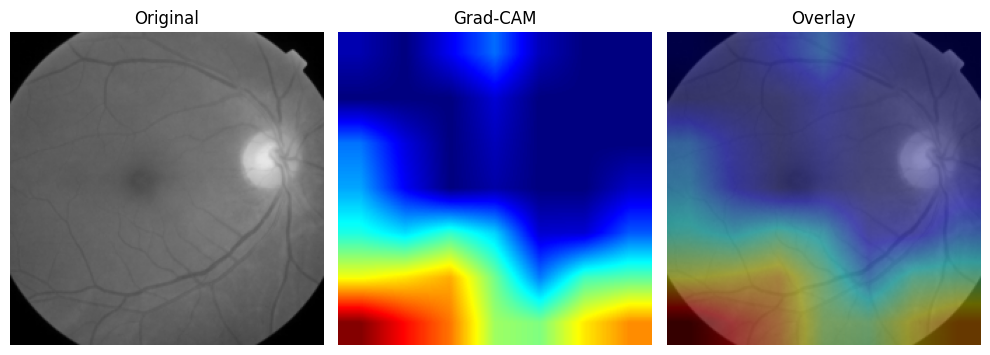

🔎 Image 56 - Predicted class: 2


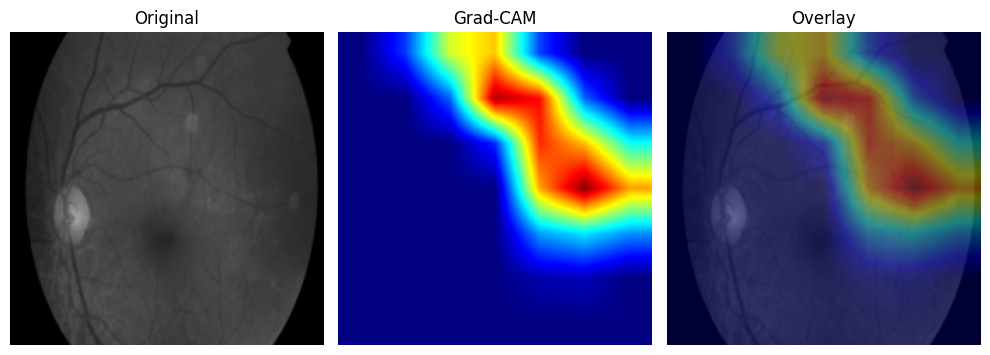

🔎 Image 57 - Predicted class: 4


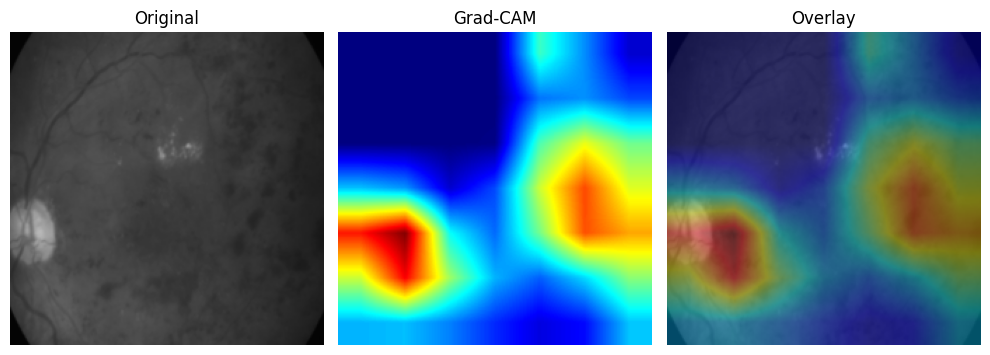

🔎 Image 58 - Predicted class: 1


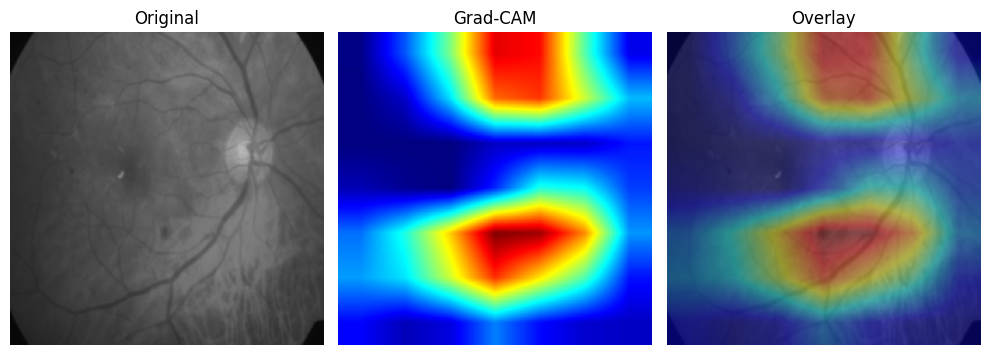

🔎 Image 59 - Predicted class: 0


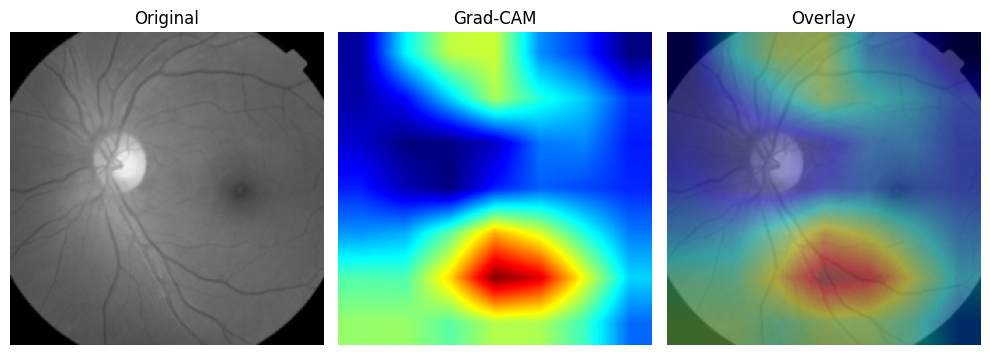

🔎 Image 60 - Predicted class: 0


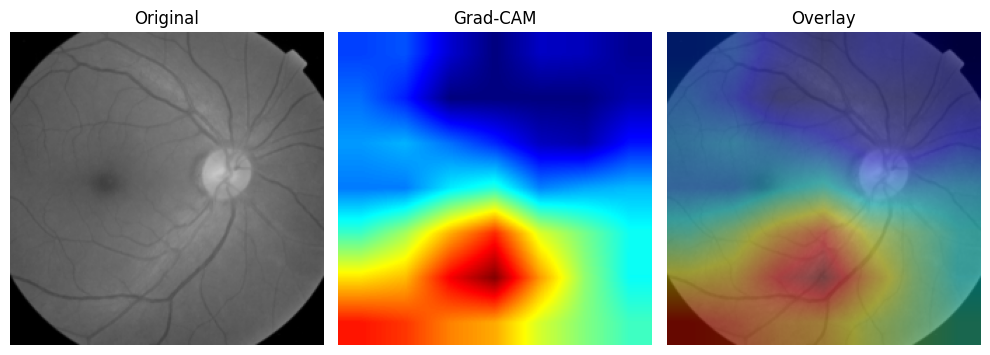

🔎 Image 61 - Predicted class: 1


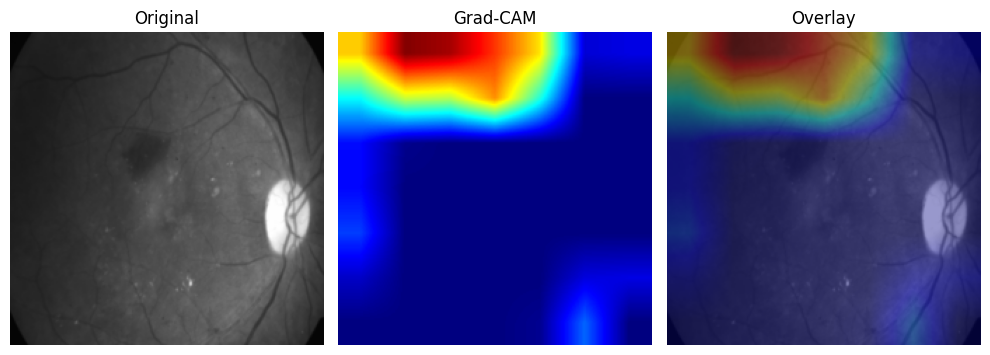

🔎 Image 62 - Predicted class: 2


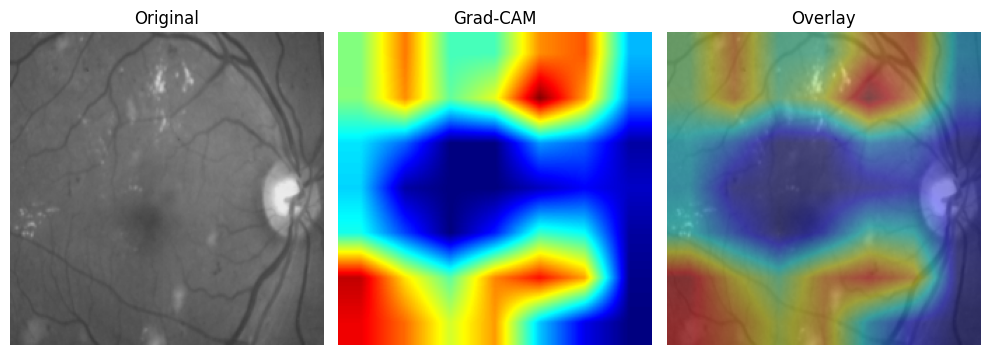

🔎 Image 63 - Predicted class: 0


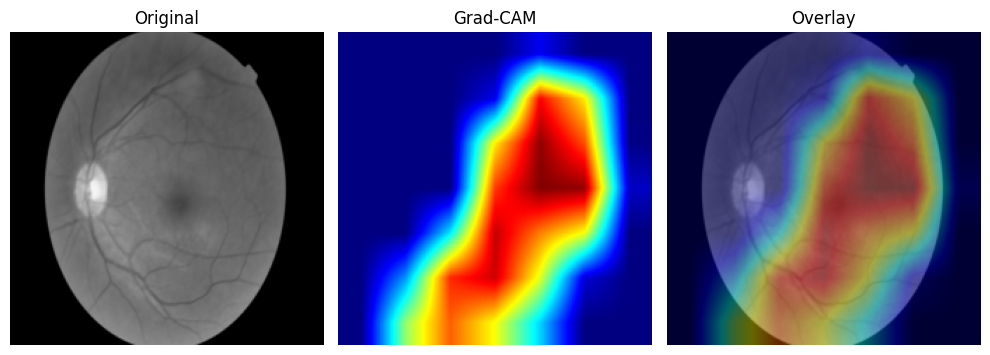

🔎 Image 64 - Predicted class: 1


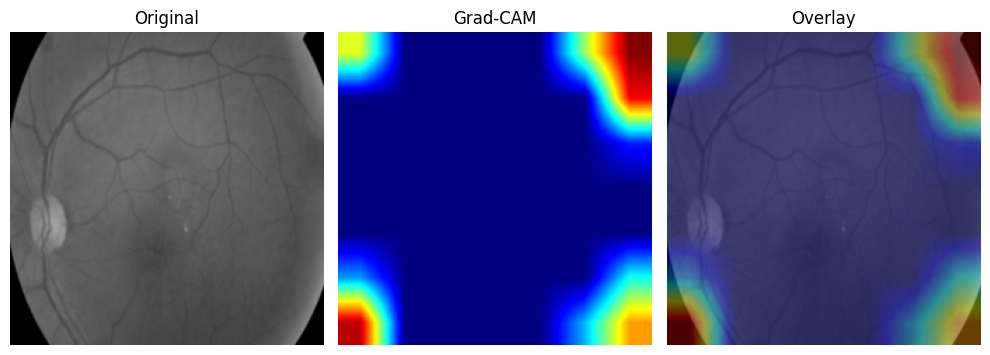

🔎 Image 65 - Predicted class: 2


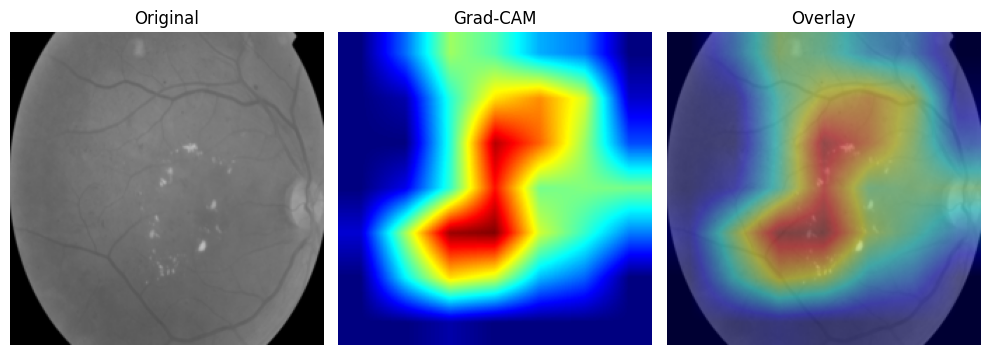

🔎 Image 66 - Predicted class: 2


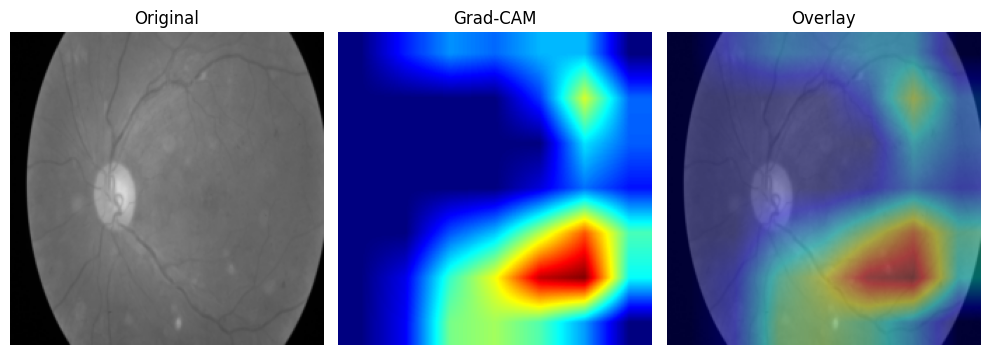

🔎 Image 67 - Predicted class: 2


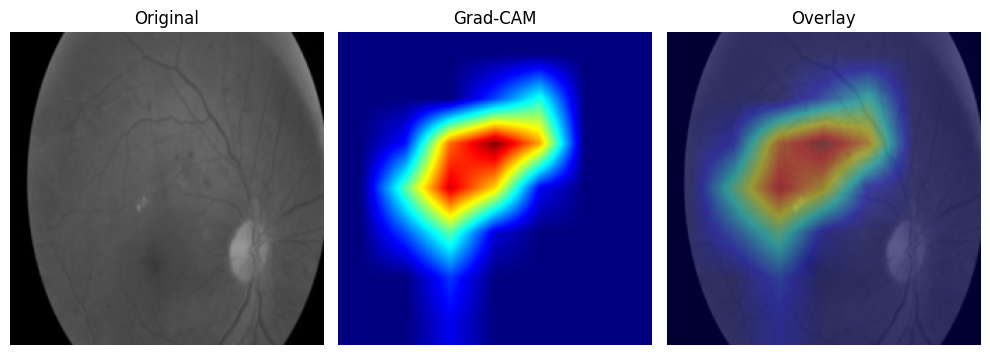

🔎 Image 68 - Predicted class: 2


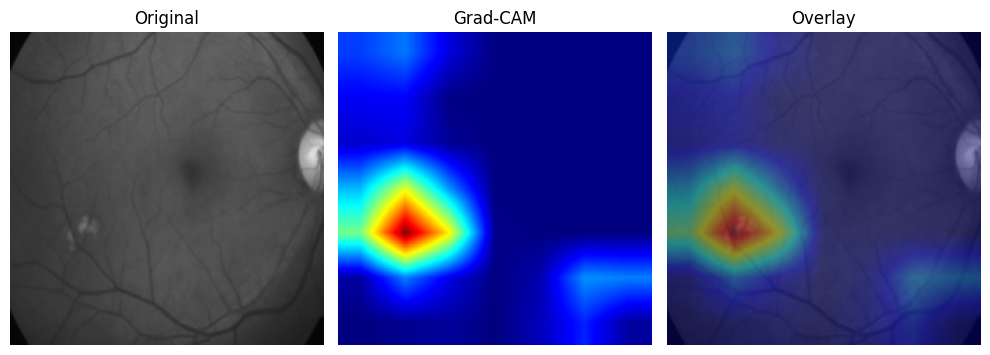

🔎 Image 69 - Predicted class: 4


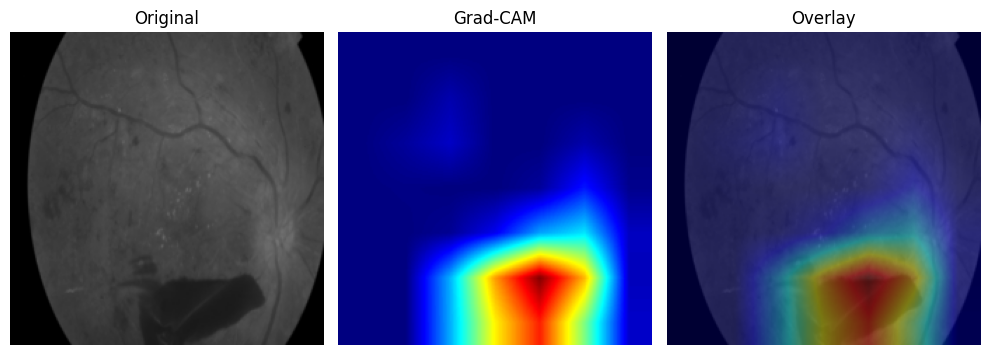

🔎 Image 70 - Predicted class: 0


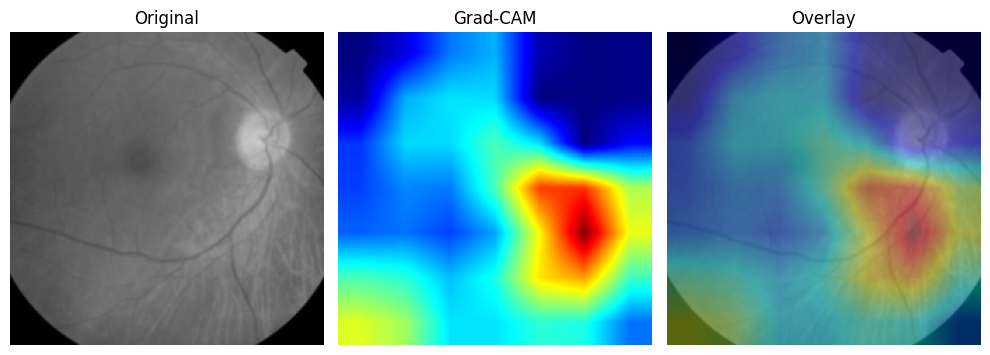

🔎 Image 71 - Predicted class: 2


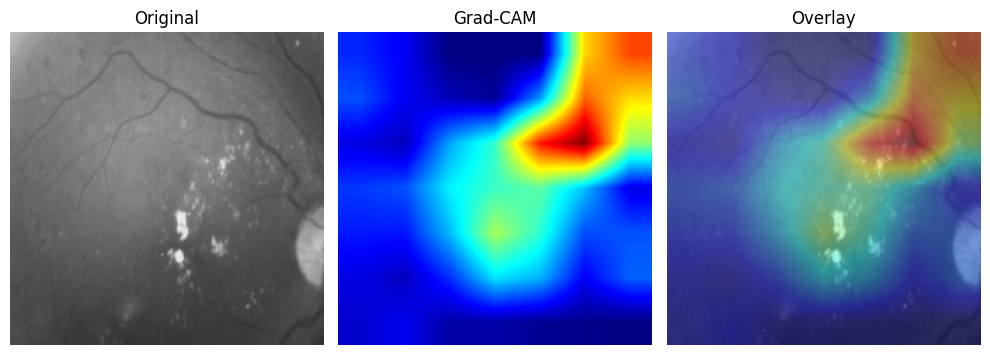

🔎 Image 72 - Predicted class: 2


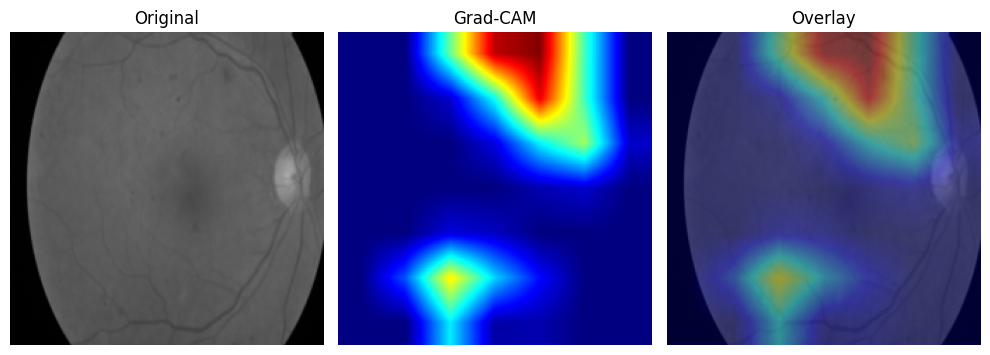

🔎 Image 73 - Predicted class: 0


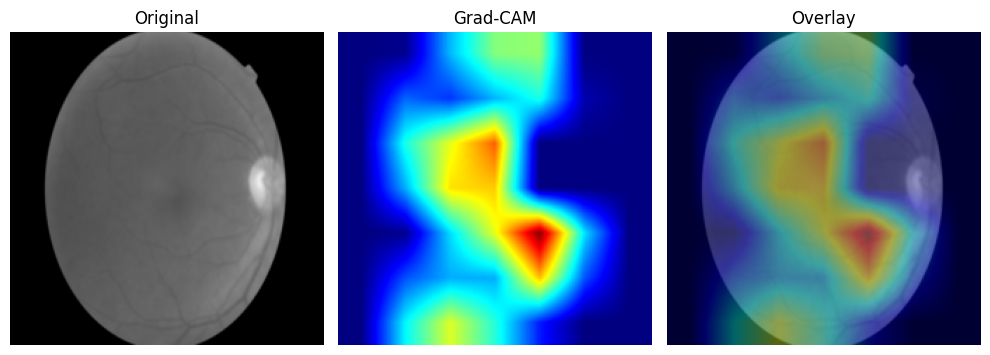

🔎 Image 74 - Predicted class: 2


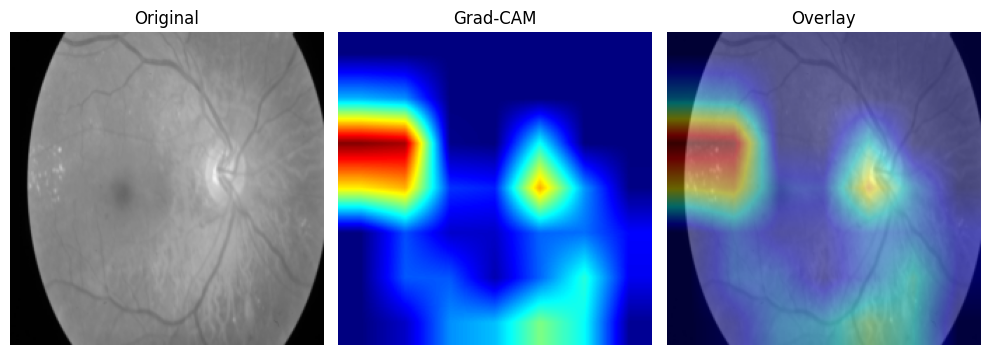

🔎 Image 75 - Predicted class: 2


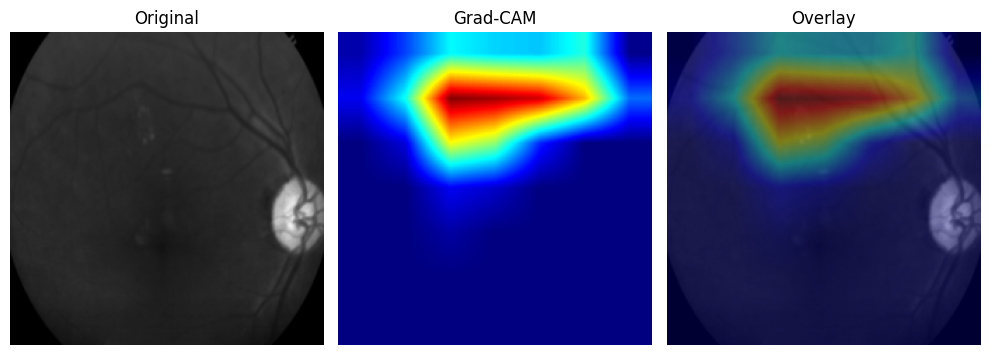

🔎 Image 76 - Predicted class: 0


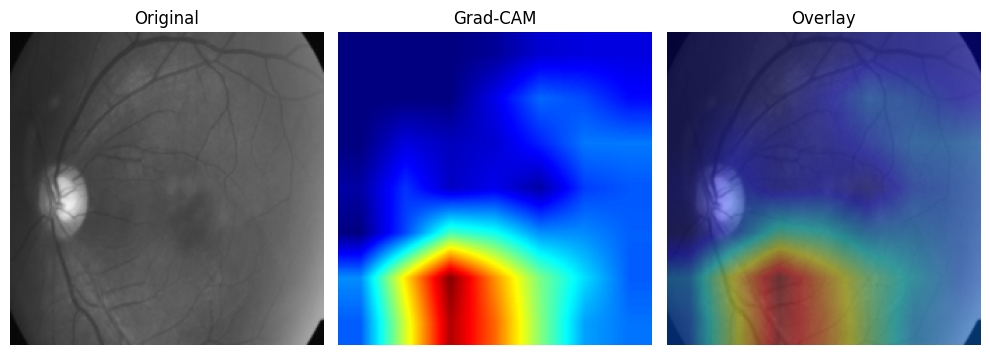

🔎 Image 77 - Predicted class: 2


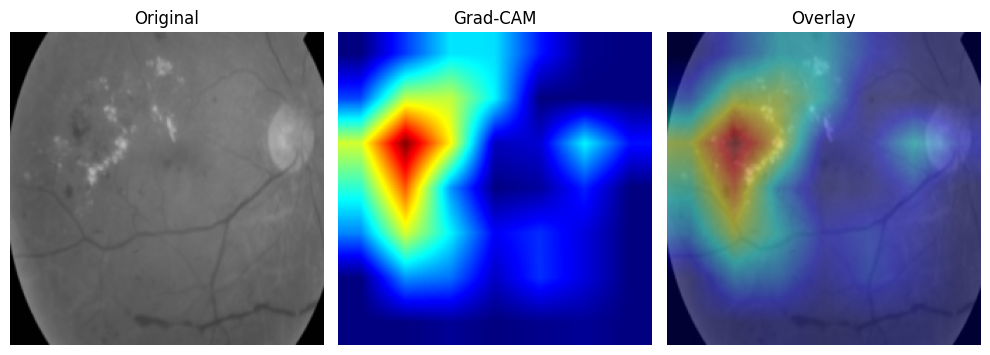

🔎 Image 78 - Predicted class: 1


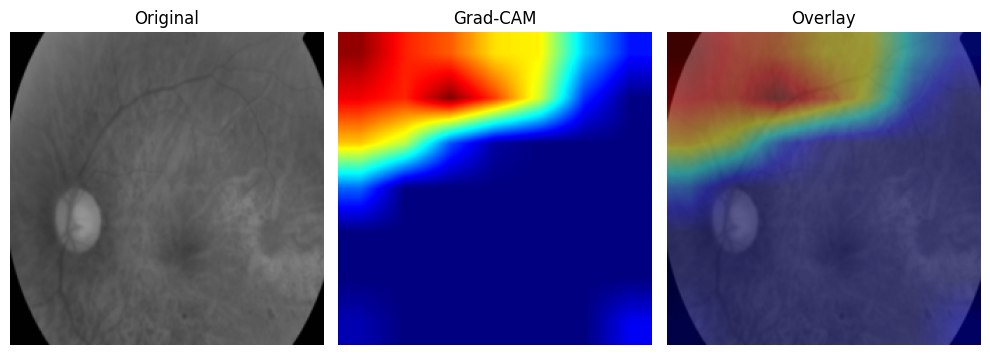

🔎 Image 79 - Predicted class: 2


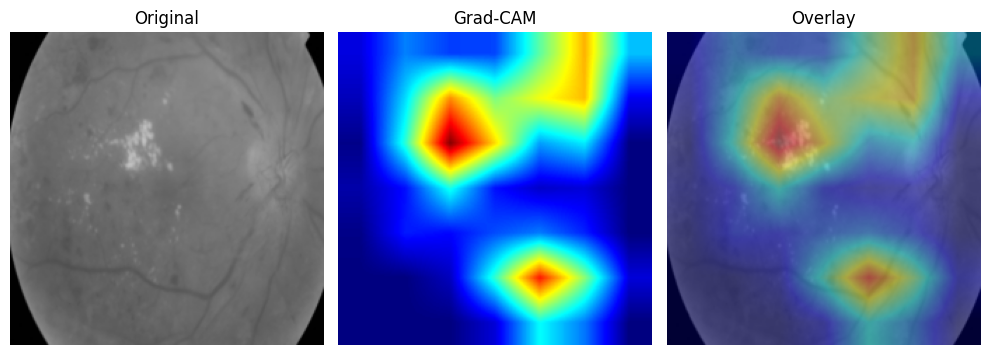

🔎 Image 80 - Predicted class: 0


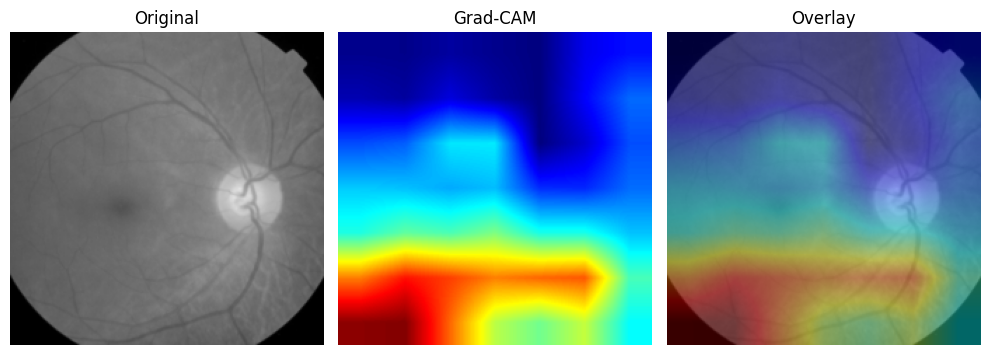

🔎 Image 81 - Predicted class: 0


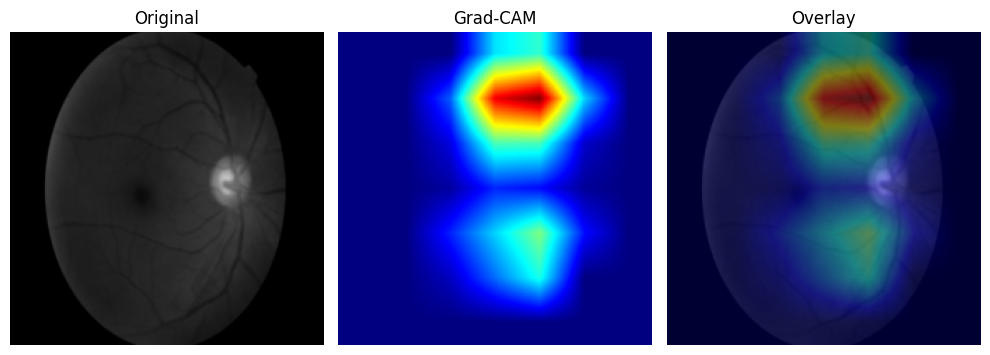

🔎 Image 82 - Predicted class: 0


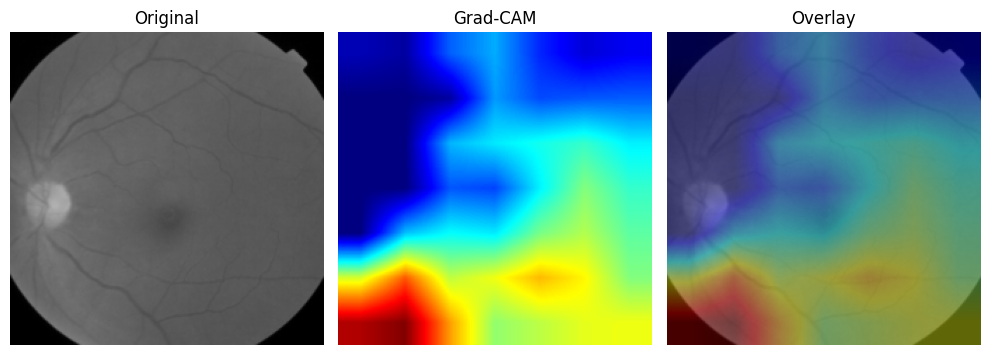

🔎 Image 83 - Predicted class: 0


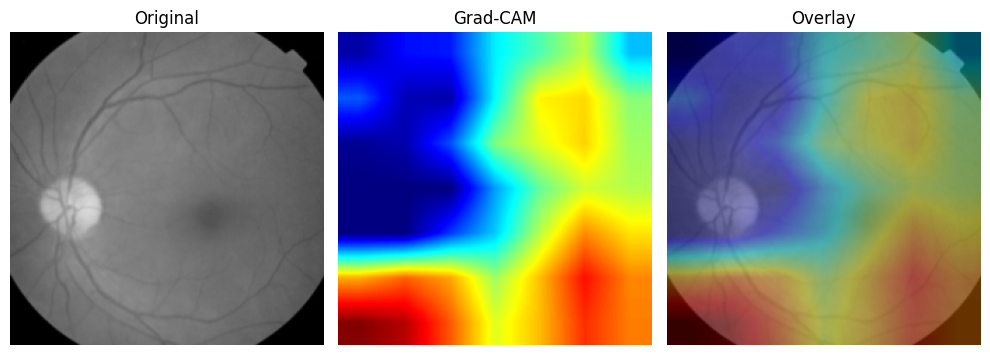

🔎 Image 84 - Predicted class: 2


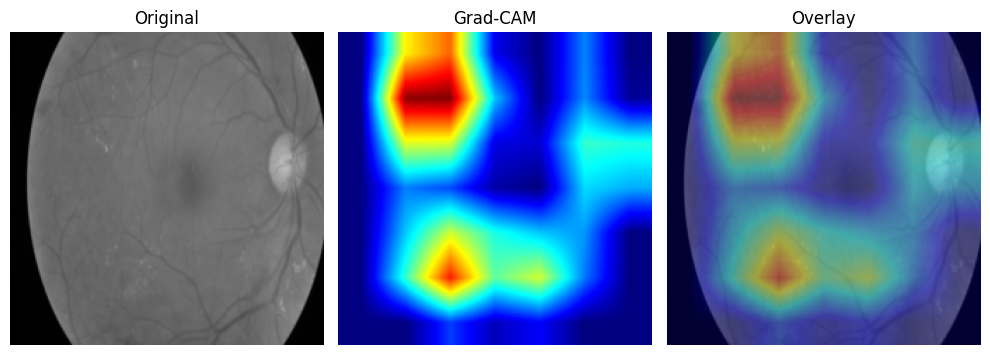

🔎 Image 85 - Predicted class: 0


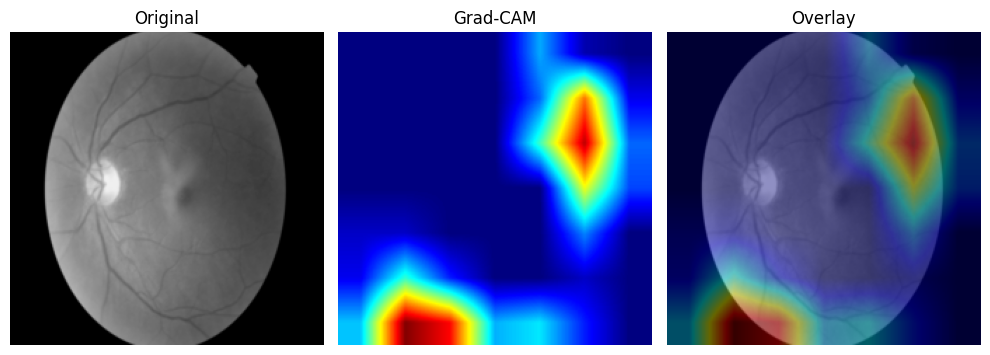

🔎 Image 86 - Predicted class: 2


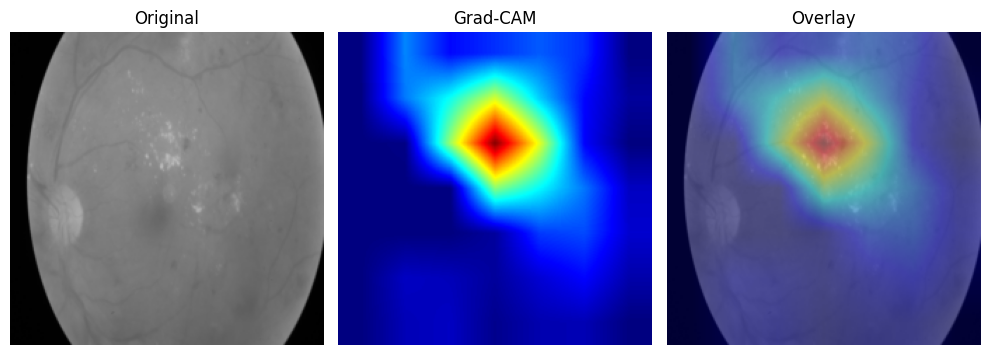

🔎 Image 87 - Predicted class: 4


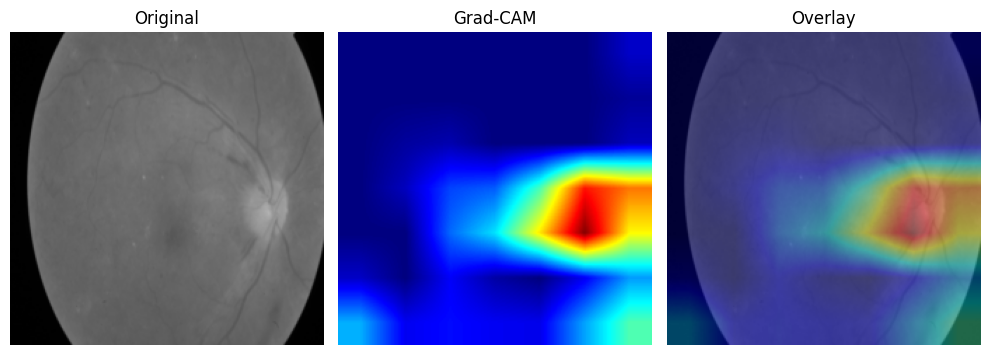

🔎 Image 88 - Predicted class: 2


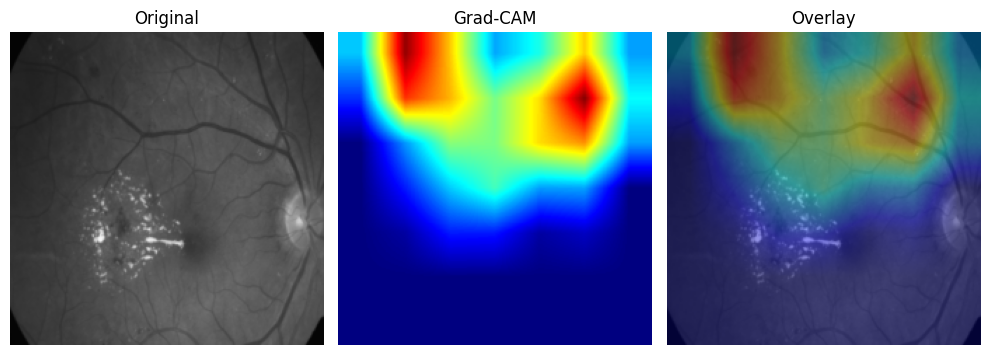

🔎 Image 89 - Predicted class: 4


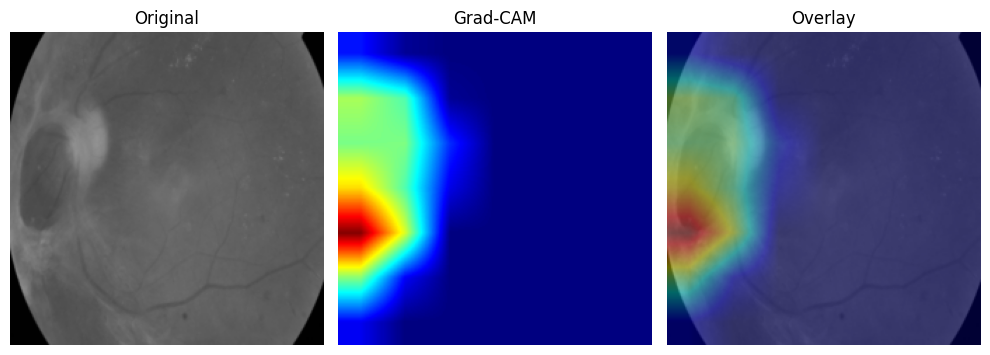

🔎 Image 90 - Predicted class: 2


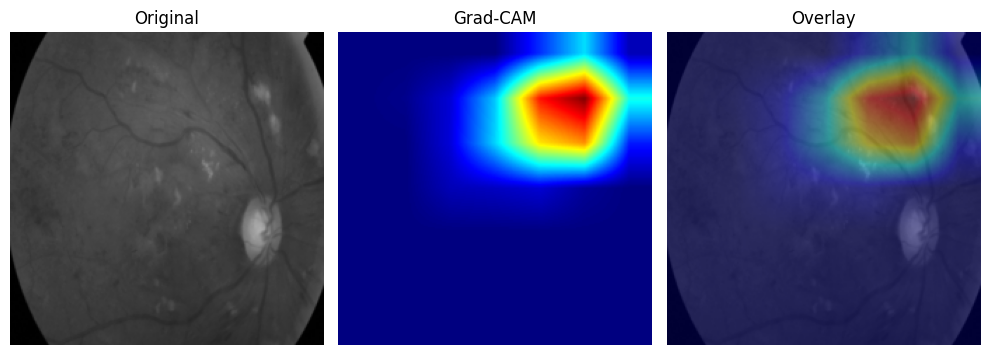

🔎 Image 91 - Predicted class: 2


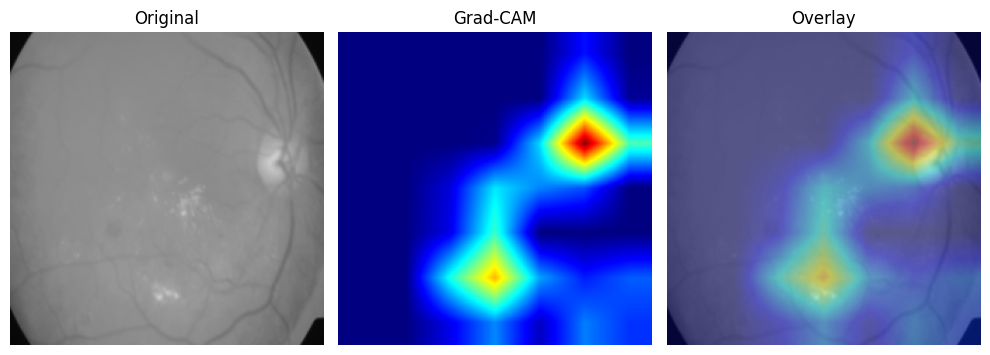

🔎 Image 92 - Predicted class: 2


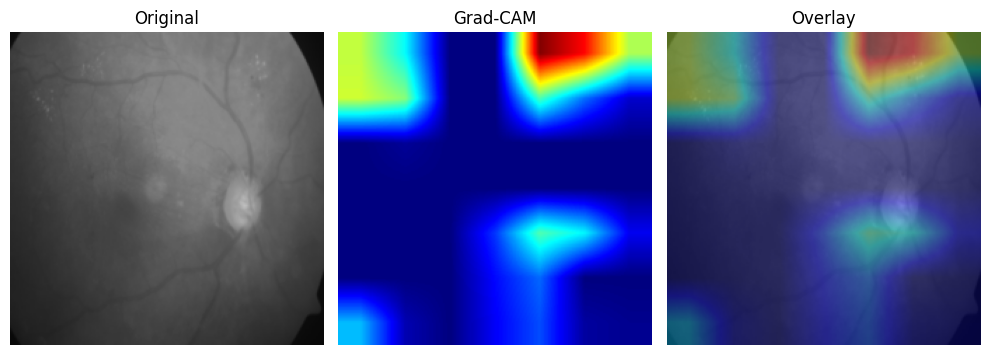

🔎 Image 93 - Predicted class: 0


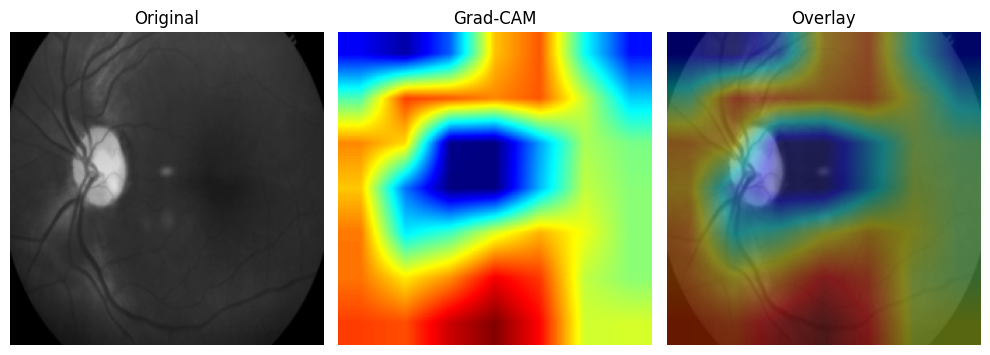

🔎 Image 94 - Predicted class: 0


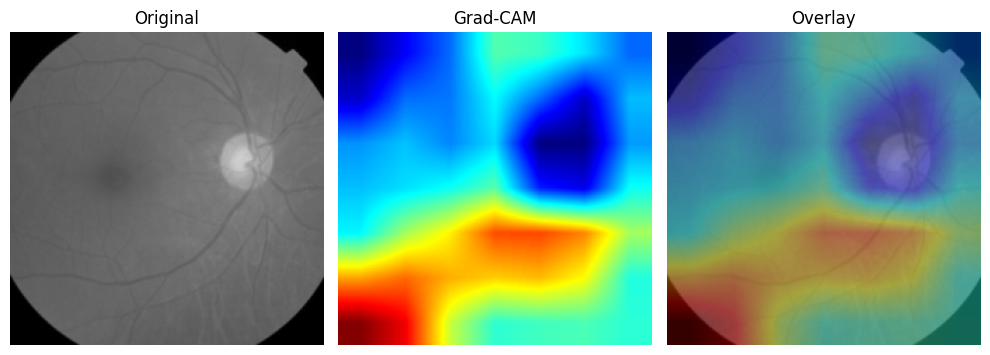

🔎 Image 95 - Predicted class: 4


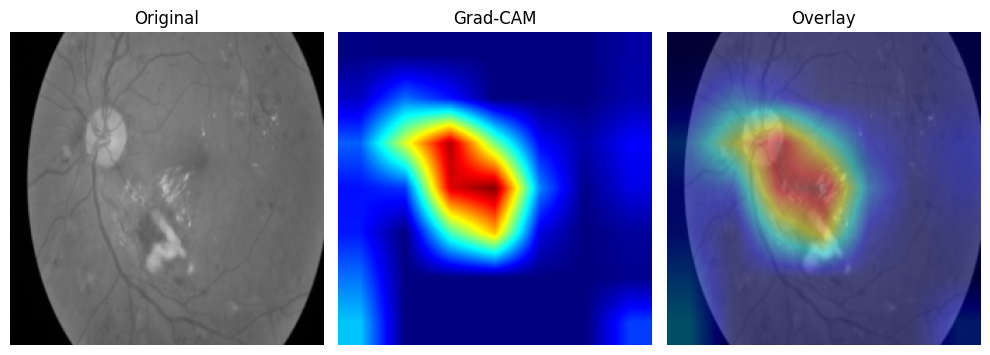

🔎 Image 96 - Predicted class: 2


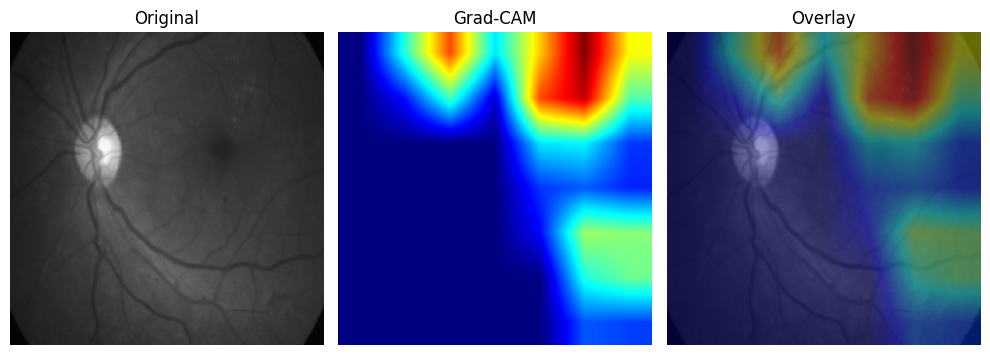

🔎 Image 97 - Predicted class: 0


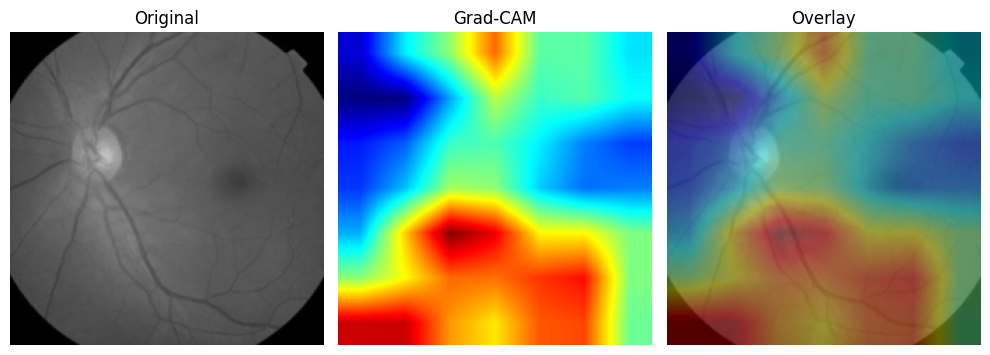

🔎 Image 98 - Predicted class: 2


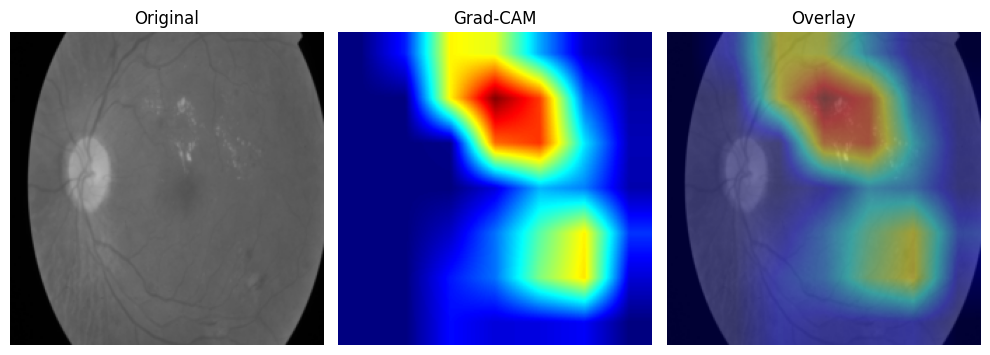

🔎 Image 99 - Predicted class: 0


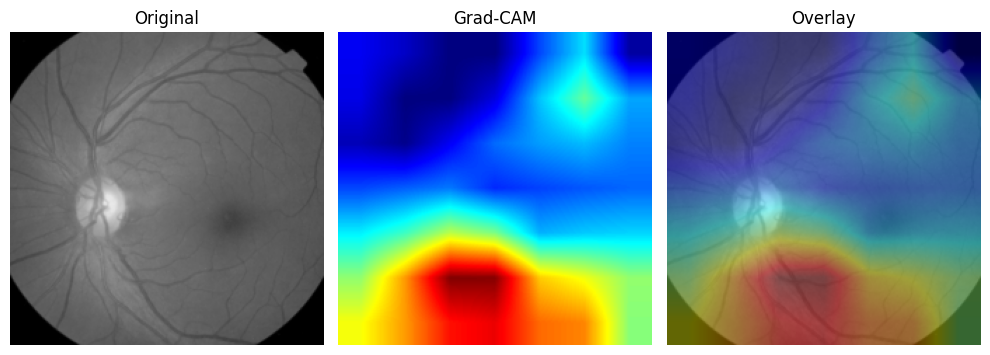

🔎 Image 100 - Predicted class: 2


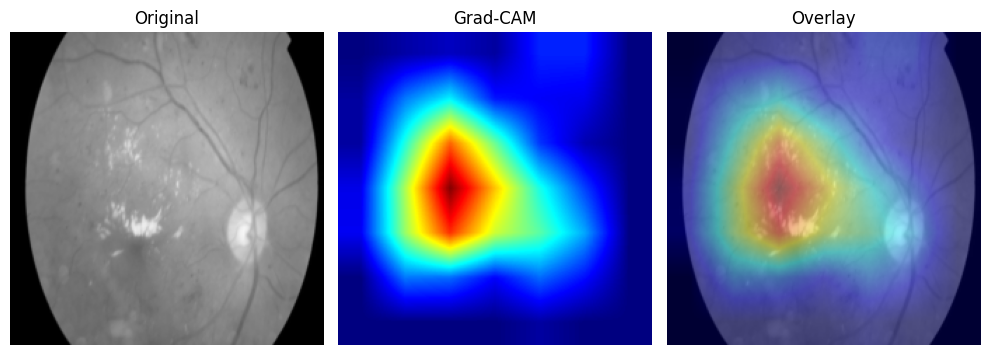

🔎 Image 101 - Predicted class: 2


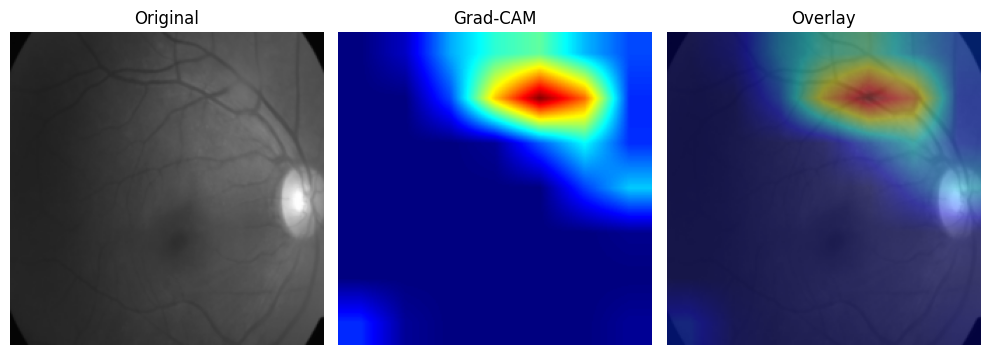

🔎 Image 102 - Predicted class: 0


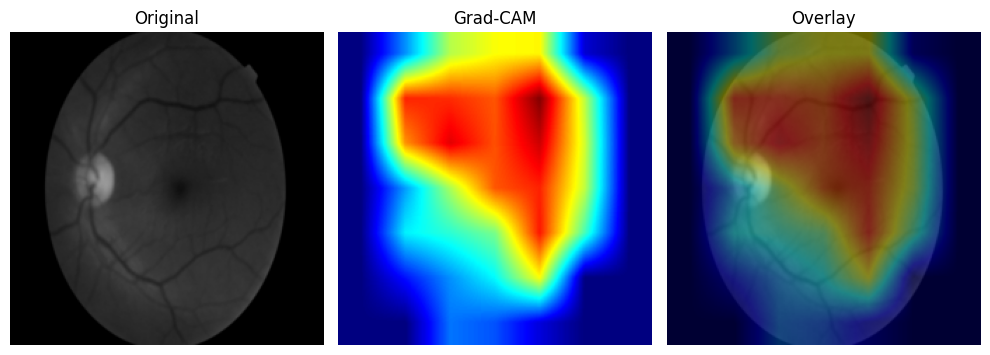

🔎 Image 103 - Predicted class: 0


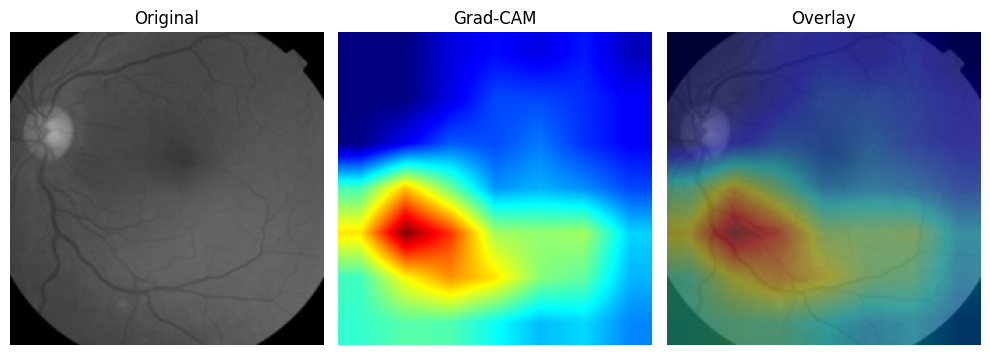

🔎 Image 104 - Predicted class: 4


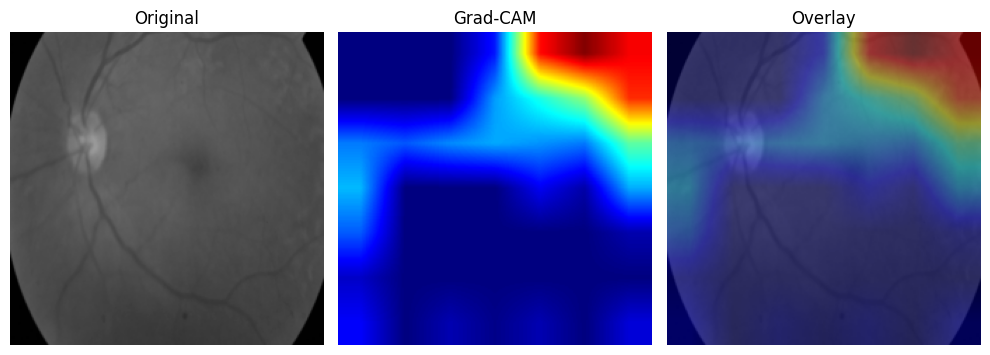

🔎 Image 105 - Predicted class: 2


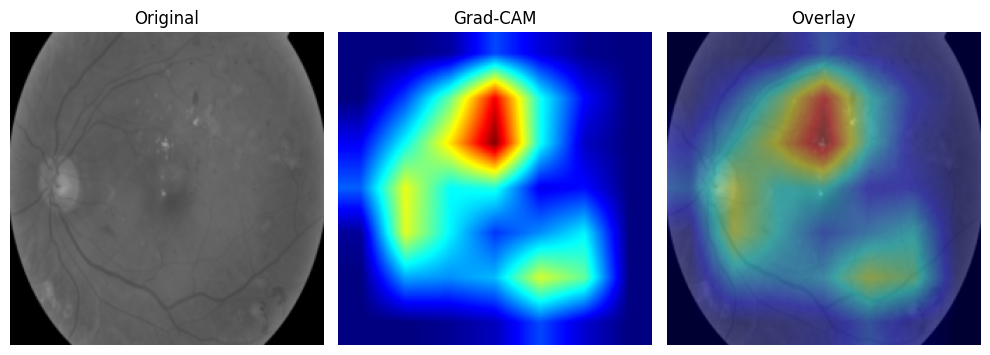

🔎 Image 106 - Predicted class: 1


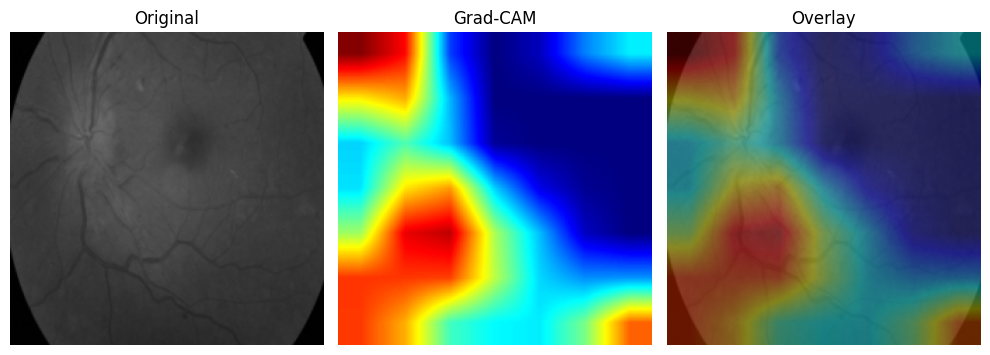

🔎 Image 107 - Predicted class: 4


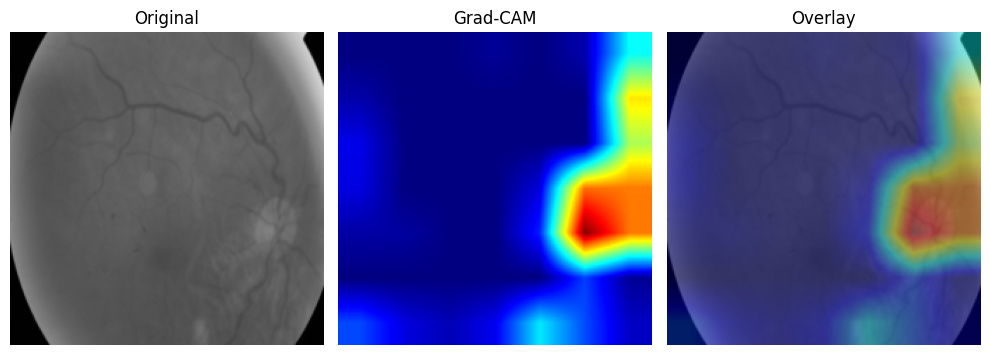

🔎 Image 108 - Predicted class: 2


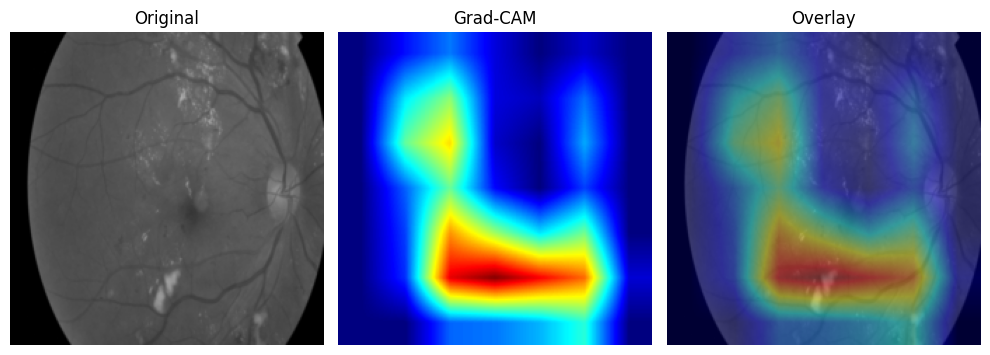

🔎 Image 109 - Predicted class: 2


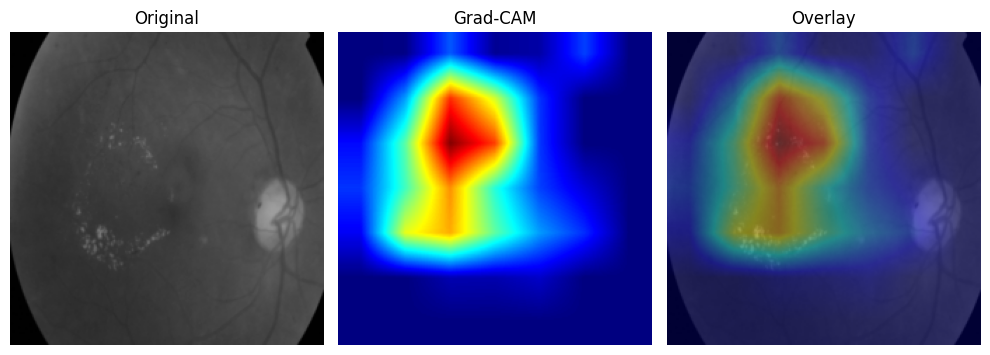

🔎 Image 110 - Predicted class: 0


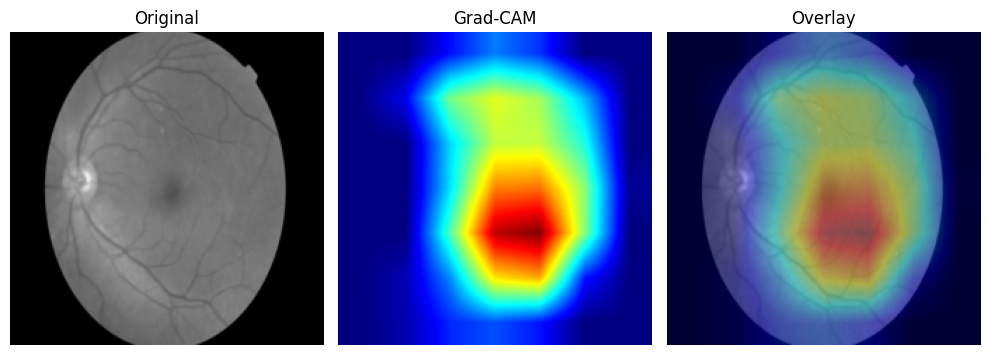

🔎 Image 111 - Predicted class: 0


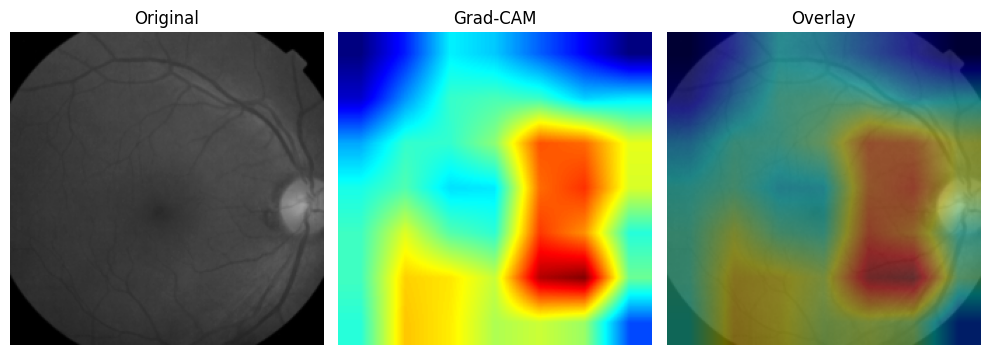

🔎 Image 112 - Predicted class: 2


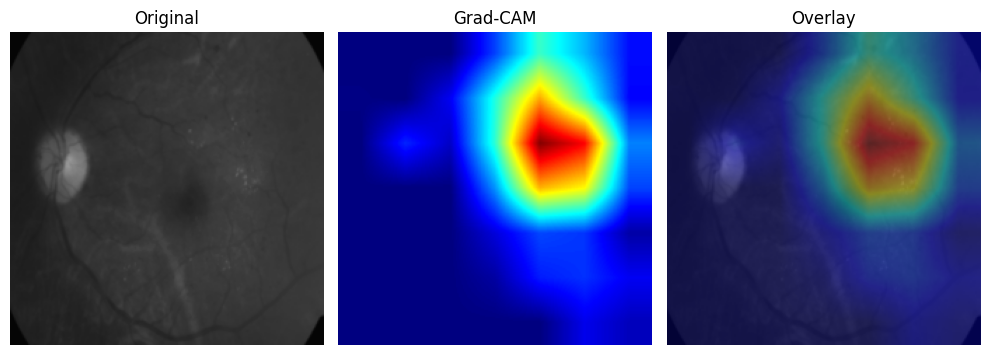

🔎 Image 113 - Predicted class: 4


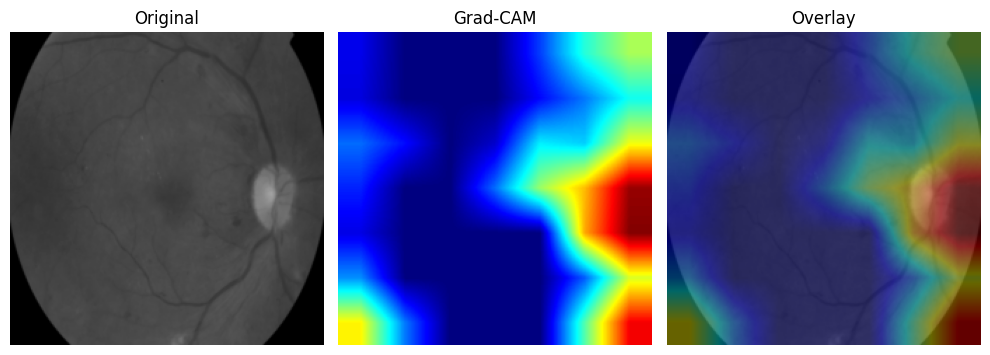

🔎 Image 114 - Predicted class: 2


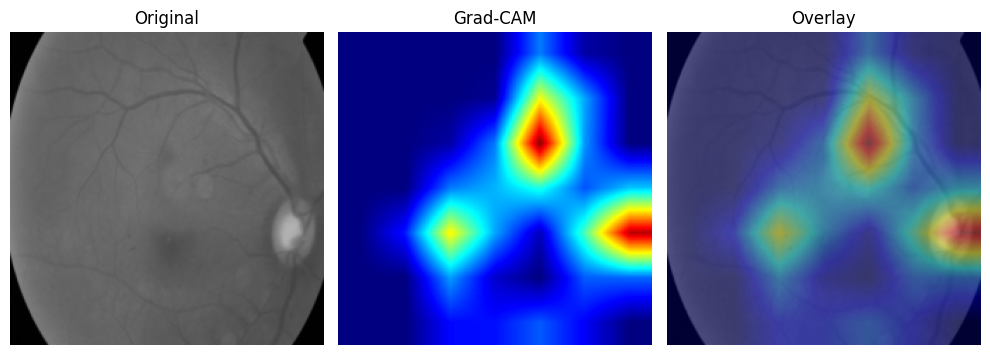

🔎 Image 115 - Predicted class: 1


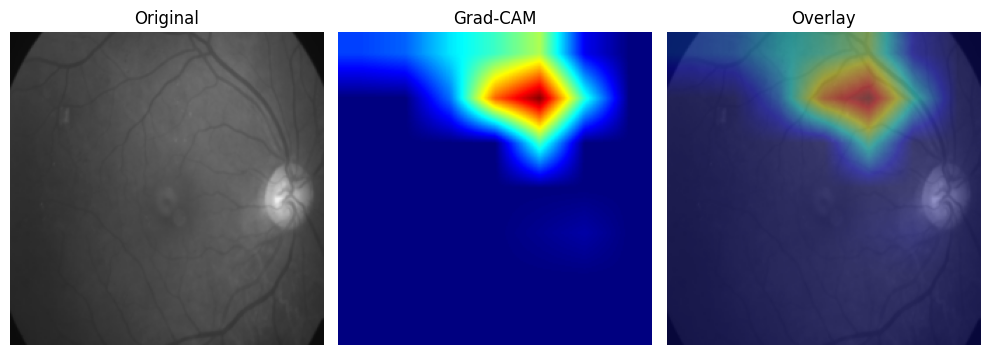

🔎 Image 116 - Predicted class: 2


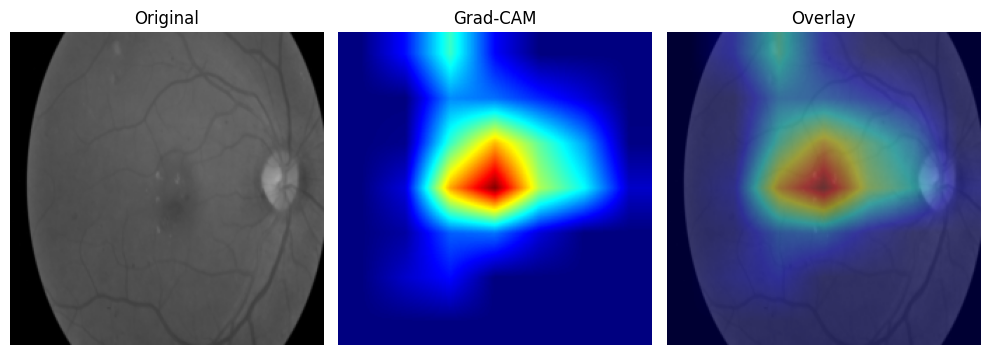

🔎 Image 117 - Predicted class: 2


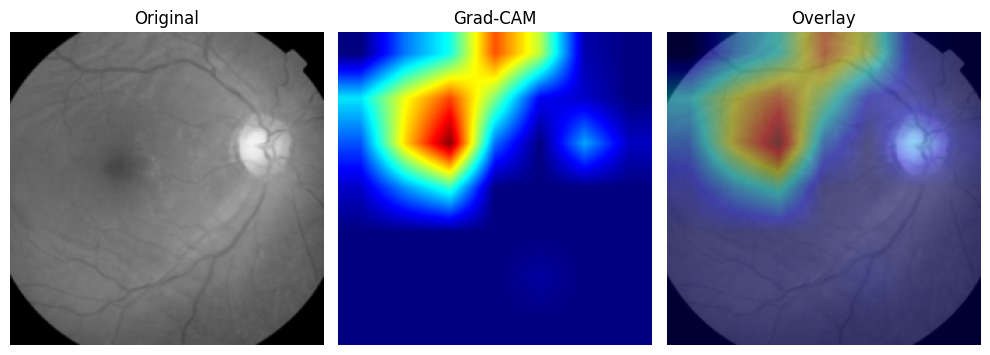

🔎 Image 118 - Predicted class: 1


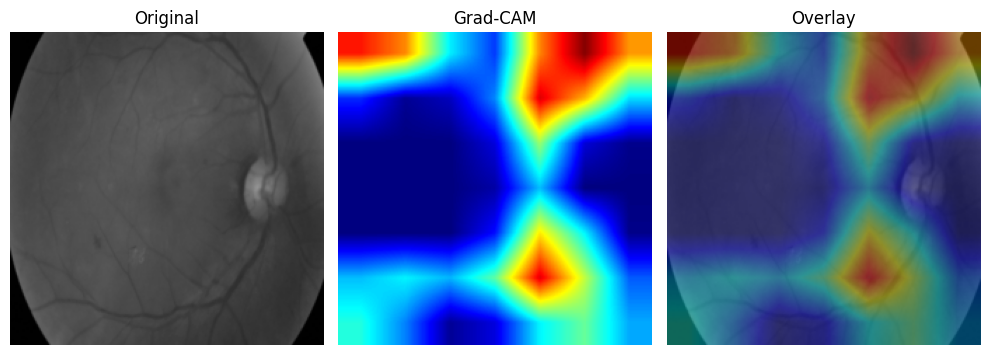

🔎 Image 119 - Predicted class: 2


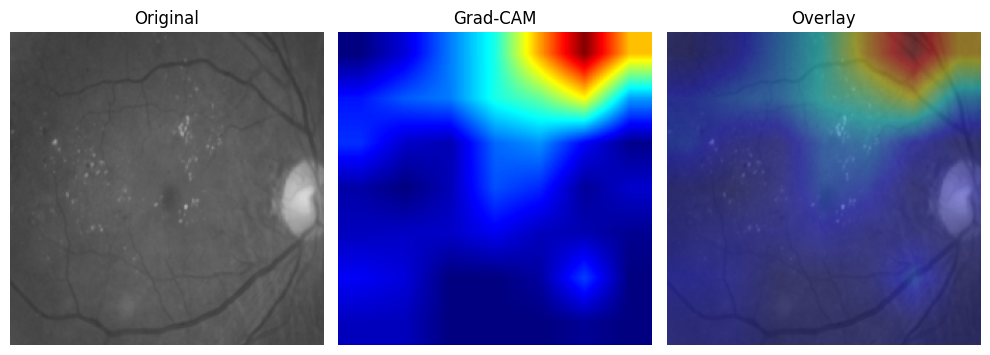

🔎 Image 120 - Predicted class: 4


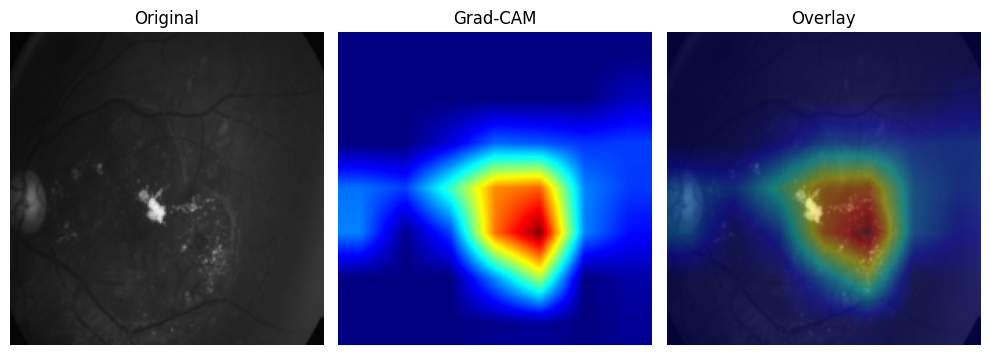

🔎 Image 121 - Predicted class: 0


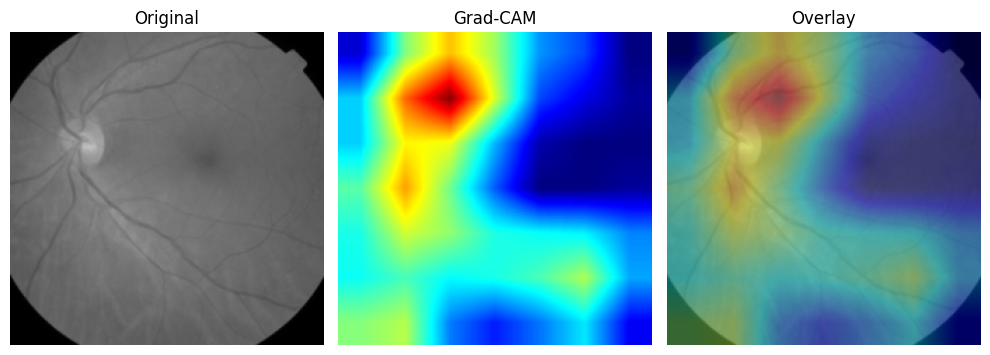

🔎 Image 122 - Predicted class: 2


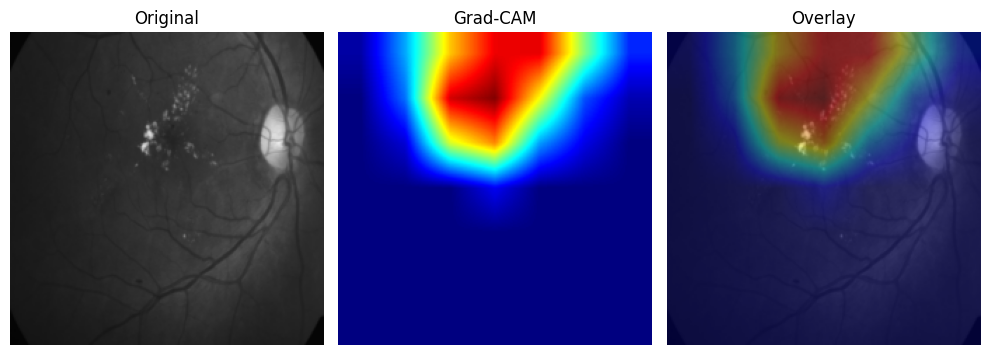

🔎 Image 123 - Predicted class: 2


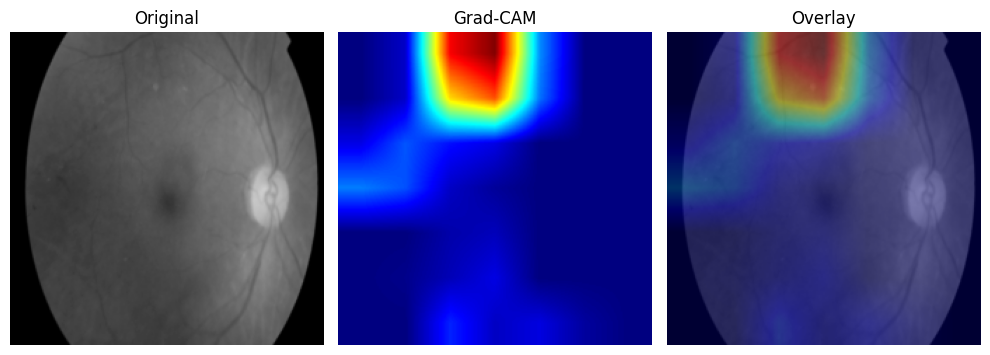

🔎 Image 124 - Predicted class: 2


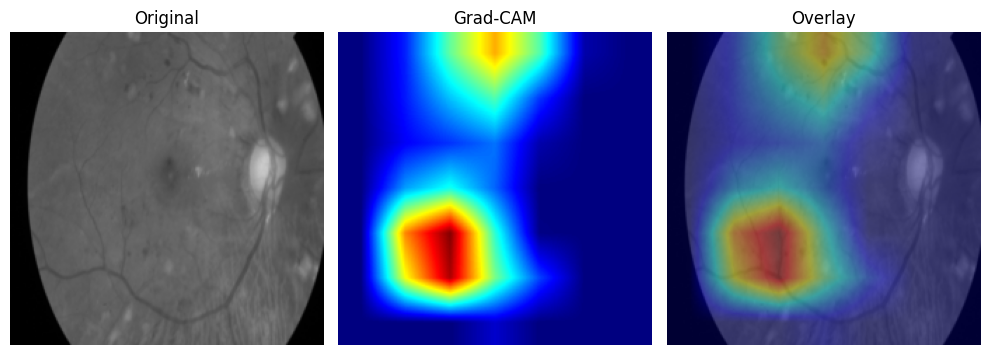

🔎 Image 125 - Predicted class: 2


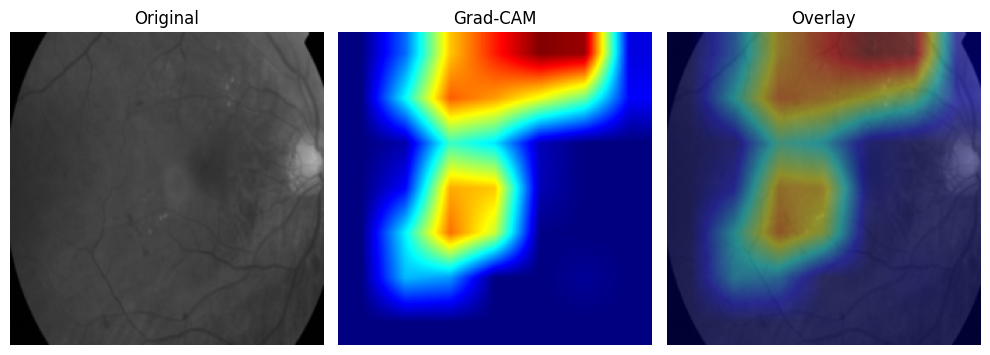

🔎 Image 126 - Predicted class: 2


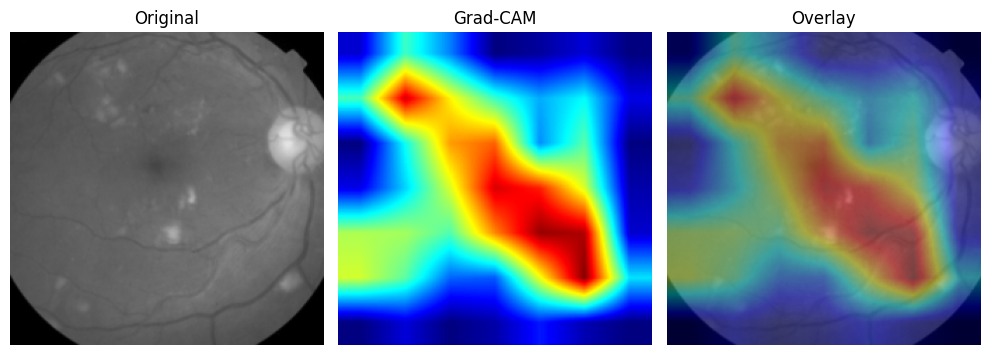

🔎 Image 127 - Predicted class: 2


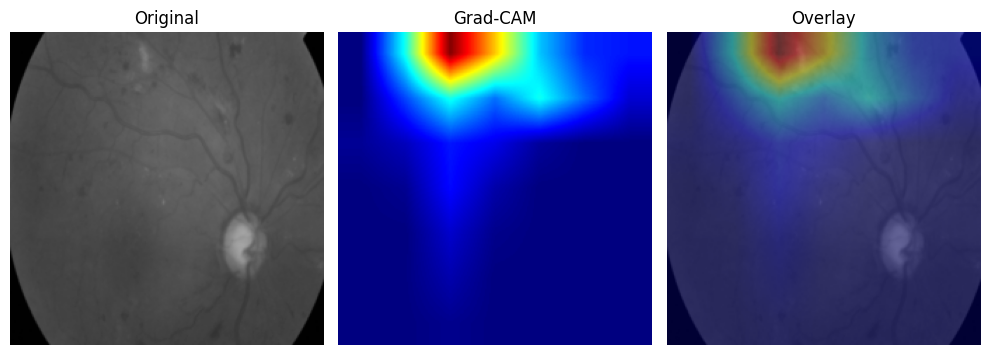

🔎 Image 128 - Predicted class: 2


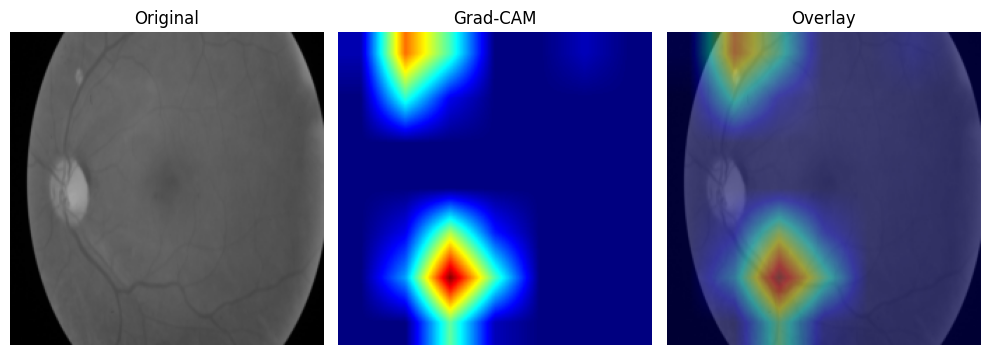

🔎 Image 129 - Predicted class: 4


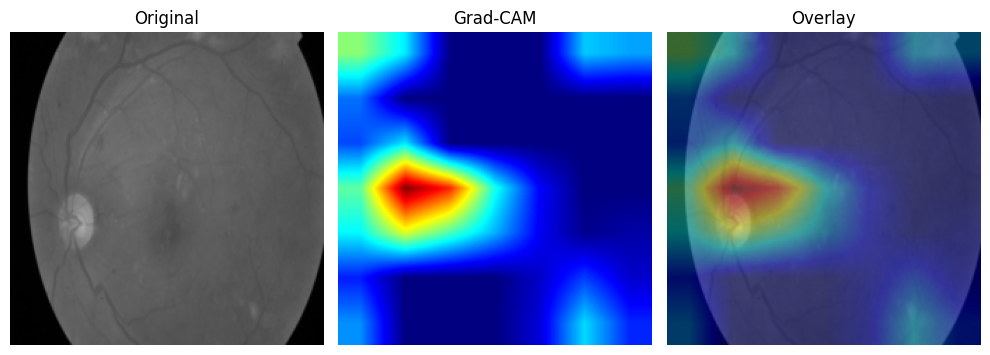

🔎 Image 130 - Predicted class: 4


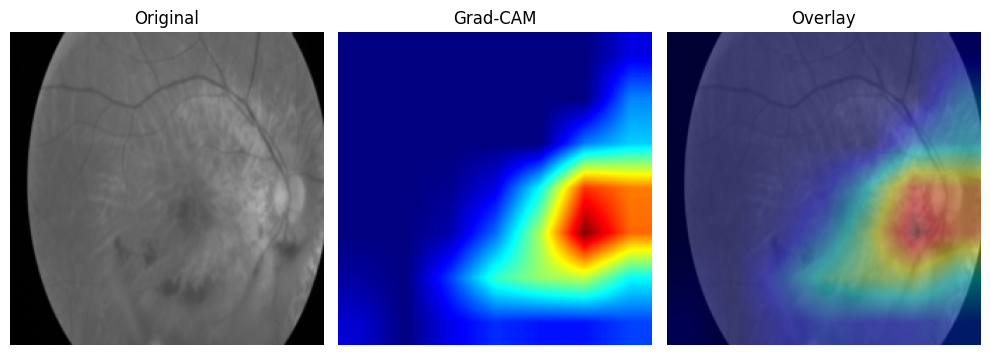

🔎 Image 131 - Predicted class: 1


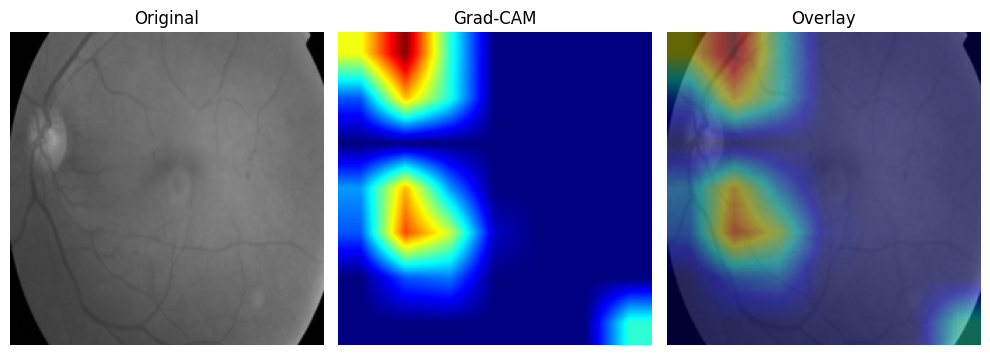

🔎 Image 132 - Predicted class: 0


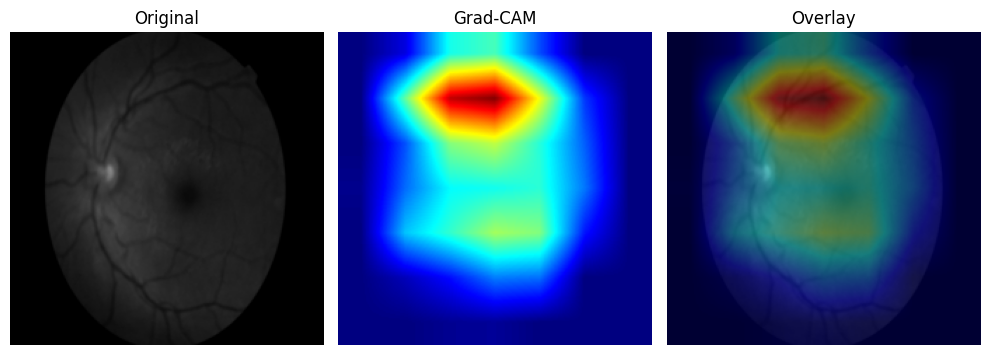

🔎 Image 133 - Predicted class: 2


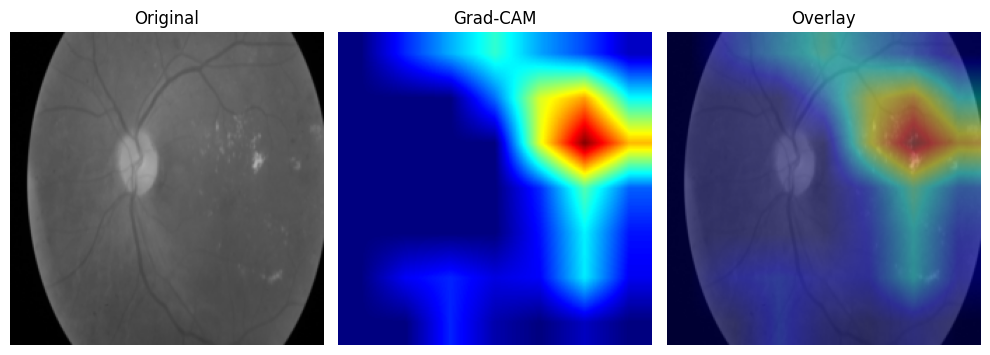

🔎 Image 134 - Predicted class: 1


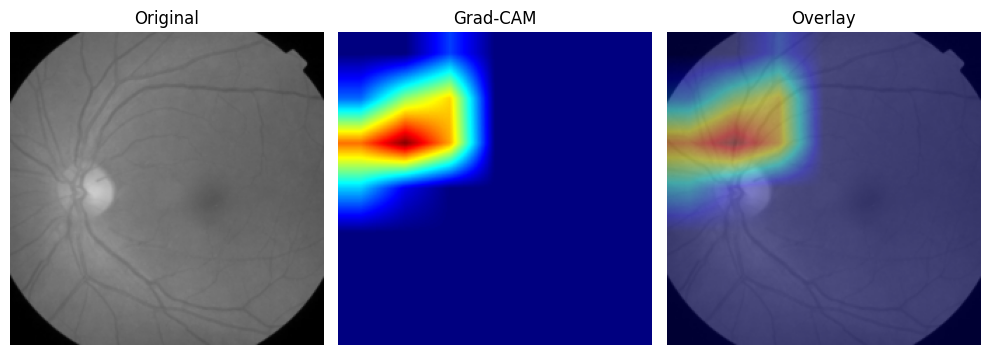

🔎 Image 135 - Predicted class: 2


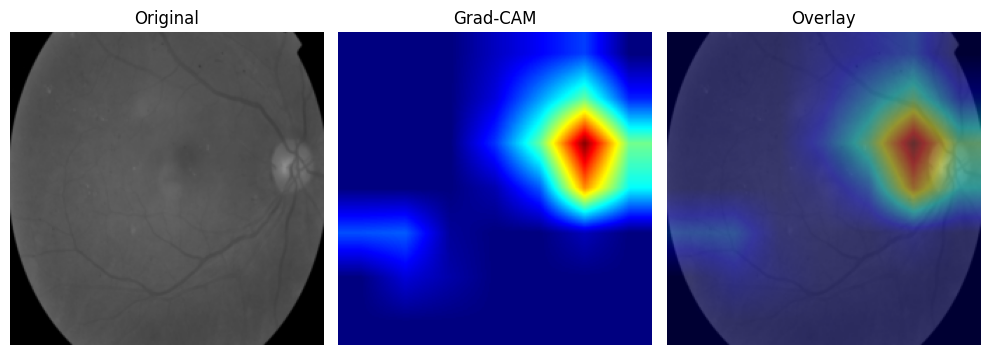

🔎 Image 136 - Predicted class: 4


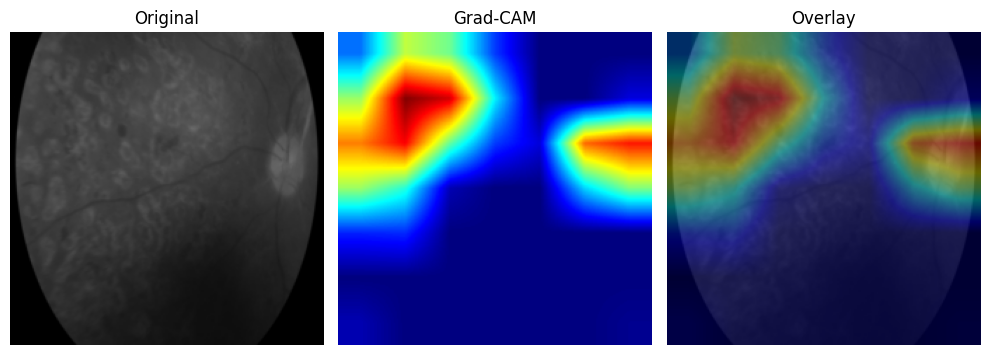

🔎 Image 137 - Predicted class: 1


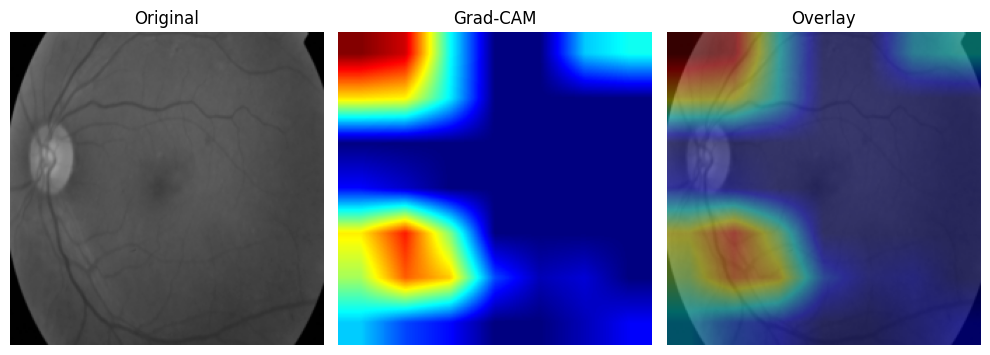

🔎 Image 138 - Predicted class: 4


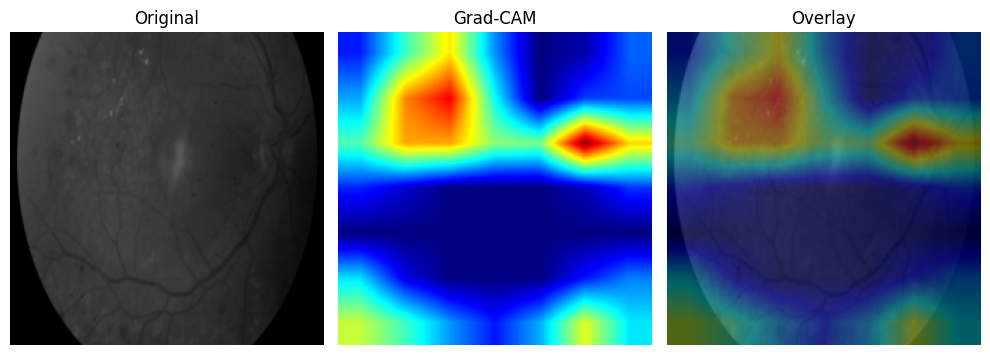

🔎 Image 139 - Predicted class: 2


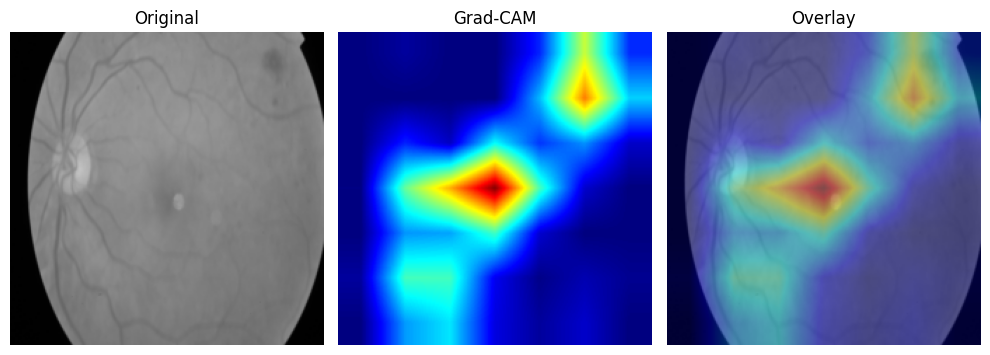

🔎 Image 140 - Predicted class: 2


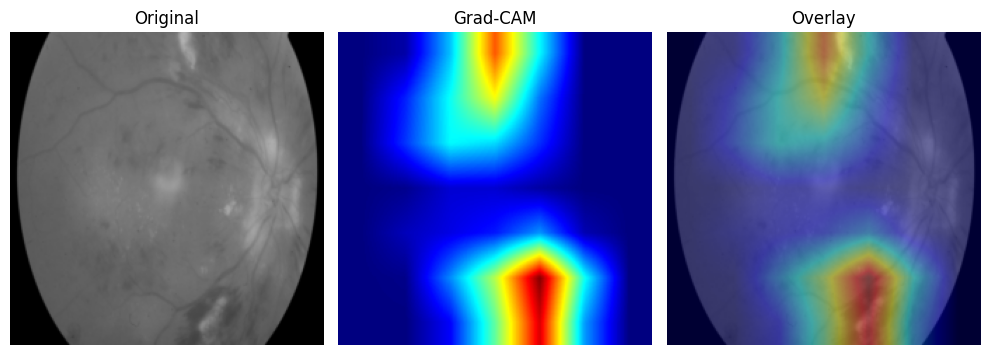

🔎 Image 141 - Predicted class: 0


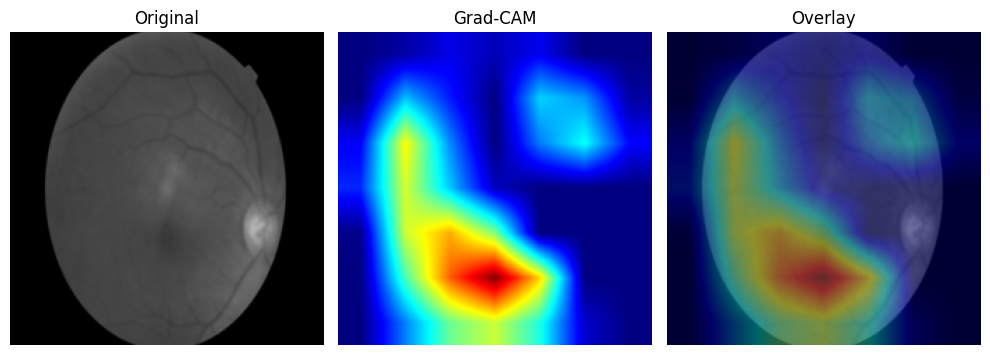

🔎 Image 142 - Predicted class: 0


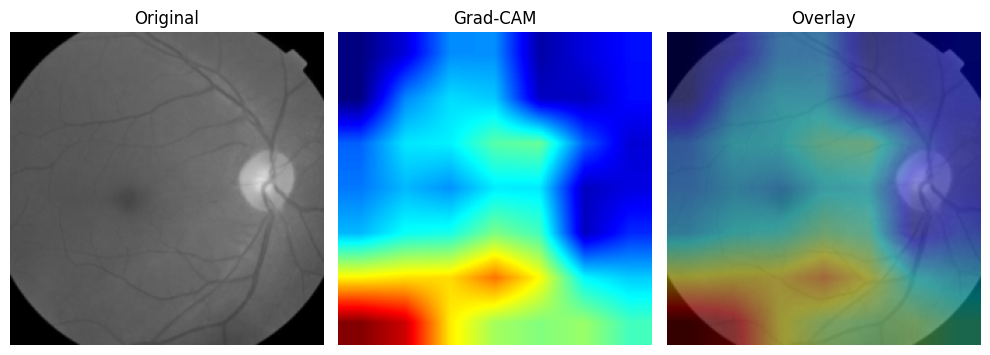

🔎 Image 143 - Predicted class: 4


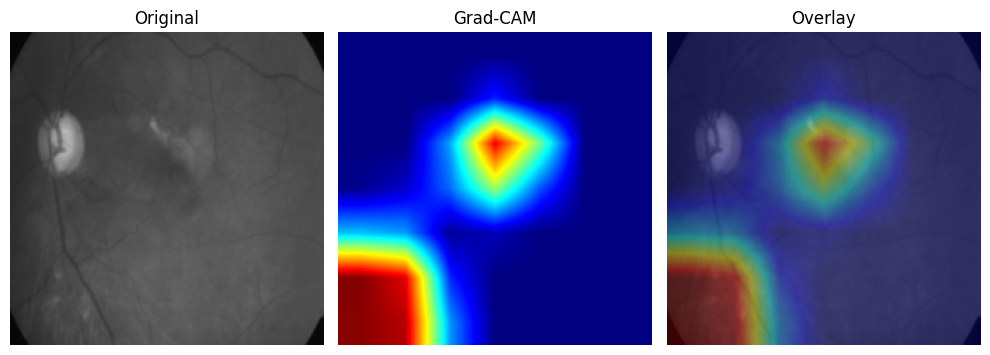

🔎 Image 144 - Predicted class: 2


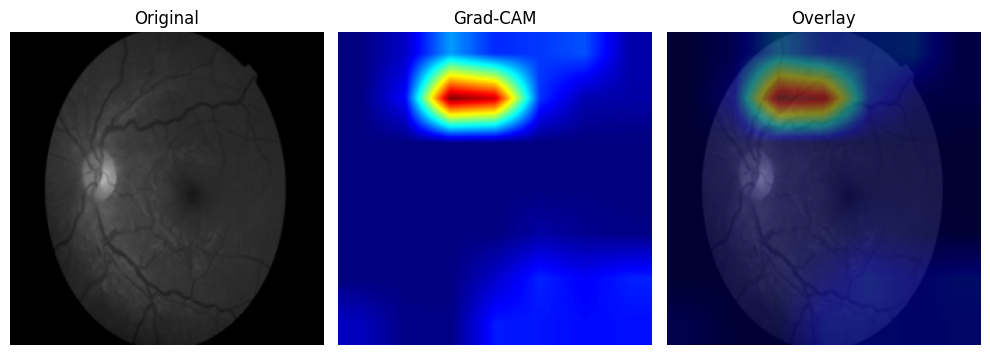

🔎 Image 145 - Predicted class: 2


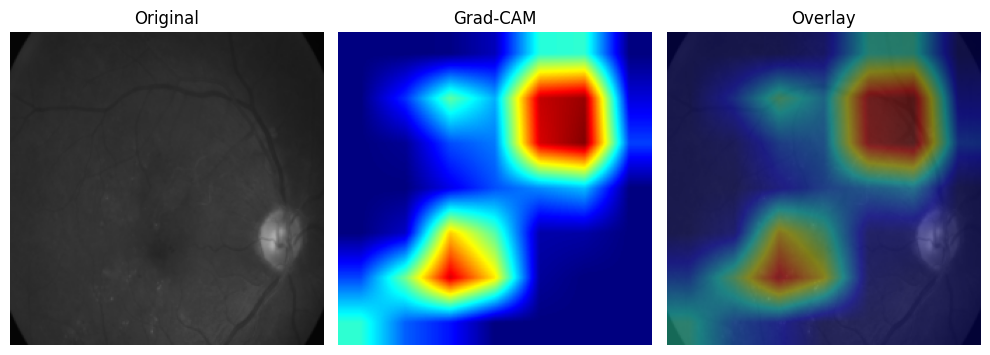

🔎 Image 146 - Predicted class: 4


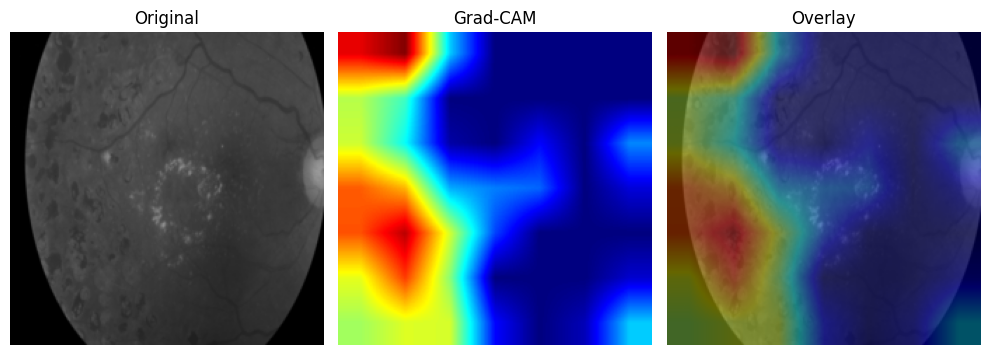

🔎 Image 147 - Predicted class: 0


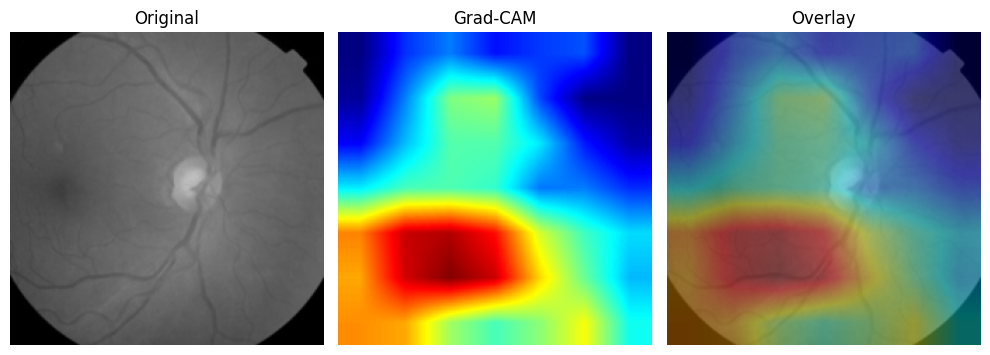

🔎 Image 148 - Predicted class: 4


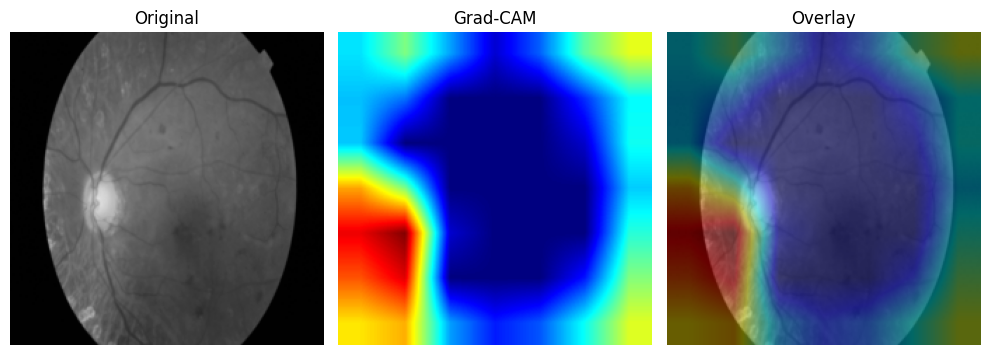

🔎 Image 149 - Predicted class: 1


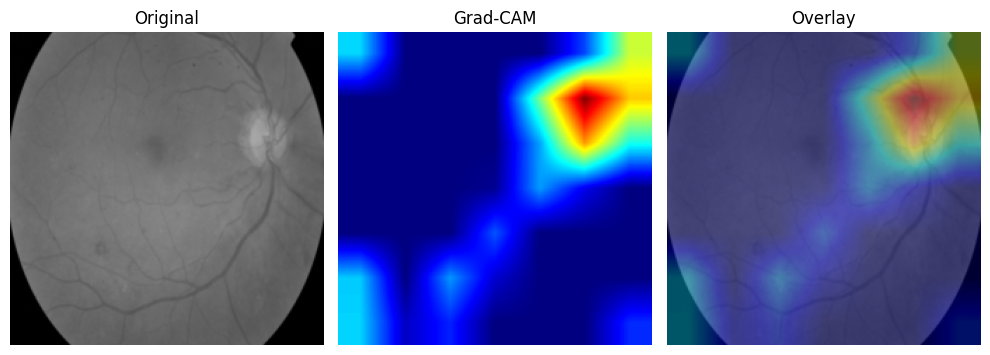

🔎 Image 150 - Predicted class: 4


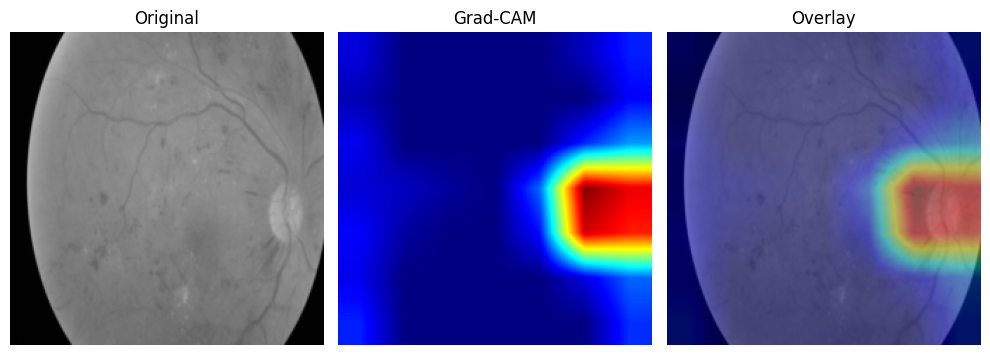

🔎 Image 151 - Predicted class: 2


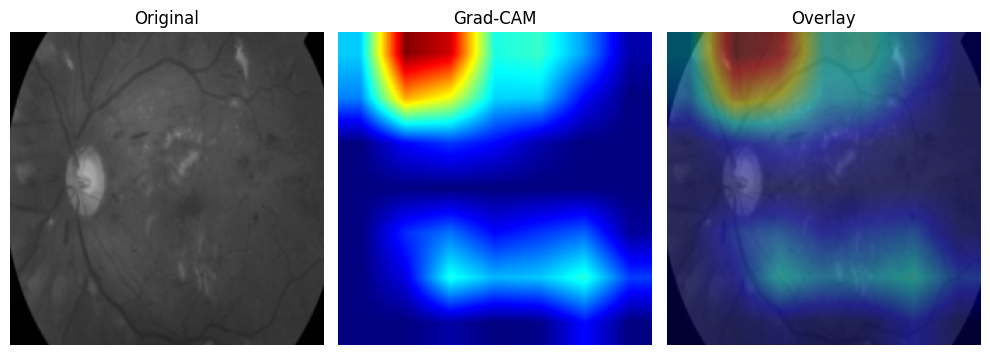

🔎 Image 152 - Predicted class: 2


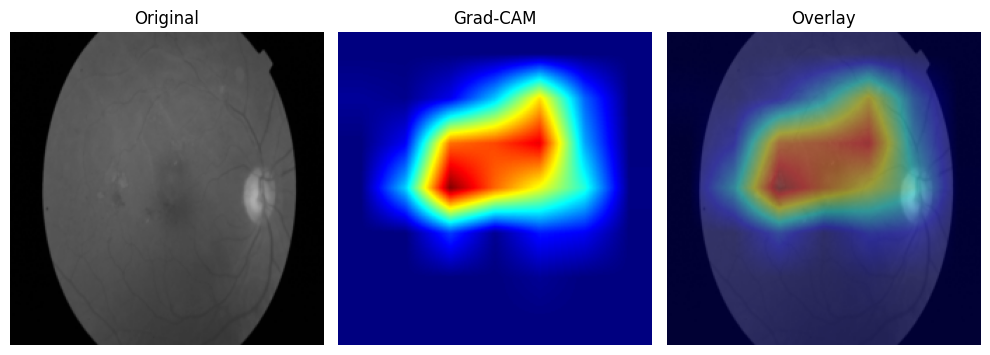

🔎 Image 153 - Predicted class: 0


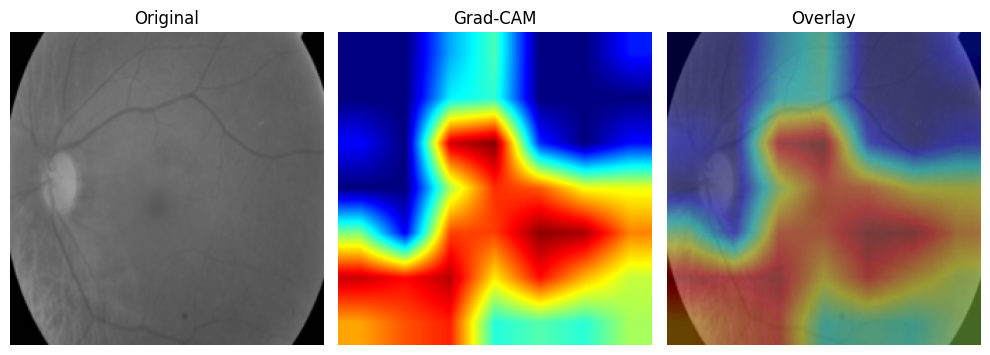

🔎 Image 154 - Predicted class: 2


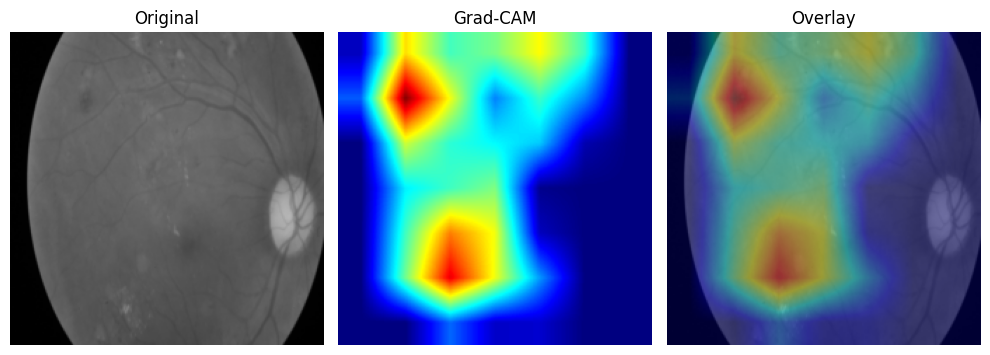

🔎 Image 155 - Predicted class: 2


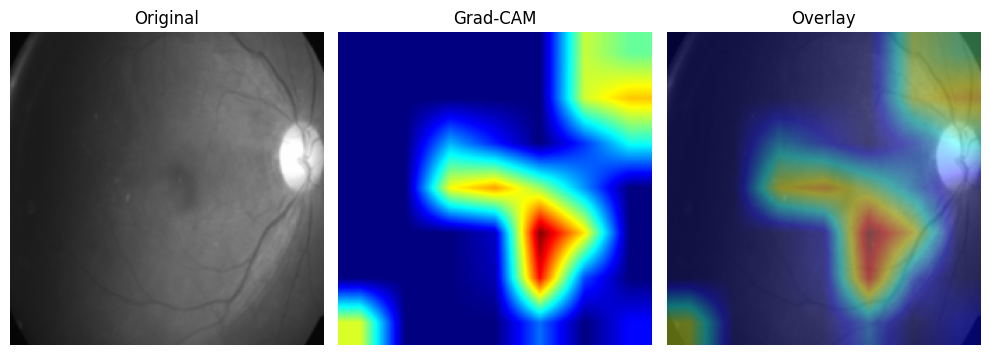

🔎 Image 156 - Predicted class: 4


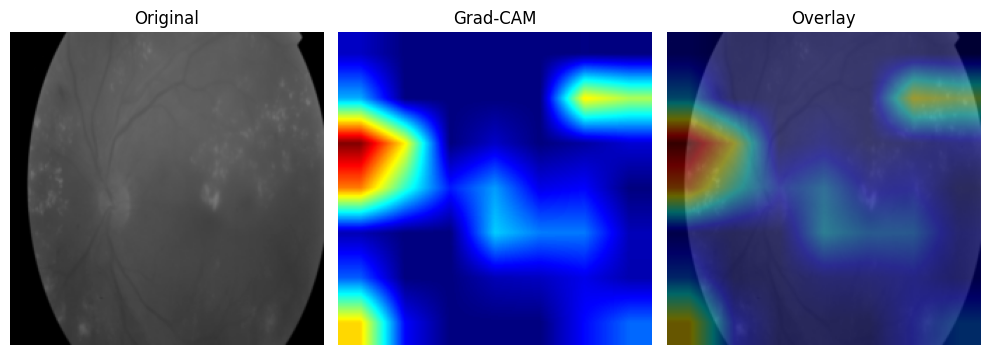

🔎 Image 157 - Predicted class: 0


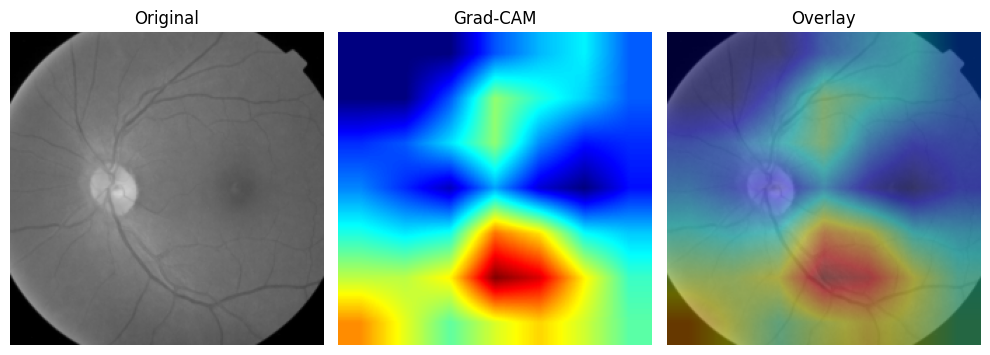

🔎 Image 158 - Predicted class: 2


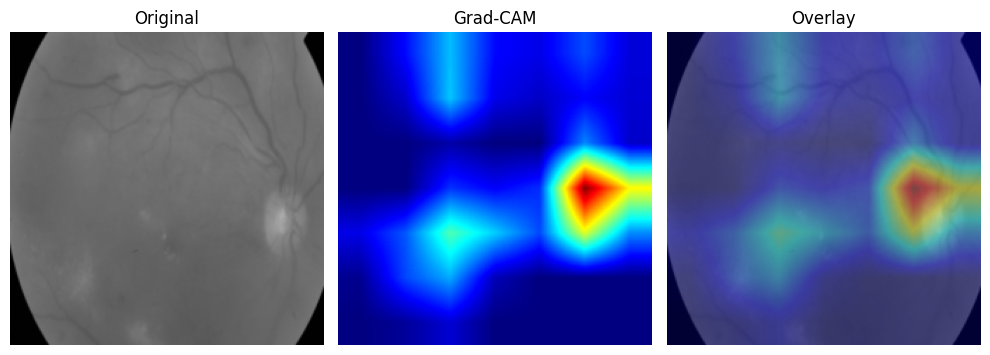

🔎 Image 159 - Predicted class: 0


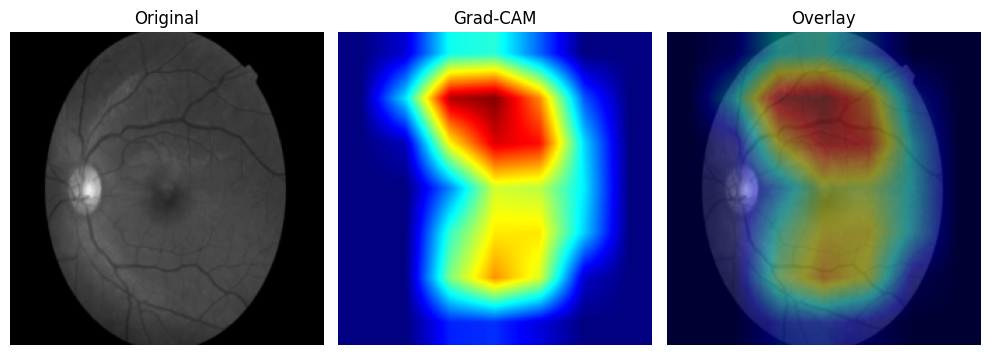

🔎 Image 160 - Predicted class: 2


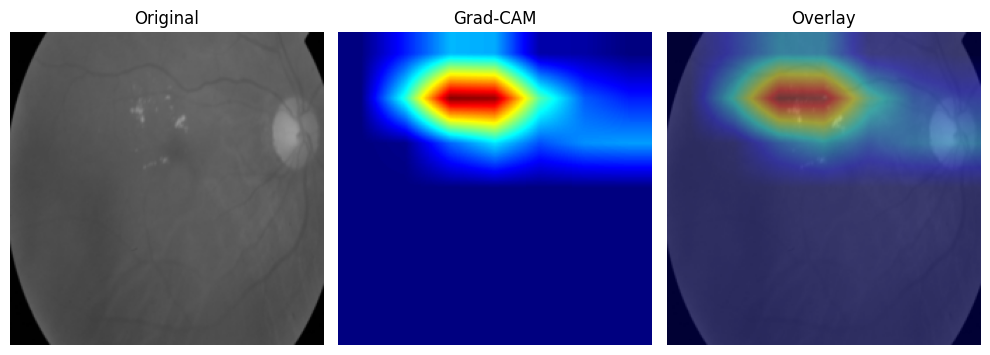

🔎 Image 161 - Predicted class: 4


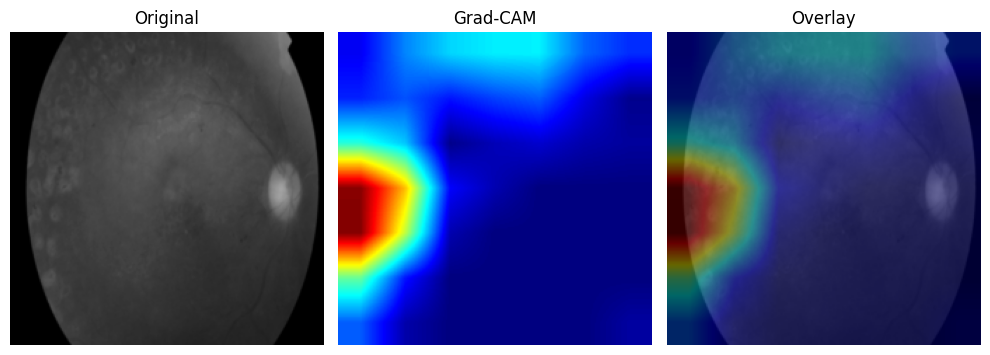

🔎 Image 162 - Predicted class: 2


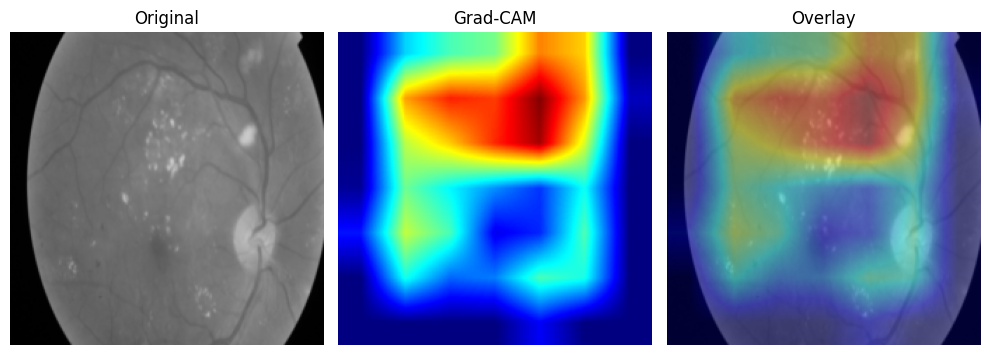

🔎 Image 163 - Predicted class: 2


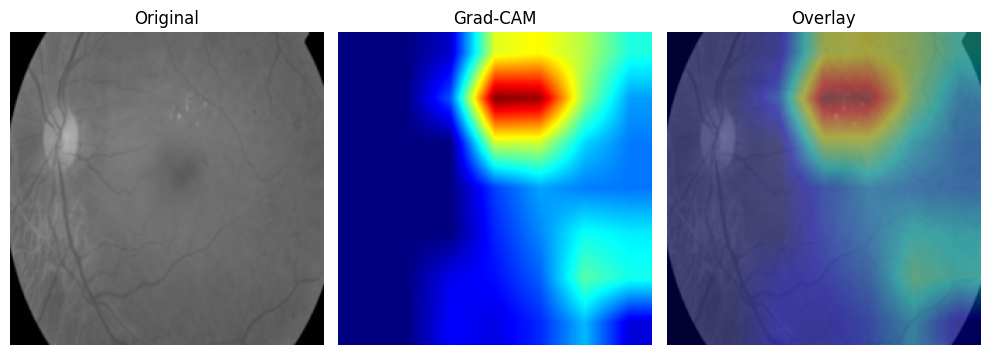

🔎 Image 164 - Predicted class: 2


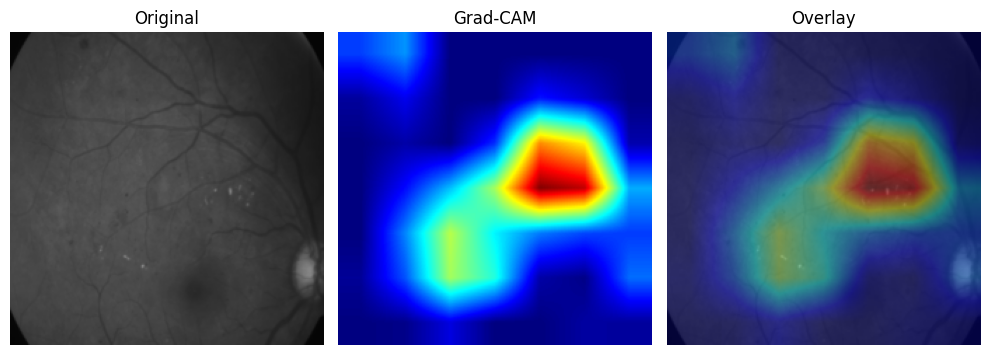

🔎 Image 165 - Predicted class: 1


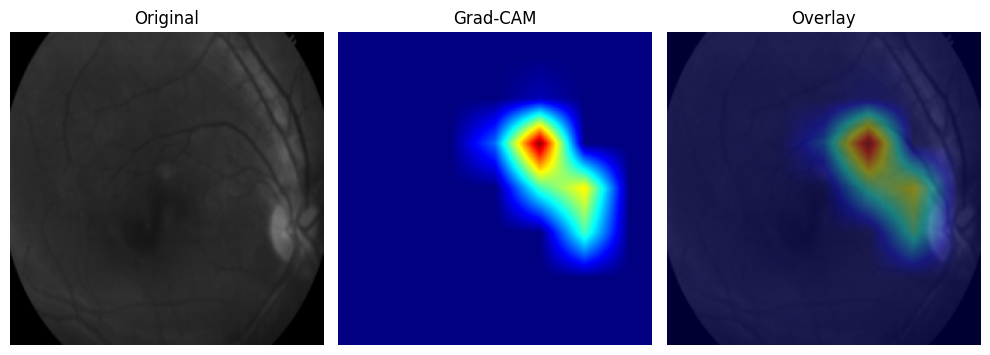

🔎 Image 166 - Predicted class: 3


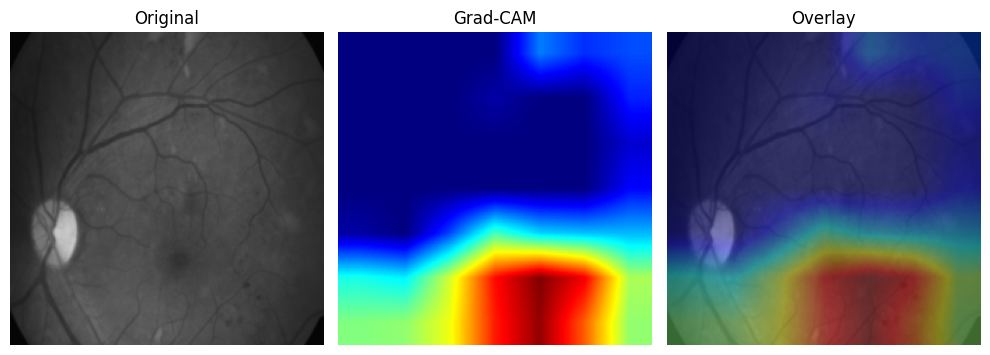

🔎 Image 167 - Predicted class: 4


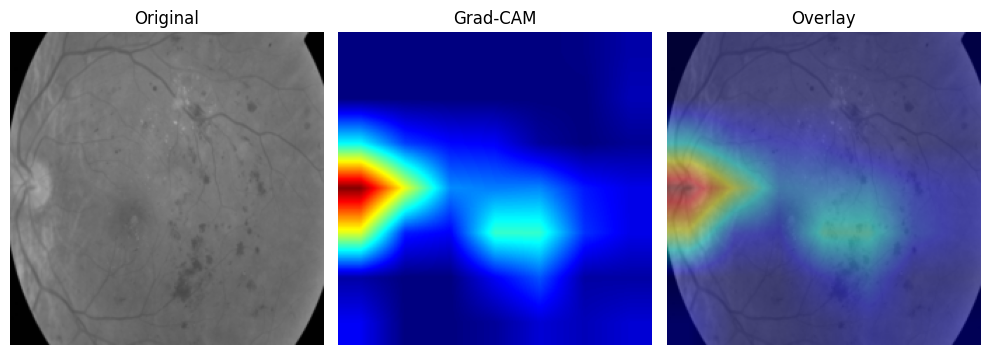

🔎 Image 168 - Predicted class: 2


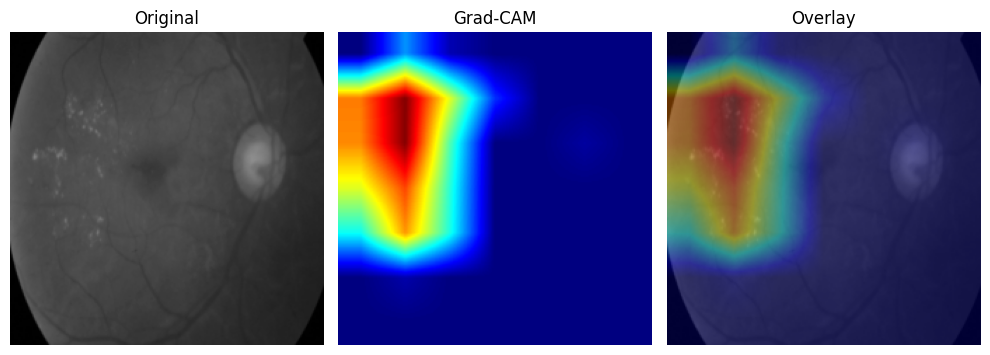

🔎 Image 169 - Predicted class: 1


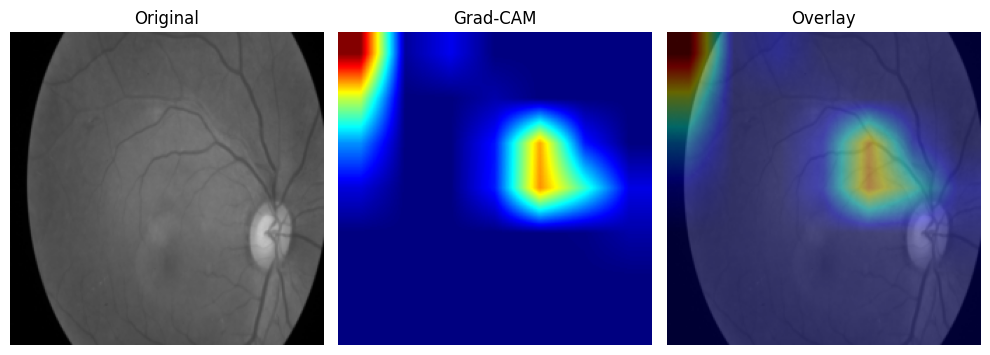

🔎 Image 170 - Predicted class: 2


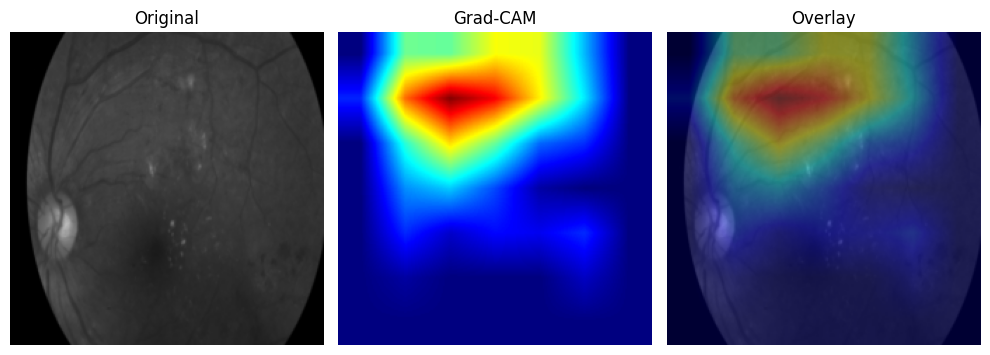

🔎 Image 171 - Predicted class: 2


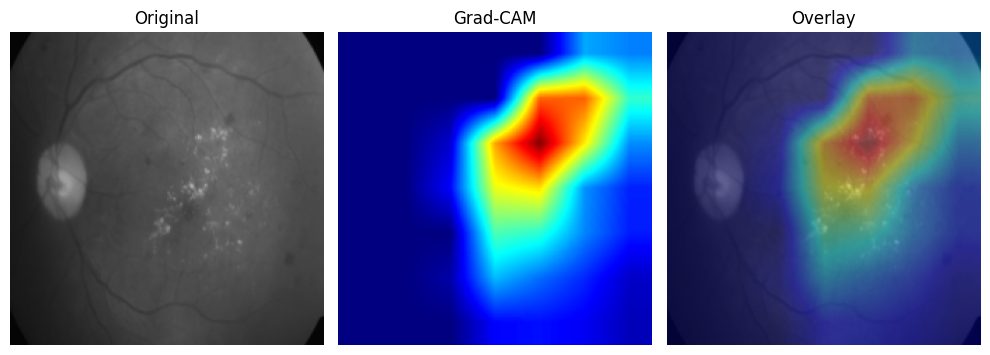

🔎 Image 172 - Predicted class: 1


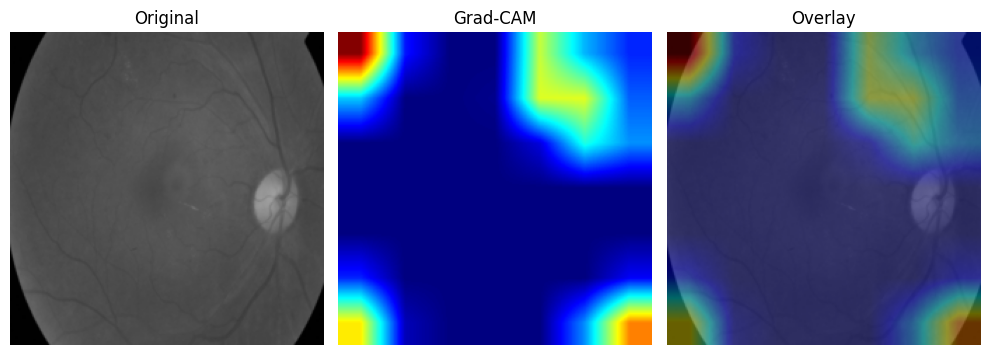

🔎 Image 173 - Predicted class: 1


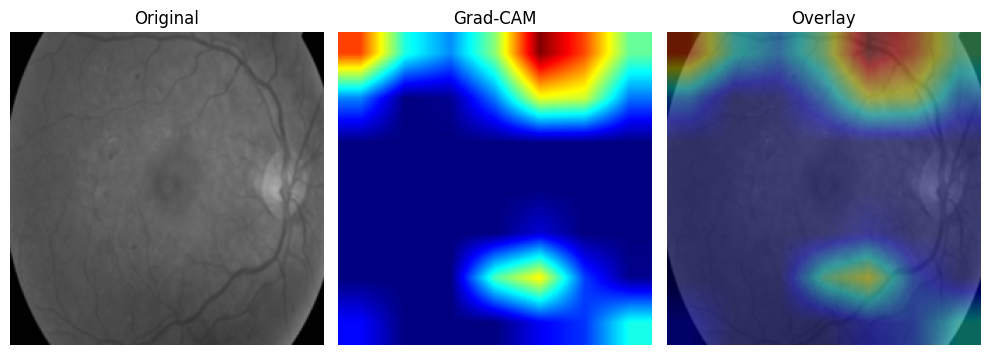

🔎 Image 174 - Predicted class: 2


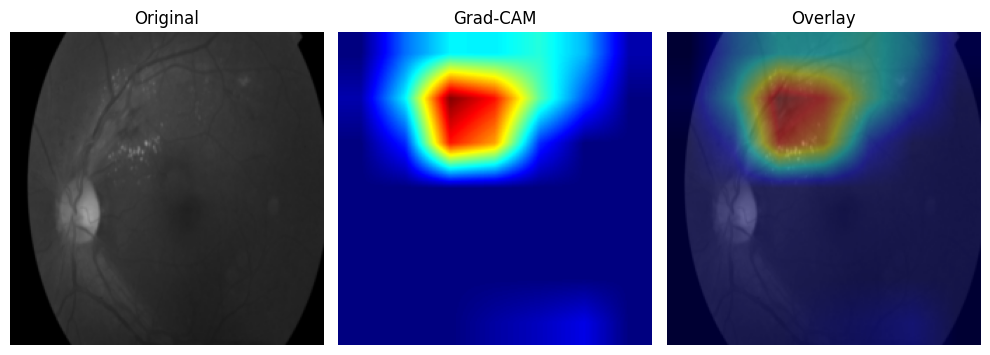

🔎 Image 175 - Predicted class: 2


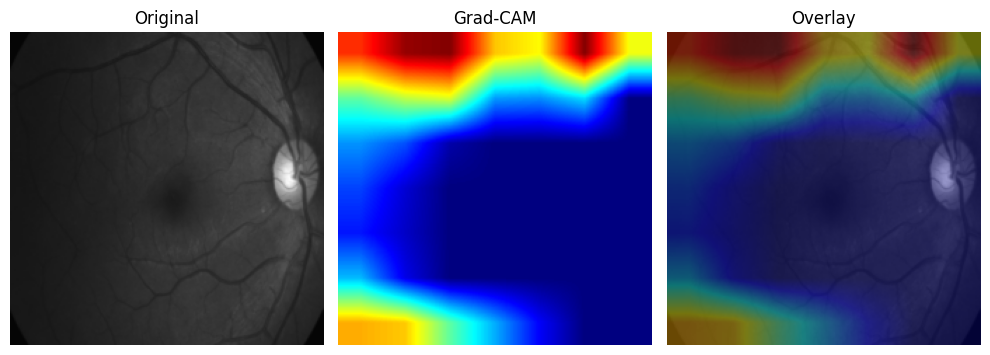

In [ ]:
import torch
import torch.nn.functional as F
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np
import cv2
from efficientnet_pytorch import EfficientNet
from PIL import Image
import os


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")



# Load the trained model state dictionary
model.load_state_dict(torch.load("/content/best_model (4) (1).pth", map_location=device))
model.to(device)
model.eval()

# Grad-CAM class
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None
        target_layer.register_forward_hook(self.save_activation)
        target_layer.register_backward_hook(self.save_gradient)

    def save_activation(self, module, input, output):
        self.activations = output

    def save_gradient(self, module, grad_input, grad_output):
        self.gradients = grad_output[0]

    def __call__(self, input_tensor, class_idx=None):
        output = self.model(input_tensor)
        if class_idx is None:
            class_idx = torch.argmax(output)

        self.model.zero_grad()
        loss = output[0, class_idx]
        loss.backward()

        gradients = self.gradients[0].cpu().data.numpy()
        activations = self.activations[0].cpu().data.numpy()

        weights = np.mean(gradients, axis=(1, 2))
        cam = np.zeros(activations.shape[1:], dtype=np.float32)

        for i, w in enumerate(weights):
            cam += w * activations[i]

        cam = np.maximum(cam, 0)
        cam = cam - np.min(cam)
        cam = cam / (np.max(cam) + 1e-8)
        return cam


transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5])
])

# Define the target layer for Grad-CAM
target_layer = model._blocks[-1]._project_conv

# Create a GradCAM instance
grad_cam_instance = GradCAM(model, target_layer)


for idx in range(len(test_df)):
    image_id = test_df.iloc[idx]['id_code']

    for ext in ['.png', '.jpg', '.jpeg']:
        path = os.path.join('combined_images', image_id + ext)
        if os.path.exists(path):
            image_path = path
            break
    else: # If loop completes without finding file
        print(f"Image not found for ID: {image_id}")
        continue


    original_image = Image.open(image_path).convert("L")
    input_tensor = transform(original_image).unsqueeze(0).to(device)

    # Inference
    with torch.no_grad():
        output = model(input_tensor)
        pred_class = output.argmax(dim=1).item()
        print(f"🔎 Image {idx} - Predicted class: {pred_class}")

    # Grad-CAM
    cam = grad_cam_instance(input_tensor, class_idx=pred_class)

    # معالجة Grad-CAM والصورة زي ما كنتي عاملة
    cam = cv2.resize(cam, (224, 224))
    cam = (cam * 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(cam, cv2.COLORMAP_JET)

    image_np = input_tensor.squeeze().cpu().numpy()
    image_np = (image_np * 0.5 + 0.5) * 255
    image_np = image_np.astype(np.uint8)
    image_np = cv2.cvtColor(image_np, cv2.COLOR_GRAY2BGR)

    overlay = cv2.addWeighted(image_np, 0.6, heatmap, 0.4, 0)

    # عرض
    plt.figure(figsize=(10, 4))
    plt.subplot(1, 3, 1)
    plt.title("Original")
    # Convert BGR to RGB for matplotlib display
    plt.imshow(image_np[..., ::-1])
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.title("Grad-CAM")
    # Convert BGR to RGB for matplotlib display
    plt.imshow(heatmap[..., ::-1])
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.title("Overlay")
    # Convert BGR to RGB for matplotlib display
    plt.imshow(overlay[..., ::-1])
    plt.axis('off')

    plt.tight_layout()
    plt.show()

In [ ]:
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.image import show_cam_on_image
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import preprocess_image


/tmp/ipython-input-167-4238758333.py:112: UserWarning: Glyph 129504 (\N{BRAIN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-167-4238758333.py:112: UserWarning: Glyph 128302 (\N{CRYSTAL BALL}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


<Figure size 1500x500 with 0 Axes>

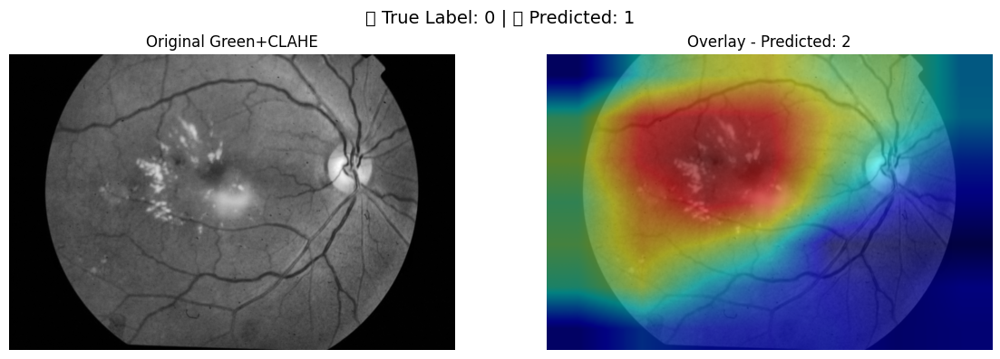

In [ ]:
import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms
from efficientnet_pytorch import EfficientNet
import torch.nn.functional as F
import os


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")



model.load_state_dict(torch.load('/content/best_model (4) (1).pth', map_location=device))
model.eval().to(device)

target_layer = model._blocks[-1]._depthwise_conv


# GradCAM Class
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None
        self.hook()

    def hook(self):
        def forward_hook(module, input, output):
            self.activations = output.detach()
        def backward_hook(module, grad_input, grad_output):
            self.gradients = grad_output[0].detach()
        self.target_layer.register_forward_hook(forward_hook)
        self.target_layer.register_backward_hook(backward_hook)

    def generate(self, input_tensor, class_idx=None):
        output = self.model(input_tensor)
        if class_idx is None:
            class_idx = output.argmax(dim=1).item()

        self.model.zero_grad()
        loss = output[0, class_idx]
        loss.backward()

        weights = self.gradients.mean(dim=(2, 3), keepdim=True)
        cam = (weights * self.activations).sum(dim=1, keepdim=True)
        cam = F.relu(cam)
        cam = F.interpolate(cam, size=input_tensor.shape[2:], mode='bilinear', align_corners=False)
        cam = cam.squeeze().cpu().numpy()
        cam = (cam - cam.min()) / (cam.max() - cam.min())
        return cam, class_idx


def load_image(image_path):
    img = cv2.imread(image_path)
    green = img[:, :, 1]
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    green_clahe = clahe.apply(green)
    blurred = cv2.GaussianBlur(green_clahe, (5, 5), 0)
    img_pil = Image.fromarray(blurred)
    transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.5], [0.5])
    ])
    img_tensor = transform(img_pil).unsqueeze(0).to(device)
    return img_tensor, blurred



image_id = test_df.iloc[30]['id_code']
for ext in ['.png', '.jpg', '.jpeg']:
    path = os.path.join('combined_images', image_id + ext)
    if os.path.exists(path):
        image_path = path
        break


input_tensor, original_image = load_image(image_path)


gradcam = GradCAM(model, target_layer)
cam, predicted_class = gradcam.generate(input_tensor)


heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
heatmap = cv2.resize(heatmap, (original_image.shape[1], original_image.shape[0]))
overlay = cv2.addWeighted(cv2.cvtColor(original_image, cv2.COLOR_GRAY2BGR), 0.5, heatmap, 0.5, 0)

plt.figure(figsize=(15, 5))

plt.figure(figsize=(12, 4))
plt.suptitle(f"🧠 True Label: {true_label} | 🔮 Predicted: {pred_class}", fontsize=14)

plt.subplot(1, 2, 1)
plt.title('Original Green+CLAHE')
plt.imshow(original_image, cmap='gray')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title(f'Overlay - Predicted: {predicted_class}')
plt.imshow(overlay[..., ::-1])  # BGR to RGB
plt.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
pip install grad-cam


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 78.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for grad-cam: filename=grad_cam-1.5.5-py3-none-any.whl size=44284 sha256=797a3fefffe0f11cd0cf843ba7e47a9d5e1348d6ff56ea64baddf869246a1b34
  Stored in directory: /root/.cache/pip/wheels/bc/52/78/893c3b94279ef238f43a9e89608af648de401b96415bebbd1f
Successfully built grad-cam
